In [1]:
import os
import io
import sys
import re
import statistics
import traceback

from typing import Literal

import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import pickle
import json
import torch
import torch.nn as nn
from torch.nn import CrossEntropyLoss, BCELoss
import torch.nn.functional as F 
from torch import optim
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler
from torchmetrics.classification import BinaryF1Score, BinaryPrecision, BinaryRecall, BinaryAccuracy, MulticlassF1Score
from sklearn.metrics import f1_score
from pprint import pprint

from sklearn.metrics import precision_recall_fscore_support
from sklearn.model_selection import KFold
# from sklearn import metrics
%matplotlib inline

import seaborn as sns
import matplotlib.pyplot as plt

from typing import Literal



/home/neuendo4/anaconda3/envs/master/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
sys.path.append(os.path.dirname('../src/'))
from utils.train_utils import *
from utils.models import MultiTaskBERT
from utils.datasets import *

In [3]:
from joan_utils.clusters_utils import *
from joan_utils.train_utils import *
from joan_utils.dataset import *

In [4]:
path_to_models_runs = '../results/'
path_to_ge_ghc_data = f'../data/matching_sizes_data/'
path_to_sc_data = '../data/sc_filtered_from_bela/'

In [5]:
emotions = ['anger','disgust','fear','joy','sadness','surprise']

# helper functions

In [6]:
def get_annos(df):
    annos = [y for y in df.columns if re.fullmatch(r'[0-9]*',y)]
    return(annos)

In [7]:

#these functions are only used internally

def __load_results_dict(path):
    with open(path + '/model_results.json', 'r') as file:
         return json.load(file)
     
def __load_preds_and_labels(path):
    with open(path+ '/model_preds_and_labels.pkl', 'rb') as file:
         return pickle.load(file)

# these are to use 

def return_results_df(path_to_file_or_dir, path_to_subdir=None):#path_to_runs, model_run):
    if path_to_subdir:
        # if 'sc' in path_to_subdir.lower:
        path_to_res = path_to_file_or_dir + path_to_subdir+ '/model_results.json'
        path_to_hyps = path_to_file_or_dir + path_to_subdir+ '/hyper_parameters.json'
    else: 
        path_to_res = path_to_file_or_dir
        path_to_hyps = path_to_file_or_dir.removesuffix('model_results.json') +  'hyper_parameters.json'
    
    with open(path_to_res, 'r') as file:
         res_df =  pd.DataFrame(json.load(file)).transpose()
    
    if os.path.exists(path_to_hyps):
        with open(path_to_hyps, 'r') as file:
            hyps_dict =  json.load(file)
    
    res_df.loc['sum',:] = res_df.sum()
    res_df.loc['epoch_mean',:] = res_df[res_df.index.str.lower().str.contains('epoch')].mean()
    res_df.loc['test_mean',:] = res_df[res_df.index.str.lower().str.contains('test')].mean()
    res_df.loc['test_results_std_dev',:] = np.std(res_df[res_df.index.str.lower().str.contains('test')], ddof=0)
    if os.path.exists(path_to_hyps) and 'num_comments_per_anno_train' in hyps_dict.keys():
        res_df.loc['hyperparameters','comments_per_annotator'] = hyps_dict['num_comments_per_anno_train']
    
    return res_df

def return_hyperparams(path_to_runs, model_run):
    with open(path_to_runs + model_run+'/hyper_parameters.json', 'r') as file:
        return json.load(file)
    
def print_hyperparams(path_to_runs, model_run, without_anno_ids=True):
    hp_dict = return_hyperparams(path_to_runs, model_run)
    if without_anno_ids:
        hp_dict['annotator_ids'] = 'REMOVED for better visualization'
    pprint(hp_dict)
    
def load_and_display_res_df_color(path_to_models_runs, run, filter_cols=None):
    df = return_results_df(path_to_models_runs, run)
    if filter_cols:
        df = df[[x for x in df.columns if any([s in x for s in filter_cols])]]
    subset = [col for col in list(df.columns) if re.search(r'(train|test|val)s?_(loss|f1)s?', col)]
    display(df.style.background_gradient(cmap ='YlGn', subset=subset).format(precision=3))
    
def results_of_folder(path_to_dir):
    runs = sorted(os.listdir(path_to_dir), key=lambda s: [float(x) for x in re.findall(r'\de-\d\d|\d\.\d+|\d+',s)], reverse=True)
    
    all_res = pd.DataFrame(columns=['run', 'test_f1_majority_macro', 'test_f1_majority_binary', 'test_f1_individual_binary', 'test_f1_individual_macro', 'test_acc']) #seconds_per_epoch

    for run in runs:
        try:
            hypers = return_hyperparams(path_to_dir, run) #time_millis
            #seconds = hypers['time_millis']/1000
            res_df = return_results_df(path_to_dir, run)
            test_f1 = res_df.loc['Test_results','test_f1s']
            test_f1_majority_macro = res_df.loc['Test_results','test_f1_majority_macro']
            test_f1_majority_binary = res_df.loc['Test_results','test_f1_majority_binary']
            test_f1_individual_binary = res_df.loc['Test_results','test_f1_individual_binary']
            test_f1_individual_macro = res_df.loc['Test_results','test_f1_individual_macro']
            test_acc = res_df.loc['Test_results','test_accs']
            num_epochs = len(res_df[res_df.index.str.lower().str.contains('epoch')])
            #run_time = seconds/num_epochs
            all_res.loc[len(all_res),:] = [run, test_f1_majority_macro, test_f1_majority_binary, test_f1_individual_binary, test_f1_individual_macro, test_acc] #,run_time
        except Exception as e:
            print(e)
    
    return all_res

def results_of_folder_ge(path_to_dir):
    runs = sorted(os.listdir(path_to_dir), key=lambda s: [float(x) for x in re.findall(r'\de-\d\d|\d\.\d+|\d+',s)], reverse=True)
    
    all_res = pd.DataFrame(columns=['run', 'test_f1', 'test_acc', 'seconds_per_epoch'])

    for run in runs:
        try:
            hypers = return_hyperparams(path_to_dir, run) #time_millis
            seconds = hypers['time_millis']/1000
            res_df = return_results_df(path_to_dir, run)
            test_f1 = res_df.loc['Test_results','test_f1s']
            test_acc = res_df.loc['Test_results','test_accs']
            num_epochs = len(res_df[res_df.index.str.lower().str.contains('epoch')])
            run_time = seconds/num_epochs
            all_res.loc[len(all_res),:] = [run, test_f1, test_acc, run_time]
        except Exception as e:
            print(e)
    
    return all_res

def display_res_df_color(df):
    subset = [col for col in list(df.columns) if re.search(r'(test|val)s?_(loss|f1)s?', col)]
    display(df.style.background_gradient(cmap ='YlGn', subset=subset).format(precision=3))

In [8]:
#functions for loading individual annotators results

def load_preds_labels(path_to_models_runs, model_run):
    with open(path_to_models_runs + model_run+'/model_preds_and_labels.json', 'r') as f:
        return json.load(f)

def get_preds_and_labels(data_dict, fold=0, epoch=0):
    preds = data_dict[f"Fold{fold}_epoch{epoch}"]['all_test_preds']
    labels = data_dict[f"Fold{fold}_epoch{epoch}"]['all_test_labels']
    if preds.device.type=='cuda':
        preds = preds.to('cpu')
        labels = labels.to('cpu')
    return preds, labels

def get_best_epoch(majority_results, measure='test_f1'):
    return max(majority_results.index, key=majority_results.test_f1.__getitem__)

def get_scores_annotators(res_dict, epoch):
    num_annotators = res_dict[epoch]['all_test_preds'][0].shape[0]

    preds = torch.stack(res_dict[epoch]['all_test_preds']).to('cpu')
    labels = torch.stack(res_dict[epoch]['all_test_labels']).to('cpu')

    bin_f1_score = BinaryF1Score()
    bin_acc = BinaryAccuracy()

    df = pd.DataFrame(columns=['F1','ACC'])
    
    for i in range(num_annotators):
        p = preds[:,i]
        l = labels[:,i]
        mask = l.ge(0)
        acc = f1 = float('nan')
        if any(mask):
            mask_p = torch.masked_select(p,mask)
            mask_l = torch.masked_select(l,mask)
            acc = round(bin_acc(mask_p,mask_l).item(),3)
            f1 = round(bin_f1_score(mask_p,mask_l).item(),3)
        df.loc[i] = [f1,acc]
    
    l = labels.transpose(0,1).tolist()
    zeros = [a.count(0) for a in l]
    ones = [a.count(1) for a in l]

    df['0'] = zeros
    df['1'] = ones
    df['count'] = df['0'] + df['1']
    
    return df

In [9]:

# multi result dataframe
def get_multi_runs_res_df(path_to_runs, run_list, path_to_sc_data, path_to_ge_ghc_data, provided_dataset_model_name=None, lr_search=False, num_annos=None, dataset_name=None):
    multi_df = pd.DataFrame(columns=['dataset_name','ds_name','model', 'dataset_size', 'number_annotations', 'num_annos', 
                                     'f1_bin_maj', 'f1_macro_maj', 'f1_bin_indi', 'f1_macro_indi', 
                                     'test_acc_maj', 'test_acc_indi', 'mean_train_millis', 
                                     'mean_train_millis_per_annotation', 'mean_train_millis_per_sample', 
                                     'mean_eval_millis_per_annotation', 'mean_test_millis_per_annotation', 'sum_all_millis', 
                                     'annotations_per_anno', 'comment_percentage', 'learning_rate','fold'])
    num_annos_provided = bool(num_annos)
    #multi-tasking-sbert

    missing = []
    
    for run in run_list:
        # if 'multi-tasking-sbert': 
        if run[-1] in [0,1,2,3,4]:
            fold = run[-1]
        else:
            fold = 'no fold'
            
        if not num_annos_provided:
            num_annos = int(re.findall(r"\d+_annos",run)[0].split('_')[0])
        
        percentag_matches = re.findall(r"\d+_percentage",run)
        with_percentage = bool(percentag_matches)
        
        if with_percentage:
            comment_percentage = int(percentag_matches[0].split('_')[0])
            
        if lr_search:
            if '.' in run:
                lr = float(re.findall(r"\d.\d+",run)[0])
            else:
                lr = float(re.findall(r"\de-\d+",run)[0])
         
        emotion_str = ''      
        if "'" in run:
            emotion = run.split("'")[1].split('-')[0]
            emotion_str = f"'{emotion}"
                
        try:
            # if provided_dataset_model_name: 
            if 'GE' in run:
                dataset_name = 'GE'
            elif 'ghc' in run.lower():
                dataset_name = 'GHC' 
            elif 'sc' in run.lower():
                dataset_name = 'sc' 
            elif 'md' in run.lower():
                dataset_name = 'MD' 
        #     dataset_model_name = provided_dataset_model_name
        # else:
        #     dataset_name = run.split('-')[0]
            dataset_model_name = run.split('_')[0]
            model_name = '-'.join(dataset_model_name.split('-')[1:])
            
            if dataset_name.lower() == 'sc': 
                path_to_dataset = f'{path_to_sc_data}sc_{num_annos}_annos_filtered.csv'
                with open(path_to_dataset, 'r') as f:
                    dataframe = pd.read_csv(f)
                dataset_size = len(dataframe)
            else:
                if ('comment_scalability' in path_to_runs and not 'MD' in run) or 'full_' in path_to_runs:
                    path_to_dataset = f'{path_to_ge_ghc_data}{dataset_name}{emotion_str}*full_{num_annos}_annos_filtered.csv'
                    with open(path_to_dataset, 'r') as f:
                        dataframe = pd.read_csv(f)
                    dataset_size = len(dataframe)
                else:
                    path_to_dataset = f'{path_to_ge_ghc_data}{dataset_name}{emotion_str}_{num_annos}_annos_filtered.csv'
                    with open(path_to_dataset, 'r') as f:
                        dataframe = pd.read_csv(f)
                    dataset_size = len(dataframe)
        
        # if provided_dataset_model_name:# any([x in provided_dataset_model_name.lower() for x in ['udi','ae','aa']]):
        #     res_df = return_results_df(path_to_runs + run)
        # else:
            res_df = return_results_df(path_to_runs, run)     
               #'../results/multi_scalability_0/SC-multi-tasking-sbert_6_annos/model_results.json' 
            # dataset_size = res_df.loc['test_mean','dataset_size']
            number_annotations = res_df.loc['test_mean','number_of_annotations']
                
            mean_train_millis_epoch = res_df.loc['epoch_mean','train_time_millis']
            mean_train_millis_per_annotation = mean_train_millis_epoch/number_annotations
            mean_train_millis_per_sample = mean_train_millis_epoch/dataset_size
            mean_eval_millis_per_annotation = res_df.loc['epoch_mean','eval_time_millis']/number_annotations
            mean_test_millis_per_annotation = res_df.loc['epoch_mean','test_time_millis']/number_annotations
            f1_bin_maj = res_df.loc['test_mean','test_f1_majority_binary']
            f1_macro_maj = res_df.loc['test_mean','test_f1_majority_macro']
            f1_bin_indi = res_df.loc['test_mean','test_f1_individual_binary']
            f1_macro_indi = res_df.loc['test_mean','test_f1_individual_macro']
            test_acc_maj = res_df.loc['test_mean','test_acc_majority']
            test_acc_indi = res_df.loc['test_mean','test_acc_individual']
            sum_all_millis = res_df.loc['sum','train_time_millis'] + res_df.loc['sum','eval_time_millis'] + res_df.loc['sum','test_time_millis']

            i = len(multi_df) 
                               #['dataset_name''dataset_size','number_annotations', 'num_annos', 'f1_bin_maj''f1_macro_maj''f1_bin_indi''f1_macro_indi''test_acc_maj''test_acc_indi', 'mean_train_millis',  'mean_train_millis_per_annotation','mean_train_millis_per_sample''mean_eval_millis_per_annotation''mean_test_millis_per_annotation''sum_all_millis','annotations_per_anno', 'lr]
            multi_df.loc[i,:] = [dataset_model_name,dataset_name,model_name,dataset_size, number_annotations, num_annos, f1_bin_maj, f1_macro_maj, f1_bin_indi, f1_macro_indi, test_acc_maj, test_acc_indi, mean_train_millis_epoch, mean_train_millis_per_annotation, mean_train_millis_per_sample, mean_eval_millis_per_annotation, mean_test_millis_per_annotation, sum_all_millis, None, None, None, fold]

            if with_percentage:
                multi_df.loc[i,'annotations_per_anno'] = res_df.loc['hyperparameters','comments_per_annotator']
                multi_df.loc[i,'comment_percentage'] = comment_percentage
                
            if lr_search:
                multi_df.loc[i,'learning_rate'] = lr
                
                    
        except Exception as e:
            missing.append(run)
            print(print(run))
            print('_'*100)
            print(str(e))
            print('_'*100)
            print(traceback.format_exc())
            
            
    return multi_df, missing

In [10]:
# plot multi result dataframe 

blues = sns.color_palette("Blues",16)
greens = sns.color_palette("Greens",16)
reds = sns.color_palette("Reds",16)
spectral = sns.color_palette("Spectral",16)
purples = sns.color_palette("Purples",10)
oranges = sns.color_palette("Oranges",10)

df_names_color_map = {
    'GHC-multi-tasking': greens[-1], 
    'GHC-multi-tasking-sbert' : greens[-5],
    'GHC-bertbase': greens[-1], 
    'GHC-sbertbase': greens[-8], 
    # 'GHC*full-multi-tasking': greens[-15], 
    'GHC-uid': greens[-8],
    'GE-multi-tasking': blues[-1], 
    'GE-multi-tasking-sbert' : blues[-5],
    'GE-bertbase': blues[-1], 
    'GE-uid': blues[-8], 
    'GE-sbertbase': blues[-8], 
    # 'GE*full-multi-tasking': blues[-13], 
    'SC-multi-tasking': reds[-1], 
    'SC-multi-tasking-sbert' : reds[-5],
    'SC-bertbase': reds[-1], 
    'SC-ae': reds[-11], 
    'SC-aa': reds[-14], 
    'SC-uid': reds[-8],
    'SC-sbertbase': reds[-8],
    'SC-multi-tasking': reds[-1],
    'SC-multi-tasking-sbert' : reds[-5],
    'SC-bertbase': reds[-1], 
    'SC-ae': reds[-11], 
    'SC-ae': reds[-14], 
    'SC-uid': reds[-8],
    'SC-sbertbase': reds[-8]
}
model_names = ['bertbase','multi-tasking','sbertbase','uid','multi-tasking-sbert']
model_color_values = [-1,-1,-8,-8,-4]
for emotion in emotions:
    for model_name, color in zip(model_names, model_color_values):
        df_names_color_map[f"GE'{emotion}-{model_name}"] = blues[color]
        
for model_name, color in zip(model_names, model_color_values):
        df_names_color_map[f"GE_all_mean-{model_name}"] = blues[color]



df_names_color_map_only_one = {
    'GHC-multi-tasking': spectral[-1],
    'GHC-multi-tasking-sbert' : spectral[-5], 
    'GHC-bertbase': spectral[-2], 
    'GHC-sbertbase': spectral[1], 
    'GHC-uid': spectral[0],
    'MD-multi-tasking': spectral[-1],
    'MD-bertbase': spectral[-2], 
    'MD-sbertbase': spectral[1], 
    'MD-uid': spectral[0],
    'GE-multi-tasking': spectral[-1], 
    'GE-multi-tasking-sbert' : spectral[-5], 
    'GE-bertbase': spectral[-2], 
    'GE-uid': spectral[0], 
    'GE-sbertbase': spectral[1], 
    # 'GE*full-multi-tasking': blues[-13], 
    'sc-multi-tasking': spectral[-1], 
    'sc-multi-tasking-sbert' : spectral[-5], 
    'sc-bertbase': spectral[-2], 
    'sc-ae': spectral[3], 
    'sc-aa': spectral[6], 
    'sc-uid': spectral[0],
    'sc-sbertbase': spectral[1],
    'SC-multi-tasking': spectral[-1], 
    'SC-multi-tasking-downsized': spectral[-10], 
    'SC-multi-tasking-sbert' : spectral[-5], 
    'SC-bertbase': spectral[-2], 
    'SC-ae': spectral[3], 
    'SC-aa': spectral[6], 
    'SC-uid': spectral[0],
    'SC-sbertbase': spectral[1],
    'SC-multi-tasking-aa-anchor-downsized-6-3':  greens[6],
    'SC-multi-tasking-aa-anchor-downsized-38-5':  greens[12],
    'SC-multi-tasking-aa-anchor-logits-shared-layer-38-5':  'pink',
    'SC-multi-tasking-aa-anchor-logits-6-3':  oranges[4],
    'SC-multi-tasking-aa-anchor-logits-38-5':  oranges[9],
    'SC-uid-aa-anchor-logits-6-3': 'pink',
    'SC-uid-aa-anchor-downsized-6-3': 'orange'
    

        # 'anchorv2': 'anchor-v2',
        # 'v2': 'downsized',
        # 'v3': 'logits-shared-layer',
        # 'v4': 'logits'
}
model_names = ['bertbase','multi-tasking','sbertbase','uid','multi-tasking-sbert']
model_color_values = [-2, -1, 1, 0, 5]
for emotion in emotions:
    for model_name, color in zip(model_names, model_color_values):
        df_names_color_map_only_one[f"GE'{emotion}-{model_name}"] = spectral[color]
    
for model_name, color in zip(model_names, model_color_values):
        df_names_color_map_only_one[f"GE_all_mean-{model_name}"] = spectral[color]

def get_colors(df, only_one=False):
    if only_one:
        return [df_names_color_map_only_one[x] for x in df.dataset_name.unique()]
    else:
        return [df_names_color_map[x] for x in df.dataset_name.unique()]


def get_y_lim(f1_type:str):
    if 'macro' in f1_type:
        return (0.45,0.8)
    if 'bin' in f1_type:
        return (0.0,0.7)
 
def plot_f1s_multi_df(multi_res_df, 
                      on_x='num_annos', 
                      on_y:Literal['f1_bin_maj','f1_macro_maj','f1_bin_indi','f1_macro_indi','all','two']='f1_macro_indi', 
                      only_ds=None, 
                      only_ds_color_schema=False, 
                      fixed_y_axis=True, 
                      color_schema_auto=False, 
                      set_x_range=False, 
                      no_style=False, 
                      select_models_list=None, 
                      exclude_models_list=None, 
                      plot_data_count=True, 
                      on_y_list=['f1_macro_indi','f1_bin_maj'], 
                      highlight_zero=False,
                      only_few_in_lower_range=False):
    '''
    Parameters
    ----------
    on_x : str
        one of 'num_annos', 'annotations_per_anno'
    on_y : str
        one of 'f1_bin_maj', 'f1_macro_maj', 'f1_bin_indi', 'f1_macro_indi'
    only_ds : str
        one of 'GHC', 'GE', 'SC'
    '''
    line_style = 'is_baseline'
    if no_style:
        line_style = None
    
    if only_few_in_lower_range:
        remove_annos = list(range(6,19,2)) + list(range(22,83,4)) 
        remove_annos = [x for x in remove_annos if x not in [62,22]]
        multi_res_df = multi_res_df[~multi_res_df.num_annos.isin(remove_annos)]
        
    if select_models_list:
        select_models_list = [x.lower() for x in select_models_list]
        multi_res_df = multi_res_df[multi_res_df.dataset_name.str.lower().str.contains('|'.join(select_models_list))]
        
    if exclude_models_list:
        exclude_models_list = [x.lower() for x in exclude_models_list]
        multi_res_df = multi_res_df[~multi_res_df.dataset_name.str.lower().str.contains('|'.join(exclude_models_list))]
    
    if only_ds:
        multi_res_df = multi_res_df[multi_res_df.dataset_name.str.lower().str.contains(only_ds.lower())]
    
    if color_schema_auto:
        colors=sns.color_palette("tab10")
    elif only_ds or only_ds_color_schema:
        colors = get_colors(multi_res_df, only_one=True)
    else:
        colors = get_colors(multi_res_df)
        
        
    multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
    
    if on_y == 'all':
        fig, axs = plt.subplots(figsize = (15, 10), nrows=2, ncols=2)
        axs = axs.flatten()
        
        for i, on_y in enumerate(['f1_macro_indi','f1_bin_indi','f1_macro_maj','f1_bin_maj']):
            lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
            if only_ds and plot_data_count:
                ax2 = lnplt.twinx()
                lnplt2 = sns.lineplot(data=multi_res_df, x=on_x, y='dataset_size', ax=ax2, color=(.5,.5,.5)) 
                ax2.set(ylim=(0,max(multi_res_df.dataset_size))) 
            axs[i].set_title(on_y)
            lnplt.legend_.remove()
            axs[i].grid()
            if fixed_y_axis:
                axs[i].set(ylim=get_y_lim(on_y))
            if set_x_range:
                axs[i].set(xlim=set_x_range)
                
        lines, labels = axs[0].get_legend_handles_labels()
        fig.legend(lines, labels, bbox_to_anchor=(1.2, 1.0))
        plt.tight_layout()
        
    elif on_y == 'two':
        fig, axs = plt.subplots(figsize = (15, 5), nrows=1, ncols=2)
        
        for i, on_y in enumerate(on_y_list):
            lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])     
            if only_ds and plot_data_count:
                ax2 = lnplt.twinx()
                lnplt2 = sns.lineplot(data=multi_res_df, x=on_x, y='dataset_size', ax=ax2, color=(.5,.5,.5)) 
                ax2.set(ylim=(0,max(multi_res_df.dataset_size)*1.05))           
            axs[i].set_title(on_y)
            lnplt.legend_.remove()
            axs[i].grid()
            if fixed_y_axis:
                axs[i].set(ylim=get_y_lim(on_y))
            if set_x_range:
                axs[i].set(xlim=set_x_range)
            if highlight_zero:
                axs[i].hlines(y = [0.0], # Y-axis values
                     xmin = min(multi_res_df[on_x]), # From x = -2
                     xmax = max(multi_res_df[on_x]),
                     color='black')
            
        lines, labels = axs[1].get_legend_handles_labels()
        fig.legend(lines, labels, bbox_to_anchor=(1.2, 1.0))
        plt.tight_layout()
        
    else:
        fig, ax = plt.subplots(figsize = (10, 5))
        
        if on_y == 'f1_macro_indi':
            plt.title('F1 Macro Individual Annotators')
        elif on_y == 'f1_bin_indi':
            plt.title('F1 Binary Individual Annotators')
        elif on_y == 'f1_macro_maj':
            plt.title('F1 Macro Majority Vote')
        elif on_y == 'f1_bin_maj':
            plt.title('F1 Binary Majority Vote')
        
        if color_schema_auto:
            lnplt = sns.lineplot(data=multi_res_df, 
                    x=on_x,    
                    y=on_y,
                    hue='dataset_name' ,
                    style=line_style,
                    palette=colors, 
                    ax=ax)
        else:
            lnplt = sns.lineplot(data=multi_res_df, 
                    x=on_x,
                    y=on_y,
                    hue='dataset_name' ,
                    style=line_style,
                    palette=colors, 
                    ax=ax)
        
        sns.move_legend(lnplt, "upper left", bbox_to_anchor=(1.2, 1))
        if fixed_y_axis:
            ax.set(ylim=get_y_lim(on_y))
        if set_x_range:
            ax.set(xlim=set_x_range)
            
        ax.grid()
        

    
def plot_train_time_multi_df(df, per, select_models_list=None, exclude_models_list=None, plot_data_count=False, plot_annotations_count=False, annotation_as_x=False):
    """
    Parameters
    ----------
    df : pandas.DataFrame
        
    per : str
        either 'sample', 'annotation', 'epoch' or 'all' to plot time per divided by nummber of samples or annotations or per epoch or total sum.
    """
    fig, ax = plt.subplots(figsize = (7, 4))
    
    df['is_baseline'] = df.dataset_name.str.lower().str.contains('base')
    
    if select_models_list:
        select_models_list = [x.lower() for x in select_models_list]
        df = df[df.dataset_name.str.lower().str.contains('|'.join(select_models_list))]
        
    if exclude_models_list:
        exclude_models_list = [x.lower() for x in exclude_models_list]
        df = df[~df.dataset_name.str.lower().str.contains('|'.join(exclude_models_list))]
        
    x = 'num_annos'
        
    if per == 'sample':
        y = 'mean_train_millis_per_sample'
        title = 'Mean Train Millis per epoch per sample'
    # elif per == 'annotation':
    #     y = 'mean_train_millis_per_annotation'
    #     title = 'Mean train millis per epoch per annotations'
    elif per == 'annotation':
        y = 'mean_train_millis'
        y_new = 'mean_train_millis_per_annotation'
        df[y_new] = df[y] / df['number_annotations']
        title = 'Mean train millis per epoch per annotation'
        y = y_new
    elif per == 'epoch':
        y = 'mean_train_millis'
        y_new = 'mean_train_minutes'
        df[y_new] = df[y] / 1000 / 60
        title = 'Mean Train minutes per epoch'
        y = y_new
    elif per == 'all':
        y = 'sum_all_millis'
        title = 'Sum of all Train, Val, Test Millis'
        
    plt.title(title)
    
    if annotation_as_x:  
        p1 = sns.lineplot(
            data=df, 
            x=list(df.number_annotations),
            y=y,
            hue='dataset_name',
            style='is_baseline',
            palette=get_colors(df),
            ax=ax)
        ax.set(xlabel='number of annotations in train set')
    else:
        p1 = sns.lineplot(
            data=df, 
            x=x,
            y=y,
            hue='dataset_name',
            style='is_baseline',
            palette=get_colors(df),
            ax=ax)
    
    if plot_data_count:
        ax2 = p1.twinx()
        lnplt2 = sns.lineplot(data=df, x=df.num_annos, y='dataset_size', ax=ax2, color=(.5,.5,.5)) 
        ax2.set(ylim=(0,max(df.dataset_size)*1.05))     
    
    elif plot_annotations_count:
        ax2 = p1.twinx()
        lnplt2 = sns.lineplot(data=df, x=df.num_annos, y='number_annotations', ax=ax2, color=(.5,.5,.5)) 
        ax2.set(ylim=(0,max(df.number_annotations)*1.05))     
    
    p1.legend_.remove()
    ax.grid()
    
    lines, labels = ax.get_legend_handles_labels()
    fig.legend(lines, labels, bbox_to_anchor=(1.1, 1.0))
    plt.tight_layout()

    sns.move_legend(fig, "upper left", bbox_to_anchor=(1, 1))

In [11]:
# plot individual annotators results

def display_all_f1_plots(anno_res):
    fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(9, 6))
    for i, attr in enumerate(['ACC','0','1','count']):
        sns.scatterplot(data=anno_res, x=attr, y='F1', ax=ax[(i//3, i%3)], color=sns.color_palette()[i])
    sns.scatterplot(data=anno_res, x=anno_res['0']/anno_res['1'], y='F1', ax=ax[(1,1)]).set(xlabel = 'ratio 0s to 1s')
    fig.tight_layout()
    plt.figure()

def display_boxplot_anno_f1s(anno_res):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 3))
    sns.color_palette("rocket", as_cmap=True)
    sns.boxplot(data=anno_res, x='F1', boxprops={'alpha': 0.4}, ax=ax)
    sns.stripplot(data=anno_res, x='F1', color='red', ax=ax)
    plt.figure()

def plot_all_single_annotators(anno_res):
    load_and_display_res_df_color(anno_res, subset=None)
    display_all_f1_plots(anno_res)
    display_boxplot_anno_f1s(anno_res)

def show_GE_plots(path_to_emotions, emotion, model_run):
    path_to_emotion = path_to_emotions+f"{emotion}/"

    print('#'*100)
    print(' '*35 + emotion + ' '*5 + model_run)
    print('#'*100)

    majority_results = return_results_df(path_to_emotion,model_run)
    res_dict = load_preds_labels(path_to_emotion, model_run)
    epoch = get_best_epoch(majority_results)

    anno_res = get_scores_annotators(res_dict,epoch)
    anno_res = anno_res.sort_values(by='F1')

    plot_all_single_annotators(anno_res)

In [12]:
def get_runs_scaling_annos(path, max_annos, min_annos=0, exact=False):
    runs = [run for run in os.listdir(path) if ('annos' in run and int(re.findall(r'\d+_annos',run)[0].split('_')[0]) <= max_annos and int(re.findall(r'\d+_annos',run)[0].split('_')[0]) >= min_annos)]
    if exact:
        runs = [run for run in runs if int(re.findall(r'\d+_annos',run)[0].split('_')[0]) == max_annos]
    runs = sorted(runs, key=lambda run: (int(re.findall(r'\d+', run)[0]), run.split('_')[0]))
    return runs

def get_all_res_as_df(num_annotators, min_annos=0, only_df:Literal[False,'sc','GE','GHC','MD']=False, comments:Literal['','comment_']='', path_to_models_runs='../results/', path_to_ge_ghc_data='../data/matching_sizes_data/', path_to_sc_data='../data/sc_filtered_from_bela/', ignore_list:list=[]):
    res_df_list = []
    missings = dict()
    for model_type in ['perso','multi']:
        for i in range(5):
            #multi-tasking-sbert
            path_to_runs = f"{path_to_models_runs}{model_type}_{comments}scalability_{i}/"
            filtered_run_list = get_runs_scaling_annos(path_to_runs, num_annotators, min_annos=min_annos)
            if comments=='comment_':
                filtered_run_list = get_runs_scaling_annos(path_to_runs, num_annotators, min_annos=min_annos, exact=True)
            if only_df:
                filtered_run_list = [r for r in filtered_run_list if only_df.lower() in r.lower()]
            filtered_run_list = [x for x in filtered_run_list if not any([ig in x for ig in ignore_list])]
            # print(filtered_run_list)
            res_df, missing = get_multi_runs_res_df(path_to_runs, filtered_run_list, path_to_sc_data, path_to_ge_ghc_data)
            res_df['fold'] = [i]*len(res_df)
            res_df_list.append(res_df)
            missings[i] = missing
    all_explo_res = pd.concat(res_df_list, ignore_index=True)
    all_explo_res = all_explo_res.convert_dtypes()
    all_explo_res.num_annos = all_explo_res.num_annos.astype(int)
    if comments:
        all_explo_res.annotations_per_anno = all_explo_res.annotations_per_anno.astype(int)
    return all_explo_res, missings

def get_means_of_folds(res_df, is_comments_df=False, is_abs_diff_df=False):
    for n, t in res_df.dtypes.items():
        if t not in ['int64','float64'] and n != 'dataset_name':
            res_df = res_df.drop(n, axis=1)
    if is_comments_df or is_abs_diff_df:
        return res_df.groupby(['dataset_name','annotations_per_anno']).mean().reset_index()
    else:
        return res_df.groupby(['dataset_name','num_annos']).mean().reset_index()

In [13]:
def fill_missing_y_values(X:list, Y:list):
    sorted_vals = [list(e) for e in zip(*sorted(zip(X,Y)))]
    X = [int(x) for x in sorted_vals[0]]
    Y = sorted_vals[1]
    # print(X)
    # print(Y)
    new_X, new_Y = [], []
    whole_anno_vals = list(range(X[0], X[-1]+1))
    idx = 0
    for x in whole_anno_vals:
        if x in X:
            if x != X[0]:
                idx +=1
            new_X.append(x)
            new_Y.append(Y[idx])
        else:
            lower = X[idx]
            upper = X[idx+1]
            rel_upper, rel_x = upper-lower, x-lower
            rat_upper = rel_x/rel_upper
            rat_lower = 1 - rat_upper
            y_val = Y[idx]*rat_lower + Y[idx+1]*rat_upper
            new_X.append(x)
            new_Y.append(y_val)
    return new_X, new_Y

def get_df_with_missing_x_y_values(df):
    df = df[['dataset_name','annotations_per_anno','f1_macro_indi','f1_bin_maj', 'num_annos', 'fold', 'is_baseline']]
    res_df = pd.DataFrame(columns=df.columns)
    ds_names = set(df.dataset_name)
    for fold in [0,1,2,3,4]:
        for ds_name in ds_names:
            ds_df = df[(df.dataset_name==ds_name) & (df.fold==fold)]
            X = list(ds_df['annotations_per_anno'])
            Y_indi = list(ds_df['f1_macro_indi'])
            Y_maj = list(ds_df['f1_bin_maj'])
            # display(ds_df)
            # print(X)
            # print(Y_indi)
            X_new, Y_indi_new = fill_missing_y_values(X, Y_indi)
            _ , Y_maj_new = fill_missing_y_values(X, Y_maj)
            ds_name_list = [ds_name]*len(X_new)
            fold_list = [fold]*len(X_new)
            num_annos_list = [ds_df.iloc[0,:].num_annos]*len(X_new)
            is_baseline_list = [ds_df.iloc[0,:].is_baseline]*len(X_new)
            append_df = pd.DataFrame([ds_name_list, X_new, Y_indi_new, Y_maj_new, num_annos_list, fold_list, is_baseline_list])
            append_df = append_df.transpose()
            append_df.columns =df.columns
            # print(append_df)
            res_df = pd.concat([res_df, append_df], ignore_index=True)
        
    return res_df
        
        
def get_differences_50_14(df):
    df = get_df_with_missing_x_y_values(df)
    df['dataset_name_norm'] = ['_'.join(x.split('_')[:-1]) for x in df.dataset_name]
    ds_names_norms = set(df.dataset_name_norm)

    res_df = pd.DataFrame(columns=['dataset_name', 'annotations_per_anno', 'abs_diff_f1_macro_indi', 'abs_diff_f1_bin_maj','is_baseline'])
    for fold in [0,1,2,3,4]:
        for ds_name in ds_names_norms:
            ds_df_14 = df[(df.dataset_name_norm==ds_name) & (df.fold==fold) & (df.num_annos==14)]
            ds_df_50 = df[(df.dataset_name_norm==ds_name) & (df.fold==fold) & (df.num_annos==50)]
            ds_df_14 = ds_df_14[ds_df_14.annotations_per_anno.isin(ds_df_50.annotations_per_anno)]
            ds_df_50 = ds_df_50[ds_df_50.annotations_per_anno.isin(ds_df_14.annotations_per_anno)]
            annotations_per_anno_list = list(ds_df_14.annotations_per_anno)
            is_baseline_list = list(ds_df_14.is_baseline)
            diffrences_indi = list(ds_df_50.reset_index().f1_macro_indi - ds_df_14.reset_index().f1_macro_indi)
            diffrences_maj = list(ds_df_50.reset_index().f1_bin_maj - ds_df_14.reset_index().f1_bin_maj)
            append_df = pd.DataFrame([[ds_name]*len(diffrences_indi), annotations_per_anno_list, diffrences_indi, diffrences_maj, is_baseline_list])
            append_df = append_df.transpose()
            append_df.columns =res_df.columns
            res_df = pd.concat([res_df, append_df], ignore_index=True)
    return res_df
            

In [14]:
def rm_emos_to_mean_df(rm_df, is_comment_df=False):
    if not is_comment_df:
        a = rm_df.drop(columns=['ds_name','model']).groupby(['dataset_name','fold','num_annos']).mean().reset_index()
        b = rm_df.groupby(['dataset_name','fold','num_annos']).first().reset_index()[['model','ds_name']]
    else:
        a = rm_df.drop(columns=['ds_name','model']).groupby(['dataset_name','fold','comment_percentage']).mean().reset_index()
        b = rm_df.groupby(['dataset_name','fold','comment_percentage']).first().reset_index()[['model','ds_name']]
    return pd.concat([a,b], axis=1)

# GHC: kross val without (old) or with (new) valitation set

In [16]:
path_to_old_new = path_to_models_runs + 'GHC/hate/old_vs_new/'

In [17]:
runs = sorted(os.listdir(path_to_old_new))
runs

FileNotFoundError: [Errno 2] No such file or directory: '../results/GHC/hate/old_vs_new/'

In [18]:
return_hyperparams(path_to_old_new, runs[0])

NameError: name 'runs' is not defined

In [19]:
for run in runs:
    print(run)
    load_and_display_res_df_color(path_to_old_new, run)

NameError: name 'runs' is not defined

# Majority results

## GHC

In [375]:
path_to_GHC_runs = path_to_models_runs+'/GHC/test_implementation/'

In [376]:
ghc_runs = sorted(os.listdir(path_to_GHC_runs))
ghc_runs

['GHC*full-bertbase_18_annos_0',
 'GHC*full-bertbase_18_annos_1',
 'GHC*full-bertbase_18_annos_2',
 'GHC*full-bertbase_18_annos_3',
 'GHC*full-bertbase_18_annos_4',
 'GHC*full-multi-tasking_18_annos_0',
 'GHC*full-multi-tasking_18_annos_1',
 'GHC*full-multi-tasking_18_annos_2',
 'GHC*full-multi-tasking_18_annos_3',
 'GHC*full-multi-tasking_18_annos_4']

In [377]:
res_ghc = get_multi_runs_res_df(path_to_GHC_runs,ghc_runs,path_to_sc_data,path_to_ge_ghc_data,num_annos=18,dataset_name='GHC')

In [379]:
res_ghc.head(2)

,dataset_name,ds_name,model,dataset_size,number_annotations,num_annos,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,...,mean_train_millis,mean_train_millis_per_annotation,mean_train_millis_per_sample,mean_eval_millis_per_annotation,mean_test_millis_per_annotation,sum_all_millis,annotations_per_anno,comment_percentage,learning_rate,fold
0,GHC*full-bertbase,GHC,bertbase,4890,27665.0,18,0.459636,0.702275,0.374249,0.648213,...,64640.302809,2.336537,13.218876,0.35073,NaN,465472.377237,None,None,None,no fold
1,GHC*full-bertbase,GHC,bertbase,4890,27665.0,18,0.470097,0.702754,0.424249,0.669604,...,64491.648221,2.331164,13.188476,0.349322,NaN,464299.021899,None,None,None,no fold


In [380]:
r = res_ghc.groupby('model')[['f1_bin_maj','f1_bin_indi']].agg(['mean','std'])
r = r.applymap(float).round(4)
r = r*100

In [381]:
r

f1_bin_maj       f1_bin_indi      
                    mean   std        mean   std
model                                           
bertbase           47.35  1.09       40.50  1.99
multi-tasking      48.74  0.71       55.42  1.02

In [382]:
r['F1 majority'] =  r['f1_bin_maj'].applymap(str).agg('+-'.join,axis=1)
r['F1 individual'] =  r['f1_bin_indi'].applymap(str).agg('+-'.join,axis=1)

In [383]:
r

f1_bin_maj       f1_bin_indi                      F1 majority  \
                    mean   std        mean   std                              
model                                                                         
bertbase           47.35  1.09       40.50  1.99   47.349999999999994+-1.09   
multi-tasking      48.74  0.71       55.42  1.02  48.74+-0.7100000000000001   

                          F1 individual  
                                         
model                                    
bertbase       40.5+-1.9900000000000002  
multi-tasking               55.42+-1.02

In [384]:
r[['F1 majority','F1 individual']].to_latex(escape=False)

'\\begin{tabular}{lll}\n\\toprule\n & F1 majority & F1 individual \\\\\n &  &  \\\\\nmodel &  &  \\\\\n\\midrule\nbertbase & 47.349999999999994+-1.09 & 40.5+-1.9900000000000002 \\\\\nmulti-tasking & 48.74+-0.7100000000000001 & 55.42+-1.02 \\\\\n\\bottomrule\n\\end{tabular}\n'

### with train-val-test

In [385]:
path_to_GHC_runs = path_to_models_runs+'/GHC/test_implementation_train_test_split/'

In [386]:
ghc_runs = sorted(os.listdir(path_to_GHC_runs))
ghc_runs

['GHC-bertbase_0',
 'GHC-bertbase_1',
 'GHC-bertbase_2',
 'GHC-bertbase_3',
 'GHC-bertbase_4',
 'GHC-multi-tasking_0',
 'GHC-multi-tasking_1',
 'GHC-multi-tasking_2',
 'GHC-multi-tasking_3',
 'GHC-multi-tasking_4']

In [387]:
res_ghc = get_multi_runs_res_df(path_to_GHC_runs,ghc_runs,path_to_sc_data,path_to_ge_ghc_data,num_annos=18,dataset_name='GHC')

In [389]:
res_ghc.head(2)

,dataset_name,ds_name,model,dataset_size,number_annotations,num_annos,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,...,mean_train_millis,mean_train_millis_per_annotation,mean_train_millis_per_sample,mean_eval_millis_per_annotation,mean_test_millis_per_annotation,sum_all_millis,annotations_per_anno,comment_percentage,learning_rate,fold
0,GHC-bertbase,GHC,bertbase,4890,27665.0,18,0.48855,0.705989,0.44975,0.676352,...,65061.776714,2.351772,13.305067,0.355097,NaN,234345.496297,None,None,None,no fold
1,GHC-bertbase,GHC,bertbase,4890,27665.0,18,0.502408,0.719636,0.443524,0.679311,...,65361.246199,2.362597,13.366308,0.353485,NaN,235165.474112,None,None,None,no fold


In [390]:
r = res_ghc.groupby('model')[['f1_bin_maj','f1_bin_indi']].agg(['mean','std'])
r = r.applymap(float).round(4)
r = r*100

In [391]:
r

f1_bin_maj       f1_bin_indi      
                    mean   std        mean   std
model                                           
bertbase           49.22  0.87       44.30  0.74
multi-tasking      50.96  0.77       56.49  0.28

In [392]:
r['F1 majority'] =  r['f1_bin_maj'].applymap(str).agg('+-'.join,axis=1)
r['F1 individual'] =  r['f1_bin_indi'].applymap(str).agg('+-'.join,axis=1)

In [393]:
r

f1_bin_maj       f1_bin_indi        \
                    mean   std        mean   std   
model                                              
bertbase           49.22  0.87       44.30  0.74   
multi-tasking      50.96  0.77       56.49  0.28   

                                          F1 majority  \
                                                        
model                                                   
bertbase       49.220000000000006+-0.8699999999999999   
multi-tasking                 50.96000000000001+-0.77   

                                         F1 individual  
                                                        
model                                                   
bertbase                                    44.3+-0.74  
multi-tasking  56.489999999999995+-0.27999999999999997

In [394]:
r[['F1 majority','F1 individual']].to_latex(escape=False)

'\\begin{tabular}{lll}\n\\toprule\n & F1 majority & F1 individual \\\\\n &  &  \\\\\nmodel &  &  \\\\\n\\midrule\nbertbase & 49.220000000000006+-0.8699999999999999 & 44.3+-0.74 \\\\\nmulti-tasking & 50.96000000000001+-0.77 & 56.489999999999995+-0.27999999999999997 \\\\\n\\bottomrule\n\\end{tabular}\n'

## GoEmotions

In [659]:
emotions = ['anger','disgust','fear','joy','sadness','surprise']
#runs = 'multi_test_run'

In [660]:
path_to_emotions = path_to_models_runs + 'GE/'

In [661]:
columns=['train_loss_means', 'val_loss_mean', 'test_acc_majority', 'test_f1_majority_binary', 'test_f1_majority_macro']

### load multi-task results

In [662]:
multi_emotions_all_runs_best_epochs = dict()
multi_emotions_all_runs_best_epochs_ge1000 = dict()

In [663]:
for emotion in emotions:
    # print('\n____'+emotion+'____')
    path_to_emotion = path_to_emotions+emotion+'/'
    best_df = pd.DataFrame(columns=columns)
    best_df_1000 = pd.DataFrame(columns=columns)
    for run in sorted(os.listdir(path_to_emotion)):
        if 'multi' in run:
            # print(f"-- RUN {run} --")
            df = return_results_df(path_to_emotion,run)
            if 'ge1000' in run:
                best_df_1000.loc[run] = df.loc['Test_results',columns]
            else:
                best_df.loc[run] = df.loc['Test_results',columns]
            #load_and_display_res_df_color(df)
    multi_emotions_all_runs_best_epochs[emotion] = best_df
    multi_emotions_all_runs_best_epochs_ge1000[emotion] = best_df_1000

In [664]:
multi_all_runs_best_epochs = pd.DataFrame()
for emotion in emotions:
    df = multi_emotions_all_runs_best_epochs[emotion].reset_index().rename(columns={'index':'run'})
    df['emotion'] = [emotion]*5
    multi_all_runs_best_epochs = pd.concat([multi_all_runs_best_epochs,df])

multi_all_runs_best_epochs['run'] = [x[-1] for x in multi_all_runs_best_epochs['run']]
multi_all_runs_best_epochs.to_csv(path_to_emotions+'all_runs_best_epochs.csv')

In [665]:
multi_all_runs_best_epochs_ge1000 = pd.DataFrame()
for emotion in emotions:
    df = multi_emotions_all_runs_best_epochs_ge1000[emotion].reset_index().rename(columns={'index':'run'})
    df['emotion'] = [emotion]*5
    multi_all_runs_best_epochs_ge1000 = pd.concat([multi_all_runs_best_epochs_ge1000,df])

multi_all_runs_best_epochs_ge1000['run'] = [x[-1] for x in multi_all_runs_best_epochs_ge1000['run']]
multi_all_runs_best_epochs_ge1000.to_csv(path_to_emotions+'all_runs_best_epochs_ge1000.csv')

### load single results

In [666]:
single_emotions_all_runs_best_epochs = dict()
single_emotions_all_runs_best_epochs_ge1000 = dict()

In [667]:
for emotion in emotions:
    # print('\n____'+emotion+'____')
    path_to_emotion = path_to_emotions+emotion+'/'
    best_df = pd.DataFrame(columns=columns)
    best_df_1000 = pd.DataFrame(columns=columns)
    for run in sorted(os.listdir(path_to_emotion)):
        if 'single' in run:
            # print(f"-- RUN {run} --")
            df = return_results_df(path_to_emotion,run)
            if 'ge1000' in run:
                best_df_1000.loc[run] = df.loc['Test_results',columns]
            else:
                best_df.loc[run] = df.loc['Test_results',columns]
            #load_and_display_res_df_color(df)
    single_emotions_all_runs_best_epochs[emotion] = best_df
    single_emotions_all_runs_best_epochs_ge1000[emotion] = best_df_1000

In [668]:
single_all_runs_best_epochs = pd.DataFrame()
for emotion in emotions:
    df = single_emotions_all_runs_best_epochs[emotion].reset_index().rename(columns={'index':'run'})
    df['emotion'] = [emotion]*5
    single_all_runs_best_epochs = pd.concat([single_all_runs_best_epochs,df])

single_all_runs_best_epochs['run'] = [x[-1] for x in single_all_runs_best_epochs['run']]
single_all_runs_best_epochs.to_csv(path_to_emotions+'single_all_runs_best_epochs.csv')

In [669]:
single_all_runs_best_epochs_ge1000 = pd.DataFrame()
for emotion in emotions:
    df = single_emotions_all_runs_best_epochs_ge1000[emotion].reset_index().rename(columns={'index':'run'})
    df['emotion'] = [emotion]*5
    single_all_runs_best_epochs_ge1000 = pd.concat([single_all_runs_best_epochs_ge1000,df])

single_all_runs_best_epochs_ge1000['run'] = [x[-1] for x in single_all_runs_best_epochs_ge1000['run']]
single_all_runs_best_epochs_ge1000.to_csv(path_to_emotions+'single_all_runs_best_epochs_ge1000.csv')

In [670]:
average_performance = pd.DataFrame(
    index=emotions, 
    columns=pd.MultiIndex.from_product([['Full Dataset','Subset'], ['Base','Multi-task']]))

for emotion in emotions:
    for df, key, task in zip(
        [multi_all_runs_best_epochs, multi_all_runs_best_epochs_ge1000, single_all_runs_best_epochs, single_all_runs_best_epochs_ge1000], 
        ['Full Dataset','Subset']*2,
        ['Multi-task', 'Multi-task', 'Base', 'Base']):
        f1s = df[df['emotion'] == emotion].test_f1_majority_macro.tolist()
        mean = round(statistics.mean(f1s)*100,2)
        sd_dev = round(statistics.stdev(f1s)*100,1)
        average_performance.loc[emotion, (key, task)] = f"{'{0:.2f}'.format(mean)}±{sd_dev}"


In [671]:
# define a function to highlight the maximum value in each group
def highlight_max(row):
    groups = row.index.get_level_values(0).unique()
    style_list = []
    for group in groups:
        is_max = row[group] == row[group].max()
        style_list.extend(['background-color: #114488' if v else '' for v in is_max])
    return style_list

# apply the function to each row of the DataFrame
average_performance.style.apply(highlight_max, axis=1)

In [672]:
average_performance = pd.DataFrame(
    index=emotions, 
    columns=pd.MultiIndex.from_product([['Full Dataset','Subset'], ['Base','Multi-task']]))

for emotion in emotions:
    for df, key, task in zip(
        [multi_all_runs_best_epochs, multi_all_runs_best_epochs_ge1000, single_all_runs_best_epochs, single_all_runs_best_epochs_ge1000], 
        ['Full Dataset','Subset']*2,
        ['Multi-task', 'Multi-task', 'Base', 'Base']):
        f1s = df[df['emotion'] == emotion].test_f1_majority_binary.tolist()
        mean = round(statistics.mean(f1s)*100,2)
        sd_dev = round(statistics.stdev(f1s)*100,1)
        average_performance.loc[emotion, (key, task)] = f"{'{0:.2f}'.format(mean)}±{sd_dev}"


In [675]:
# define a function to highlight the maximum value in each group
def highlight_max(row):
    groups = row.index.get_level_values(0).unique()
    style_list = []
    for group in groups:
        is_max = row[group] == row[group].max()
        style_list.extend(['background-color: #114488' if v else '' for v in is_max])
    return style_list

# apply the function to each row of the DataFrame
average_performance.style.apply(highlight_max, axis=1)

In [678]:
average_performance.to_latex()

'\\begin{tabular}{lllll}\n\\toprule\n & \\multicolumn{2}{r}{Full Dataset} & \\multicolumn{2}{r}{Subset} \\\\\n & Base & Multi-task & Base & Multi-task \\\\\n\\midrule\nanger & 48.17±1.4 & 43.02±3.8 & 47.16±2.4 & 43.09±2.4 \\\\\ndisgust & 36.01±5.1 & 33.03±3.2 & 35.90±4.2 & 38.65±2.1 \\\\\nfear & 61.51±3.9 & 57.47±2.0 & 60.96±1.8 & 55.48±4.4 \\\\\njoy & 52.56±3.4 & 42.88±6.1 & 50.16±4.0 & 46.36±2.7 \\\\\nsadness & 50.41±5.8 & 44.53±3.0 & 48.34±2.6 & 46.53±1.3 \\\\\nsurprise & 43.23±3.2 & 41.22±2.8 & 42.56±2.9 & 43.90±1.8 \\\\\n\\bottomrule\n\\end{tabular}\n'

# Single Annotators

## GHC

In [33]:
path_to_GHC_runs = path_to_models_runs+'GHC/'
emotion = 'hate'

In [34]:
model_run = 'run_model_at_02-01_12h18_multi'

In [35]:
show_GE_plots(path_to_GHC_runs, emotion, model_run)

####################################################################################################
                                   hate     run_model_at_02-01_12h18_multi
####################################################################################################


FileNotFoundError: [Errno 2] No such file or directory: '../results/GHC/hate/run_model_at_02-01_12h18_multi/model_results.pkl'

## GoEmotions

In [ ]:
path_to_emotions_data = '../data/GE_data/'
emotions = ['anger','disgust','fear','joy','sadness','surprise']
emotion = emotions[0]
emotion_df = pd.read_csv(path_to_emotions_data + emotion+'_multi.csv')

In [ ]:
annos = [x for x in emotion_df.columns if re.fullmatch(r'[0-9]*',x)]

In [ ]:
filtered_annos = [int(i) for i, count in emotion_df[annos].count().items() if count >= 1000]
annos = [int(x) for x in annos]

In [ ]:
path_to_emotions = path_to_models_runs+'GE/'

In [ ]:
emotions = ['anger','disgust','fear','joy','sadness','surprise']

In [ ]:
model_runs = [f'multi_test_run_{i}' for i in range(5)]
model_runs_ge1000 = [f'multi_test_run_ge1000_{i}' for i in range(5)]

In [ ]:
model_run = model_runs[0]

In [ ]:
def get_f1s(path, emotion, model_run, only_ge1000=False): 
    #of one model run

    path_to_emotion = path+f"{emotion}/"

    majority_results = return_results_df(path_to_emotion,model_run)
    res_dict = load_preds_labels(path_to_emotion, model_run)
    epoch = get_best_epoch(majority_results)

    anno_res = get_scores_annotators(res_dict,epoch)
    anno_res = anno_res.sort_values(by='F1')

    ge1000_f1s = anno_res['F1'][filtered_annos]

    avg_ge1000 = sum(ge1000_f1s) / len(ge1000_f1s)

    if not only_ge1000:
        all_f1s = anno_res['F1'][annos]
        avg = sum(all_f1s) / len(all_f1s)
        return (avg, avg_ge1000)

    return avg_ge1000




In [ ]:
single_anno_performance = pd.DataFrame(
    index=emotions, 
    columns=['Full_train_full_set','full_train_subset','subset_train_subset'])

for emotion in emotions:
    full_model_f1s_full, full_model_f1s_sub = zip(*[get_f1s(path_to_emotions, emotion, run) for run in model_runs])
    sub_model_f1s_sub = [get_f1s(path_to_emotions, emotion, run, only_ge1000=True) for run in model_runs_ge1000]

    for fs1, col in zip ([full_model_f1s_full,full_model_f1s_sub,sub_model_f1s_sub], list(single_anno_performance.columns)):
        mean = round(statistics.mean(f1s)*100,2)
        sd_dev = round(statistics.stdev(f1s)*100,1)
        single_anno_performance.loc[emotion,col] = f"{'{0:.2f}'.format(mean)}±{sd_dev}"



KeyError: '[74, 55, 56, 57, 60, 61, 62, 66, 67, 70, 72, 73, 76, 78, 81] not in index'

####################################################################################################
                                   anger     multi_test_run_0
####################################################################################################


,F1,ACC,0,1,count
27,0.000,0.885,26,0,26
49,0.000,0.885,24,2,26
48,0.000,1.000,2,0,2
59,0.000,0.958,23,1,24
60,0.000,0.919,37,0,37
45,0.000,0.909,10,1,11
65,0.000,1.000,13,0,13
35,0.000,0.995,363,1,364
66,0.000,1.000,8,0,8
32,0.000,0.933,163,1,164


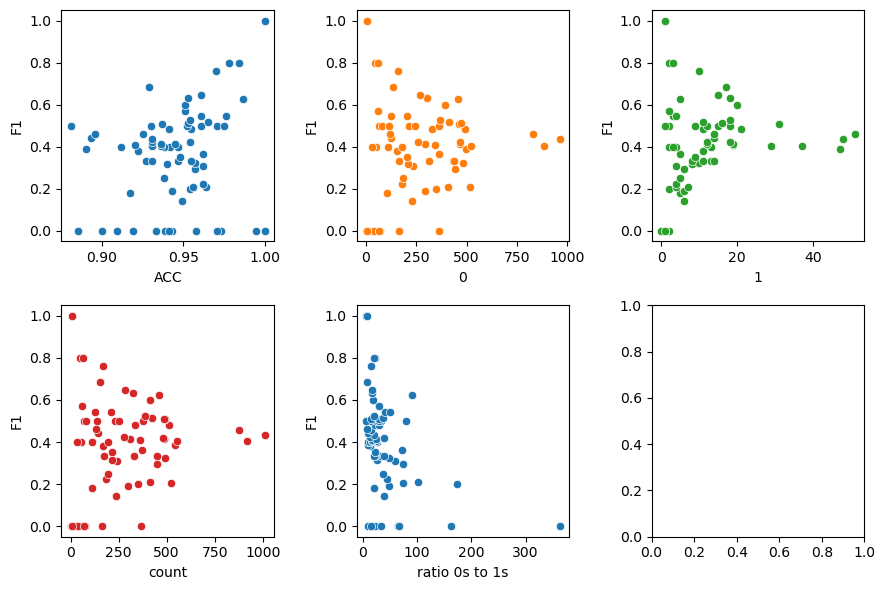

<Figure size 640x480 with 0 Axes>

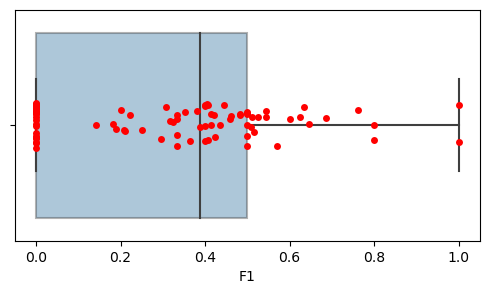

<Figure size 640x480 with 0 Axes>

In [ ]:
show_GE_plots(path_to_emotions, 'anger', model_run)

In [ ]:
show_GE_plots(path_to_emotions, 'disgust', model_run) 

In [ ]:
show_GE_plots(path_to_emotions, 'fear', model_run)

In [ ]:
show_GE_plots(path_to_emotions, 'joy', model_run)

In [ ]:
show_GE_plots(path_to_emotions, 'sadness', model_run)

In [ ]:
show_GE_plots(path_to_emotions, 'surprise', model_run)

In [8]:
path_to_ge_freeze_runs = path_to_models_runs + 'GE/freeze_check_anger/'

In [9]:
runs = sorted(os.listdir(path_to_ge_freeze_runs), key=lambda run: int(run.split('_')[-1]))
runs

['run_model_multi_freeze_first_-1',
 'run_model_multi_freeze_first_0',
 'run_model_multi_freeze_first_1',
 'run_model_multi_freeze_first_4',
 'run_model_multi_freeze_first_6',
 'run_model_multi_freeze_first_8',
 'run_model_multi_freeze_first_9',
 'run_model_multi_freeze_first_10',
 'run_model_multi_freeze_first_11',
 'run_model_multi_freeze_first_12']

In [10]:
all_ge_freeze_res = pd.DataFrame(columns=['freeze_first_k', 'test_f1', 'minutes_per_epoch'])

for run in runs:
    hypers = return_hyperparams(path_to_ge_freeze_runs, run) #time_millis
    millis = hypers['time_millis']
    minutes = millis/1000/60
    # print('_'*100)
    # print(f"RUN: {run}, Train and Eval Time in Minutes: {minutes}")
    # load_and_display_res_df_color(path_to_ge_freeze_runs, run)
    # print('_'*100)
    num_frozen = int(run.split('_')[-1])
    res_df = return_results_df(path_to_ge_freeze_runs, run)
    test_f1 = round(res_df.loc['Test_results','test_f1s'], 2)
    test_acc = round(res_df.loc['Test_results','test_accs'], 2)
    num_epochs = len(res_df[res_df.index.str.lower().str.contains('epoch')])
    run_time = minutes/num_epochs
    all_ge_freeze_res.loc[len(all_ge_freeze_res),:] = [num_frozen,test_f1, run_time]

In [11]:
all_ge_freeze_res.loc[0,'freeze_first_k'] = 0.5

In [115]:
all_ge_freeze_res

,freeze_first_k,test_f1,minutes_per_epoch
1,0,0.4,5.855202
0,0.5,0.39,5.589904
2,1,0.37,5.54742
3,4,0.36,5.114156
4,6,0.37,4.896046
5,8,0.34,4.64383
6,9,0.37,4.505181
7,10,0.37,4.313855
8,NaN,NaN,NaN


In [12]:
all_ge_freeze_res.iloc[0], all_ge_freeze_res.iloc[1] =  all_ge_freeze_res.iloc[1].copy(), all_ge_freeze_res.iloc[0].copy()

In [13]:
display(all_ge_freeze_res.style.background_gradient(cmap ='YlGn', subset=['test_f1','minutes_per_epoch'], low=0, high=0.6).format(precision=3))

,freeze_first_k,test_f1,minutes_per_epoch
0,0,0.400,5.855
1,0.500,0.390,5.590
2,1,0.370,5.547
3,4,0.360,5.114
4,6,0.370,4.896
5,8,0.340,4.644
6,9,0.370,4.505
7,10,0.370,4.314
8,11,0.360,4.229
9,12,0.000,4.074


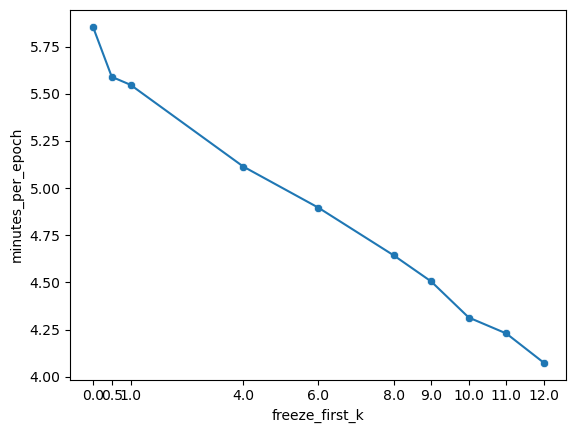

In [35]:
s_plot = sns.lineplot(data=all_ge_freeze_res, x=all_ge_freeze_res.freeze_first_k ,y='minutes_per_epoch')
s_plot2 = sns.scatterplot(data=all_ge_freeze_res, x=all_ge_freeze_res.freeze_first_k ,y='minutes_per_epoch')
s_plot.set_xticks(list(all_ge_freeze_res.freeze_first_k))

In [ ]:
sc

## SC

In [165]:
# all_explo_res_2500 = get_all_res_as_df(2500, only_df='sc-uid_2500')

In [263]:
path_to_runs = '../results/perso_scalability_0/'

In [264]:
path_to_runs = '../results/perso_scalability_0/'

with open('../results/perso_scalability_0/sc-uid_2500_annos/hyper_parameters.json', 'r') as f:
    hyps = json.load(f)

In [265]:
hyps['results'][0], hyps['results'][1]

(['verdicts', 'predictions', 'gold labels'], ['ei09sjn', 0, 0])

In [360]:
train_all_ds = pd.read_csv(f'../data/SC_data/train_sc.csv')

In [361]:
train_annos = get_annos(train_all_ds)

In [376]:
train_counts = train_all_ds.count().to_dict()
train_counts = {k:v for k,v in train_counts.items() if k.isnumeric()}
train_counts = {k:v for k,v in train_counts.items() if int(k) in list(range(2520))}

In [377]:
train_counts_names = {id_to_author_name[int(k)]:v for k,v in train_counts.items()}

In [261]:
num_annos = 2500
path_to_data = '../data/'

social_chemistry = pd.read_pickle(path_to_data +'social_chemistry_clean_with_fulltexts_and_authors.gzip', compression='gzip')
social_comments = pd.read_csv(path_to_data+'social_norms_clean.csv')

sc_traversed_filtered = pd.read_csv(f'../data/sc_filtered_from_bela/sc_{num_annos}_annos_filtered.csv')

anno_ids = [int(x) for x in sc_traversed_filtered.columns if re.fullmatch(r'[0-9]*',x)]

with open(f'{path_to_data}sc_filtered_from_bela/author_mapping.json', 'r') as f:
    author_to_id = json.load(f)
    
id_to_author_name = list(author_to_id.keys())
authors_filtered = [id_to_author_name[i] for i in anno_ids]

social_comments = social_comments[social_comments.author_name.isin(authors_filtered)]

social_chemistry = social_chemistry[social_chemistry.post_id.isin(sc_traversed_filtered.parent_id)]
social_comments = social_comments[social_comments.parent_id.isin(sc_traversed_filtered.parent_id)]

social_comments = social_comments[social_comments.parent_id.isin(social_chemistry.post_id)]
social_chemistry = social_chemistry[social_chemistry.post_id.isin(social_comments.parent_id)]

social_norms_dataset = SocialNormDataset(social_comments, social_chemistry)

Creating situations maps: 18431it [00:00, 63073.04it/s]
Creating filtered verdict-authors maps by condition 5: 116477it [00:01, 60187.17it/s]


After filtering, we are left with 2500 authors and 116477 verdicts.


Creating comments maps: 116477it [00:01, 62755.56it/s]
Removing keywords from verdicts: 100%|██████████| 116477/116477 [00:01<00:00, 94894.56it/s]


In [254]:
def uid_hypers_res_to_author_res_dict_and_count(hyps, social_norms_dataset):

    l = len(hyps['results'])

    anno_res_dict = dict()
    anno_count_dict = dict()

    for i in range(1,l):
        verdict =  hyps['results'][i][0]
        prediction =  hyps['results'][i][1]
        label =  hyps['results'][i][2]
        author = social_norms_dataset.verdictToAuthor[verdict]
        
        if author in anno_res_dict.keys():
            anno_res_dict[author]['preds'].append(prediction)
            anno_res_dict[author]['labels'].append(label)
        else:
            anno_res_dict[author] = {
                'preds': [prediction],
                'labels': [label]
            }
            
        if author in anno_count_dict.keys():
            anno_count_dict[author] += 1
        else:
            anno_count_dict[author] = 1
            
    for k, v in anno_res_dict.items():
        anno_res_dict[k] = {
                'preds': torch.tensor(anno_res_dict[k]['preds']),
                'labels': torch.tensor(anno_res_dict[k]['labels'])
            }
        
    return anno_res_dict, anno_count_dict

In [325]:
def res_dict_to_anno_res_dict_and_count(res_dict, epoch='Test_results'): # for multi-tasking model res_dict
    num_annotators = res_dict[epoch]['all_test_preds'][0].shape[0]

    preds = torch.stack(res_dict[epoch]['all_test_preds'])
    labels = torch.stack(res_dict[epoch]['all_test_labels'])
    
    anno_res = dict()
    anno_counts = dict()
    
    for i in range(num_annos):
        p = preds[:,i]
        l = labels[:,i]
        mask = l.ge(0)
        mask_p = torch.masked_select(p,mask)
        mask_l = torch.masked_select(l,mask)
        
        anno_res[str(i)] = {
            'preds': mask_p,
            'labels': mask_l
        }
        
        anno_counts[str(i)] = len(mask_l)
        
    return anno_res, anno_counts
        

In [255]:
authors_res, author_count = uid_hypers_res_to_author_res_dict_and_count(hyps, social_norms_dataset)

In [245]:
def authors_res_to_authors_f1s(authors_res, how='macro'):
    if how == 'binary':
        f1_score = BinaryF1Score()
    if how == 'macro':
        f1_score = MulticlassF1Score(num_classes=2)
    
    return {k: round(f1_score(v['preds'],v['labels']).item(),3) for k,v in authors_res.items()}

In [256]:
author_count['Lofty_quackers']

3

In [250]:
authors_res['Lofty_quackers']

{'preds': tensor([0, 1, 0]), 'labels': tensor([1, 0, 1])}

In [307]:
with open(f'../results/multi_scalability_0/SC-multi-tasking_2500_annos/model_preds_and_labels.pkl', 'rb') as f:
    preds_labels = pickle.load(f)

In [309]:
preds_labels.keys()

dict_keys(['Test_results'])

In [401]:
def get_avg_folds_indi_f1s_counts(dataset, num_annos, scal_com_scal:Literal['perso_scalability','multi_scalability'], model_type:Literal['SC-uid','SC-multi-tasking']):
    
    all_auths_f1s = dict()
    all_auth_counts = dict()
    
    for i in range(5):
        
        path_to_runs = f"../results/{scal_com_scal}_{i}/"

        if 'perso' in scal_com_scal:
            with open(f'{path_to_runs}{model_type}_{num_annos}_annos/hyper_parameters.json', 'r') as f:
                hyps = json.load(f) 
            authors_res, author_counts = uid_hypers_res_to_author_res_dict_and_count(hyps, dataset)
        else:
            with open(f'{path_to_runs}{model_type}_{num_annos}_annos/model_preds_and_labels.pkl', 'rb') as f:
                preds_labels = pickle.load(f)
            authors_res, author_counts = res_dict_to_anno_res_dict_and_count(preds_labels)
            authors_res = {k:v for k,v in authors_res.items() if len(v['preds']) > 0}
            
        auhtors_f1s = authors_res_to_authors_f1s(authors_res)
        
        for author, f1 in auhtors_f1s.items():
            if author in all_auths_f1s:
                all_auths_f1s[author].append(f1)
            else:
                all_auths_f1s[author] = [f1]
                
        for author, count in author_counts.items():
            if author in all_auth_counts:
                all_auth_counts[author].append(count)
            else:
                all_auth_counts[author] = [count]
                
    all_auths_f1s = {k: sum(v)/len(v) for k,v in all_auths_f1s.items()}
    all_auth_counts = {k: sum(v)/len(v) for k,v in all_auth_counts.items()}
    
    return all_auths_f1s, all_auth_counts
        


In [318]:
avg_sc_uid_2500_f1s, avg_sc_uid_2500_counts = get_avg_folds_indi_f1s_counts(social_norms_dataset, num_annos=2500, scal_com_scal='perso_scalability', model_type='SC-uid')

In [381]:
avg_sc_uid_2500_f1s = {k:v for k,v in sorted(avg_sc_uid_2500_f1s.items(), key= lambda item: id_to_author_name.index(item[0]))}

In [387]:
len(train_counts_names)

2520

In [388]:
len(avg_sc_uid_2500_f1s)

2491

In [410]:
pearsonr(
    list({k:v for k,v in train_counts_names.items() if k in avg_sc_uid_2500_f1s.keys()}.values()),
    list(avg_sc_uid_2500_f1s.values()))

PearsonRResult(statistic=0.06396131948594161, pvalue=0.001403294026444086)

In [413]:
kendalltau(
    list({k:v for k,v in train_counts_names.items() if k in avg_sc_uid_2500_f1s.keys()}.values()),
    list(avg_sc_uid_2500_f1s.values()))

SignificanceResult(statistic=0.047604094771655024, pvalue=0.00046444292439689824)

In [422]:
scipy.spatial.distance.correlation(
    list({k:v for k,v in train_counts_names.items() if k in avg_sc_uid_2500_f1s.keys()}.values()),
    list(avg_sc_uid_2500_f1s.values()))

0.9360386805140583

<Axes: >

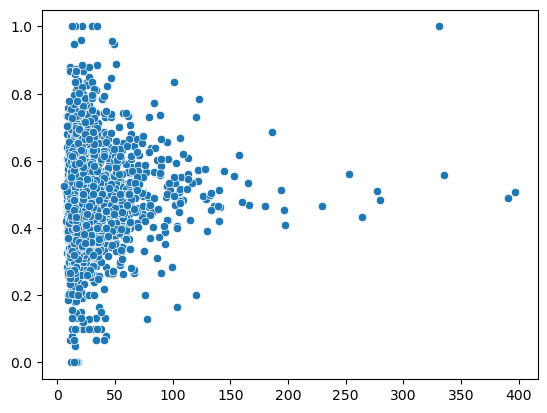

In [390]:
sns.scatterplot(
    x={k:v for k,v in train_counts_names.items() if k in avg_sc_uid_2500_f1s.keys()}.values(),
    y=avg_sc_uid_2500_f1s.values())

In [434]:
import math

In [435]:
math.e**()

TypeError: 'float' object is not callable

In [437]:
math.log(4)

1.3862943611198906

In [392]:
authors_res, author_counts = res_dict_to_anno_res_dict_and_count(preds_labels)

In [398]:
len(torch.tensor([]))

0

In [400]:
authors_res = {k:v for k,v in authors_res.items() if len(v['preds']) > 0}

In [402]:
avg_sc_mt_2500_f1s, avg_sc_mt_2500_counts = get_avg_folds_indi_f1s_counts(social_norms_dataset, num_annos=2500, scal_com_scal='multi_scalability', model_type='SC-multi-tasking')

In [414]:
from scipy.stats.stats import pearsonr, kendalltau
import scipy

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1923389107.py:1: DeprecationWarning: Please use `pearsonr` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import pearsonr, kendalltau
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1923389107.py:1: DeprecationWarning: Please use `kendalltau` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import pearsonr, kendalltau


In [409]:
pearsonr(
    list({k:v for k,v in train_counts.items() if k in avg_sc_mt_2500_f1s.keys()}.values()),
    list(avg_sc_mt_2500_f1s.values()))

PearsonRResult(statistic=0.03062409913288494, pvalue=0.12635087913194148)

In [418]:
kendalltau(
    list({k:v for k,v in train_counts.items() if k in avg_sc_mt_2500_f1s.keys()}.values()),
    list(avg_sc_mt_2500_f1s.values()))

0.969375900867115


In [59]:
scipy.spatial.distance.correlation(
    list({k:v for k,v in train_counts.items() if k in avg_sc_mt_2500_f1s.keys()}.values()),
    list(avg_sc_mt_2500_f1s.values()))

NameError: name 'scipy' is not defined

<Axes: >

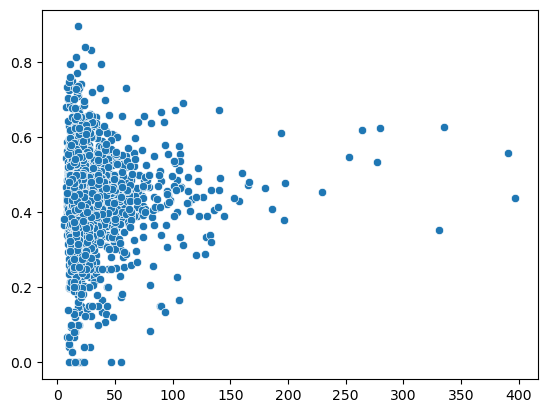

In [404]:
sns.scatterplot(
    x={k:v for k,v in train_counts.items() if k in avg_sc_mt_2500_f1s.keys()}.values(),
    y=avg_sc_mt_2500_f1s.values())

In [314]:
preds_labels['Test_results']['all_test_preds'][0].shape[0]

2500

In [304]:
with open(f'../results/multi_scalability_0/SC-multi-tasking_2500_annos/model_preds_and_labels.pkl', 'rb') as f:
    preds_labels = pickle.load(f)

In [305]:
preds_labels.keys()

dict_keys(['Test_results'])

In [ ]:
def get_scores_annotators(res_dict, epoch):
    num_annotators = res_dict[epoch]['all_test_preds'][0].shape[0]

    preds = torch.stack(res_dict[epoch]['all_test_preds']).to('cpu')
    labels = torch.stack(res_dict[epoch]['all_test_labels']).to('cpu')

    bin_f1_score = BinaryF1Score()
    bin_acc = BinaryAccuracy()

    df = pd.DataFrame(columns=['F1','ACC'])
    
    for i in range(num_annotators):
        p = preds[:,i]
        l = labels[:,i]
        mask = l.ge(0)
        acc = f1 = float('nan')
        if any(mask):
            mask_p = torch.masked_select(p,mask)
            mask_l = torch.masked_select(l,mask)
            acc = round(bin_acc(mask_p,mask_l).item(),3)
            f1 = round(bin_f1_score(mask_p,mask_l).item(),3)
        df.loc[i] = [f1,acc]
    
    l = labels.transpose(0,1).tolist()
    zeros = [a.count(0) for a in l]
    ones = [a.count(1) for a in l]

    df['0'] = zeros
    df['1'] = ones
    df['count'] = df['0'] + df['1']
    
    return df

In [ ]:
def get_f1s(path, emotion, model_run, only_ge1000=False): 
    #of one model run

    path_to_emotion = path+f"{emotion}/"

    majority_results = return_results_df(path_to_emotion,model_run)
    res_dict = load_preds_labels(path_to_emotion, model_run)
    epoch = get_best_epoch(majority_results)

    anno_res = get_scores_annotators(res_dict,epoch)
    anno_res = anno_res.sort_values(by='F1')

    ge1000_f1s = anno_res['F1'][filtered_annos]

    avg_ge1000 = sum(ge1000_f1s) / len(ge1000_f1s)

    if not only_ge1000:
        all_f1s = anno_res['F1'][annos]
        avg = sum(all_f1s) / len(all_f1s)
        return (avg, avg_ge1000)

    return avg_ge1000

# repair & test miscellaneous

In [ ]:
def accept_ours_git(file_path):
    
    with open(file_path) as myfile:
        if not '<<<<<' in myfile.read():
            return
    
    with open(file_path,'r') as f:
        lines = f.readlines()

    lines_to_keep = []
    keep_flag = True

    for line in lines:
        if line[:3] == '===':
            keep_flag = False
            
        if keep_flag and not line[:3] in ['<<<', '>>>']:
            lines_to_keep.append(line)
            
        if line[:3] in ['<<<', '>>>']:
            keep_flag = True 
            
    with open(file_path,'w') as f:
        for line in lines_to_keep:
            f.write(line)

# ROOT = '../results/'
ROOT = '.'
for dirName, subdirList, fileList in os.walk(ROOT):
    # print(dirName)
    for fname in fileList:
        if any([x in fname for x in ['.ipynb','.json']]):
            f_path = os.path.join(dirName, fname)
            print(f_path)
            accept_ours_git(f_path)

In [74]:
with open('../results/SC_GE_GHC_scalability/GE-bertbase_6_annos/model_preds_and_labels.pkl', 'rb') as f:
    preds_res = pickle.load(f)

In [84]:
list(preds_res.keys())

['Epoch0', 'Epoch1', 'Epoch2', 'Epoch3', 'Epoch4']

In [13]:
# from datetime import datetime

# from utils.constants import *
# from utils.run_training import train_model

# # CUDA_VISIBLE_DEVICES=2 /app/home/neuendob/anaconda3/envs/master/bin/python run_model_comment_scalability_GHC_GE.py

# # Parameters
# #dataset_name = 'GHC'  # 'GHC' or 'GE'
# #emotion = 'hate' #'anger', 'disgust', 'joy', 'fear', 'sadness', 'surprise | for GHC: 'hate'
# task = 'multi'  # 'single' or 'multi'
# use_ds_reduced_to_sc = False
# batch_size = 16
# num_epochs = 10
# num_splits = 5
# val_ratio = 0.25
# print_interval = 100/batch_size
# #learning_rate = 5e-6 # 1e-5 for GHC, 5e-6 for GE
# stop_after_fold = 2
# max_length = 64
# min_number_of_annotations = 1
# # If false, stratification is done by all combinations of annotators (possibly 2^n_annotators)
# stratify_by_majority_vote = True

# path_to_data = f'../data/'
# seed = SEED
 
# ge_num_annos_list = [14,50] #14,50
# ghc_num_annos_list = [14] #14

# comment_scalability = False
# task = 'single'

# for dataset_name, learning_rate, emotion, num_anno_list in zip(['GHC','GE'], [1e-5, 5e-6], ['hate','anger'], [ghc_num_annos_list, ge_num_annos_list]):
# # for dataset_name, learning_rate, emotion, num_anno_list in zip(['GHC'], [1e-5], ['hate'], [ghc_num_annos_list]):
# # for dataset_name, learning_rate, emotion, num_anno_list in zip(['GE'], [5e-6], ['anger'], [ge_num_annos_list]):
    
#     comment_num_annos_list = [14,50]
#     num_annos_list = []
#     comments_percentage_list = [False]

#     num_annos_GE = [6, 8, 10, 12, 14, 16, 18] + list(range(22, 83, 4))
#     num_annos_SC = [6, 8, 10, 12, 14, 16, 18] + list(range(22, 83, 4)) + list(range(100, 501, 50)) + list(range(600, 1201, 100)) + list(range(1300, 2510, 300))
#     num_annos_GHC = [6, 8, 10, 12, 14, 16, 18]

#     GE_comments_percentage_list = [float(f'0.0{x}') for x in range(1,10,2)] + [float(f'0.{x}') for x in range(1,10)] + [1.0]
#     GHC_comments_percentage_list = [float(f'0.0{x}') for x in range(1,10,1)] + [float(f'0.{x}') for x in range(1,10)] + [1.0]
#     SC_comments_percentage_list = [float(f'0.0{x}') for x in range(1,10,2)] + [float(f'0.{x}') for x in range(1,10)] + [1.0]

#     if dataset_name == 'GE':
#         num_annos_list = num_annos_GE
#         if comment_scalability:
#             num_annos_list = comment_num_annos_list
#             comments_percentage_list = GE_comments_percentage_list
#     if dataset_name == 'GHC':
#         num_annos_list = num_annos_GHC
#         if comment_scalability:
#             num_annos_list = comment_num_annos_list[:1]
#             comments_percentage_list = GHC_comments_percentage_list
#     if dataset_name == 'social_norms':
#         num_annos_list = num_annos_SC
#         if comment_scalability:
#             num_annos_list = comment_num_annos_list
#             comments_percentage_list = SC_comments_percentage_list
    
#     for comments_percentage in comments_percentage_list:
        
#         for num_annos in num_annos_list:
            
#             if dataset_name == 'social_norms':
#                 path_to_data = f'../../user-perception/data/sc_filtered_from_bela/'
#             else:
#                 path_to_data = f'../data/'

            
#             if comment_scalability:
#                 path_to_dataset = f'{path_to_data}matching_sizes_data/{dataset_name}*full_{num_annos}_annos_filtered.csv'
#             else:
#                 path_to_dataset = f'{path_to_data}matching_sizes_data/{dataset_name}_{num_annos}_annos_filtered.csv'
            
#             # if task == 'multi':
#             #     path_to_save = f'../results/SC_GE_GHC_comment_scalability/{dataset_name}-multi-tasking_{int(comments_percentage*100)}_percentage_{num_annos}_annos/'
#             # elif task == 'single':
#             #     path_to_save = f'../results/SC_GE_GHC_comment_scalability/{dataset_name}-bertbase_{int(comments_percentage*100)}_percentage_{num_annos}_annos/'

#             path_to_save = f'../results/SC_GE_GHC_scalability/{dataset_name}-bertbase_{num_annos}_annos/'
            
#             with open(path_to_dataset, 'r') as f:
#                 dataframe = pd.read_csv(f)
                
#             if 'Unnamed: 0' in dataframe.columns:
#                 dataframe = dataframe.drop('Unnamed: 0', axis=1)
#                 dataframe.index.name = None
            
#             dataframe['id'] = dataframe.index
            
#             ds_name = dataset_name.lower()
#             train_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/train_{ds_name}.csv')
#             val_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/val_{ds_name}.csv')
#             test_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/test_{ds_name}.csv')
#             train_ds = dataframe[dataframe.id.isin(train_all_ds.id)]
#             val_ds = dataframe[dataframe.id.isin(val_all_ds.id)]
#             test_ds = dataframe[dataframe.id.isin(test_all_ds.id)]
            
#             if comments_percentage:
#                 train_ds = reduce_df_to_min_num_annos(train_ds, comments_percentage)
#                 # val_ds = reduce_df_to_min_num_annos(val_ds, comments_percentage)
#                 # test_ds = reduce_df_to_min_num_annos(test_ds, comments_percentage)
        
#             train_ids = list(train_ds.id)
#             val_ids = list(val_ds.id)
#             test_ids = list(test_ds.id)
            
#             num_comments_per_anno_train = min(train_ds.count())
            
#             dataframe = pd.concat([train_ds, val_ds, test_ds])
            
#             # dataframe = dataframe.replace(float('nan'), -1)
#             test_ds = test_ds.replace(float('nan'), -1)
            
#             # dataframe = filter_df_min_annotation_and_update_majority(dataframe, min_number_of_annotations)
            
#             annotator_ids = [
#                 x for x in dataframe.columns if re.fullmatch(r'[0-9]+', x)]
            
#             print(path_to_save)
#             # dataframe = dataframe.convert_dtypes()
            
#             with open(f'../results/SC_GE_GHC_scalability/{dataset_name}-bertbase_{num_annos}_annos/model_preds_and_labels.pkl', 'rb') as f:
#                 preds_res = pickle.load(f)
                
#             pred_tensor_list = preds_res[list(preds_res.keys())[-1]]['all_test_preds']
            
            
#             preds_tensor = torch.stack(pred_tensor_list).expand(len(pred_tensor_list),num_annos)
#             labels_tensor = torch.tensor(test_ds[annotator_ids].values.astype(int))

#             all_bin_preds_tensor =  torch.flatten(preds_tensor)
#             all_bin_labels_tensor = torch.flatten(labels_tensor)
#             labeled_filter = (all_bin_labels_tensor != -1)
#             all_bin_preds_tensor = all_bin_preds_tensor[labeled_filter]
#             all_bin_labels_tensor = all_bin_labels_tensor[labeled_filter]

#             f1_individual_binary = float(f1_score(all_bin_preds_tensor, all_bin_labels_tensor))
#             f1_individual_macro = f1_score(all_bin_preds_tensor, all_bin_labels_tensor, average='macro')

#             res_d =  __load_results_dict(path_to_save)
#             for k,v in res_d.items():
#                 if 'Epoch' in k:
#                     res_d[k]['val_f1_individual_binary'] = 0.0
#                     res_d[k]['val_f1_individual_macro'] = 0.0
#                 elif 'Test' in k:
#                     res_d[k]['test_f1_individual_binary'] = 0.0
#                     res_d[k]['test_f1_individual_macro'] = 0.0
            
#             with open(path_to_save + '/model_results.json', 'w') as file:
#                 json.dump(res_d, file)

            
                

../results/SC_GE_GHC_scalability/GHC-bertbase_6_annos/


../results/SC_GE_GHC_scalability/GE-bertbase_6_annos/


In [ ]:
# # check datasets when filtered
# path_to_personalization_runs_comments_exploration = '../../user_perception/results/comment_scalability'
# # path_to_run = path_to_multi_tasking_runs_comments_exploration + 'SC-bertbase_10_percentage_14_annos/'
# path_to_run = path_to_personalization_runs_comments_exploration + 'sc-ae_10_percentage_14_annos/'
# run = path_to_run.split('/')[-2]
# path_to_sc_data = '../data/sc_filtered_from_bela/'
# path_to_ge_ghc_data = f'../data/matching_sizes_data/'

# num_annos = int(run.split('_')[-2])
# dataset_name = run.split('-')[0]
# if 'percentage' in path_to_run:
#     comments_percentage = int(path_to_run.split('_')[-4]) / 100
# else: 
#     comments_percentage = False
    
# if dataset_name.lower() == 'sc': 
#     path_to_dataset = f'{path_to_sc_data}sc_{num_annos}_annos_filtered.csv'
#     with open(path_to_dataset, 'r') as f:
#         dataframe = pd.read_csv(f)
# else:
#     path_to_dataset = f'{path_to_ge_ghc_data}{dataset_name}_{num_annos}_annos_filtered.csv'
#     with open(path_to_dataset, 'r') as f:
#         dataframe = pd.read_csv(f)
        
# if 'sc' in dataset_name.lower():
#     social_chemistry = pd.read_pickle('../../user_perception/data/social_chemistry_clean_with_fulltexts_and_authors.gzip', compression='gzip')
#     social_comments = pd.read_csv('../../user_perception/data/social_norms_clean.csv')
#     print('SC', social_chemistry.shape)
#     print('SN', social_comments.shape)
    
#     sc_traversed_filtered = pd.read_csv(f'{path_to_sc_data}sc_{num_annos}_annos_filtered.csv')

#     if comments_percentage:
#         dataframe  = sc_traversed_filtered
#         print('TRAV', dataframe.shape)
#         dataframe['id'] = dataframe.index 
#         ds_name = 'sc'
#         train_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/train_{ds_name}.csv')
#         print('TR_ALL', train_all_ds.shape)
#         val_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/val_{ds_name}.csv')
#         test_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/test_{ds_name}.csv')
        
#         train_ds = dataframe[dataframe.id.isin(train_all_ds.id)]
#         val_ds = dataframe[dataframe.id.isin(val_all_ds.id)]
#         test_ds = dataframe[dataframe.id.isin(test_all_ds.id)]
        
#         train_ds = reduce_df_to_min_num_annos(train_ds, comments_percentage)
        
#         train_parent_ids = list(train_ds.parent_id)
#         val_parent_ids = list(val_ds.parent_id)
#         test_parent_ids = list(test_ds.parent_id)
        
#         num_comments_per_anno_train = min(train_ds.count())

#         dataframe = pd.concat([train_ds, val_ds, test_ds])
#         dataframe = dataframe.replace(float('nan'), -1)
#         dataframe = filter_df_min_annotation_and_update_majority(dataframe, 1)
        
#         sc_traversed_filtered = dataframe
            
#         anno_ids = [int(x) for x in sc_traversed_filtered.columns if re.fullmatch(r'[0-9]*',x)]

#         with open(f'{path_to_sc_data}author_mapping.json', 'r') as f:
#             author_to_id = json.load(f)
            
#         id_to_author_name = list(author_to_id.keys())
#         authors_filtered = [id_to_author_name[i] for i in anno_ids]

#         social_comments = social_comments[social_comments.author_name.isin(authors_filtered)]
        
#         social_chemistry = social_chemistry[social_chemistry.post_id.isin(sc_traversed_filtered.parent_id)]
#         social_comments = social_comments[social_comments.parent_id.isin(sc_traversed_filtered.parent_id)]
        
#         social_comments = social_comments[social_comments.parent_id.isin(social_chemistry.post_id)]
#         social_chemistry = social_chemistry[social_chemistry.post_id.isin(social_comments.parent_id)]
        
#         print('-'*50)
#         print(len(sc_traversed_filtered), len(social_chemistry), len(social_comments))
        
#         dataset = SocialNormDataset(social_comments, social_chemistry)
#         annotator_ids = anno_ids
        
        
        
                    
# elif dataset_name.lower() in ['ge','ghc']:
#     if 'Unnamed: 0' in dataframe.columns:
#         dataframe = dataframe.drop('Unnamed: 0', axis=1)
#         dataframe.index.name = None
            
#     dataframe['id'] = dataframe.index 
    
#     if comments_percentage:
#         ds_name = dataset_name.lower()
#         train_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/train_{ds_name}.csv')
#         val_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/val_{ds_name}.csv')
#         test_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/test_{ds_name}.csv')
        
#         train_ds = dataframe[dataframe.id.isin(train_all_ds.id)]
#         val_ds = dataframe[dataframe.id.isin(val_all_ds.id)]
#         test_ds = dataframe[dataframe.id.isin(test_all_ds.id)]
        
#         train_ds = reduce_df_to_min_num_annos(train_ds, comments_percentage)
#         # val_ds = reduce_df_to_min_num_annos(val_ds, comments_percentage)
#         # test_ds = reduce_df_to_min_num_annos(test_ds, comments_percentage)
        
#         train_ids = list(train_ds.id)
#         val_ids = list(val_ds.id)
#         test_ids = list(test_ds.id)
        
#         num_comments_per_anno_train = min(train_ds.count())
  
#     dataframe = dataframe.replace(float('nan'), -1)
    
#     dataframe = filter_df_min_annotation_and_update_majority(dataframe, 1)
    
#     annotator_ids = [
#         x for x in dataframe.columns if re.fullmatch(r'[0-9]+', x)]
    
    
# if not comments_percentage:
#     train_verdicts, train_labels, val_verdicts, val_labels, test_verdicts, test_labels = get_verdicts_by_situations_split(dataset)
# else:
#     if dataset_name == 'sc':
#         train_verdicts, train_labels, val_verdicts, val_labels, test_verdicts, test_labels = get_verdicts_by_situations_split_by_predefined_splits(dataset, train_parent_ids, val_parent_ids, test_parent_ids, annotator_ids, train_ds, author_to_id)
#     else:
#         train_verdicts, train_labels, val_verdicts, val_labels, test_verdicts, test_labels = get_verdicts_by_situations_split_by_predefined_splits(dataset, train_parent_ids, val_parent_ids, test_parent_ids, annotator_ids, train_ds)

In [ ]:
# # #apply a function to all files in a dir, recursively:
# path_to_sc_data = '../../user_perception/data/sc_filtered_from_bela/'
# path_to_ge_ghc_data = f'../data/matching_sizes_data/'

# ROOT_DIR='../results/SC_GE_GHC_scalability'
# for dirName, subdirList, fileList in os.walk(ROOT_DIR):
#     for fname in fileList:
#         if 'model_results.json' in fname:
#             fpath = dirName+'/'+fname
#             num_annos = re.search(r"[0-9]+", fpath)[0]
#             dataset_name = re.search(r"GE|GHC|sc", dirName.split('/')[-1])[0]
#             print(fpath)
                
#             if 'sc' == dataset_name:
#                 path_to_dataset = f'{path_to_sc_data}sc_{num_annos}_annos_filtered.csv'
#                 with open(path_to_dataset, 'r') as f:
#                     dataframe = pd.read_csv(f)
#                 dataset_size = len(dataframe)
#             else:
#                 path_to_dataset = f'{path_to_ge_ghc_data}{dataset_name}_{num_annos}_annos_filtered.csv'
#                 with open(path_to_dataset, 'r') as f:
#                     dataframe = pd.read_csv(f)
#                 dataset_size = len(dataframe)
            
#             # res_df = return_results_df(fpath)
#             with open(fpath, 'r') as file:
#                 res_dict =  json.load(file)
            
#             for k,v in res_dict.items():
#                 for k2 in list(v.keys()):
#                     new_k2 = k2.replace('f1s','f1').replace('accs','acc').replace('test_f1_majorityMacro','test_f1_majority_macro')
#                     v[new_k2] = v.pop(k2)
#                 if 'test_results' in k:
#                     v['dataset_size'] = dataset_size
#                     annotator_ids = [x for x in dataframe if re.fullmatch(r"[0-9]+", x)]
#                     v['number_of_annotations'] = int(dataframe[annotator_ids].count().sum())
            
#             json.dumps(res_dict) # only check if jsonable
            
#             # with open(fpath, 'w') as f:
#             #     json.dump(res_dict,f)

        

In [43]:
# path_to_sc_data = '../../user_perception/data/sc_filtered_from_bela/'
# # path_to_ge_ghc_data = f'../data/matching_sizes_data/'

# path_to_dataset = f'{path_to_sc_data}sc_{70}_annos_filtered.csv'
# with open(path_to_dataset, 'r') as f:
#     df = pd.read_csv(f)
#     annotator_ids = [x for x in df if re.fullmatch(r"[0-9]+", x)]
# dataset_size = len(df)
# num_annotations = df[annotator_ids].count().sum()

In [136]:
# ge_ghc_exploration_runs_18 = [x for x in os.listdir(path_to_ge_ghc_data_size_exploration)]
# ge_ghc_exploration_runs_18 = sorted(ge_ghc_exploration_runs_18, key=lambda run: (int(run.split('_')[1]),run.split('_')[0]))

# #apply a function to all files in a dir, recursively:
# path_to_sc_data = '../../user_perception/data/sc_filtered_from_bela/'

# ROOT_DIR='../../user_perception/results/scalability_run/GE_user_id/'
# for dirName, subdirList, fileList in os.walk(ROOT_DIR):
#     for fname in fileList:
#         if 'model_results.json' in fname:
#             fpath = ROOT_DIR+fname
#             num_annos = fname.split('_')[0]
#             dataset_name = 'GE'
                
#             # path_to_dataset = f'{path_to_sc_data}sc_{num_annos}_annos_filtered.csv'
#             # with open(path_to_dataset, 'r') as f:
#             #     dataframe = pd.read_csv(f)
#             # dataset_size = len(dataframe)
            
#             path_to_dataset = f'{path_to_ge_ghc_data}{dataset_name}_{num_annos}_annos_filtered.csv'
#             with open(path_to_dataset, 'r') as f:
#                 dataframe = pd.read_csv(f)
                
#             dataset_size = len(dataframe)
#             annos = [x for x in dataframe.columns if re.fullmatch(r"[0-9]+",x)]
#             num_annos = int(dataframe[annos].count().sum())
            
#             # res_df = return_results_df(fpath)
#             with open(fpath, 'r') as file:
#                 res_dict =  json.load(file)
            
#             res_dict['Test_results']['number_of_annotations'] = num_annos
            
#             # for k,v in res_dict.items():
#             #     for k2 in list(v.keys()):
#             #         new_k2 = k2.replace('f1s','f1').replace('accs','acc').replace('etest_time_millis','test_time_millis').replace('test_f1_majority_bin','test_f1_majority_binary')
#             #         v[new_k2] = v.pop(k2)
#             #     if 'Test_results' in k:
#             #         v['dataset_size'] = dataset_size
#             #         v['number_of_annotations'] = dataset_size
            
#             json.dumps(res_dict) # only check if jsonable
            
#             with open(fpath, 'w') as f:
#                 json.dump(res_dict,f)

        

In [5]:
print([6, 8, 10, 12, 14, 16, 18] + list(range(22, 83, 4)) + list(range(100, 1000, 100)) + list(range(1000, 2510, 300)))

[6, 8, 10, 12, 14, 16, 18, 22, 26, 30, 34, 38, 42, 46, 50, 54, 58, 62, 66, 70, 74, 78, 82, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1300, 1600, 1900, 2200, 2500]


In [79]:
'asdf_10_percentage'.strip('_10_percentage')

'sdf'

In [100]:
ROOT_DIR='../results'
for dirName, subdirList, fileList in os.walk(ROOT_DIR):
    if 'comment' in dirName:
        if dirName[-5:] == 'ntage':
            print(dirName)
            percentage_str = re.findall(r'_[0-9]{2,3}_percentage', dirName)[0]
            percentage = int(percentage_str.split('_')[1])
            annos_str = re.findall(r'_[0-9]{1,2}_annos', dirName)[0]
            annos = int(annos_str.split('_')[1])
            
            new_dirName = dirName.replace(annos_str, '')
            new_dirName = new_dirName.replace(percentage_str, '')
            new_dirName = new_dirName  + percentage_str + annos_str
            
            print(new_dirName)
            print('_'*30)
            
            # os.rename(dirName, new_dirName)
            #     # for file in fileList:
            #     #     print(file)
            #     #     os.remove(os.path.join(dirName, file))
            #     # os.rmdir(dirName)

In [29]:
ROOT_DIR='../results'
for dirName, subdirList, fileList in os.walk(ROOT_DIR):
    if 'comment_scalability' in dirName and 'MD' in dirName:
        
        annos_str = re.findall(r'[0-9]+_annos', dirName)[0].split('_')[0]
        num_annos = int(annos_str)
        
        if num_annos not in [14,50]:
            print(dirName)
            print(num_annos)
            # for file in fileList:
            #     os.remove(os.path.join(dirName, file))
            # os.rmdir(dirName)

In [18]:
ROOT_DIR='../results'
for dirName, subdirList, fileList in os.walk(ROOT_DIR):
    if 'sc-' in dirName and not 'SC-' in dirName:
        print(dirName)

        for file in fileList:
            os.remove(os.path.join(dirName, file))
        os.rmdir(dirName)

../results/multi_scalability_0/sc-bertbase_30_annos
../results/multi_scalability_0/sc-bertbase_700_annos
../results/multi_scalability_0/sc-bertbase_26_annos
../results/multi_scalability_0/sc-bertbase_300_annos
../results/multi_scalability_0/sc-bertbase_6_annos
../results/multi_scalability_0/sc-bertbase_82_annos
../results/multi_scalability_0/sc-bertbase_10_annos
../results/multi_scalability_0/sc-bertbase_1600_annos
../results/multi_scalability_0/sc-bertbase_1300_annos
../results/multi_scalability_0/sc-bertbase_70_annos
../results/multi_scalability_0/sc-bertbase_66_annos
../results/multi_scalability_0/sc-bertbase_12_annos
../results/multi_scalability_0/sc-bertbase_8_annos
../results/multi_scalability_0/sc-bertbase_50_annos
../results/multi_scalability_0/sc-bertbase_600_annos
../results/multi_scalability_0/sc-bertbase_2500_annos
../results/multi_scalability_0/sc-bertbase_200_annos
../results/multi_scalability_0/sc-bertbase_46_annos
../results/multi_scalability_0/sc-bertbase_38_annos
../r

In [20]:
re.findall(r'[0-9]+_annos', '_4/MD-sbertbase_10_percentage_70_annos')[0].split('_')[0]

'70'

In [134]:
p = '../data/matching_sizes_data/'
for dirName, subdirList, fileList in os.walk(p):
    for file in fileList:
        if 'MD' in file:
            print(file)
            path_to_file = os.path.join(p, file)
            
            # df = pd.read_csv(path_to_file)
            # df = df.rename({'post_id':'id'}, axis=1)
            
            # for col in df.columns:
            #     if 'Unname' in col:
            #         df = df.drop(col, axis=1)
            
            # df.to_csv(path_to_file, index=False)

            

MD_12_annos_filtered.csv
MD_682_annos_filtered.csv
MD_22_annos_filtered.csv
MD_100_annos_filtered.csv
MD_42_annos_filtered.csv
MD_400_annos_filtered.csv
MD_62_annos_filtered.csv
MD_74_annos_filtered.csv
MD_82_annos_filtered.csv
MD_8_annos_filtered.csv
MD_54_annos_filtered.csv
MD_34_annos_filtered.csv
MD_6_annos_filtered.csv
MD_14_annos_filtered.csv
MD_500_annos_filtered.csv
MD_46_annos_filtered.csv
MD_600_annos_filtered.csv
MD_300_annos_filtered.csv
MD_38_annos_filtered.csv
MD_66_annos_filtered.csv
MD_18_annos_filtered.csv
MD_78_annos_filtered.csv
MD_16_annos_filtered.csv
MD_58_annos_filtered.csv
MD_26_annos_filtered.csv
MD_30_annos_filtered.csv
MD_10_annos_filtered.csv
MD_200_annos_filtered.csv
MD_70_annos_filtered.csv
MD_50_annos_filtered.csv


In [231]:
dataframe_50.count(axis=0)

id          7333
117          278
144          194
149         1110
169          212
188          328
200          992
209          201
232          316
237          323
240          248
245          360
266          413
274          811
29           314
30           191
306          270
328          213
334          508
338          245
344          369
369          228
379          254
390          299
402          214
419          306
425          247
428          296
443          447
501          324
514          826
517          723
546          231
573          372
582          639
60           206
616          342
632          330
64           294
669          358
681          427
708          300
721          225
730          225
734          192
755          258
763          252
768          768
779         1987
811          286
88           397
text        7333
majority    7333
dtype: int64

In [232]:
192 * 0.6

115.19999999999999

In [233]:
372 * 0.6

223.2

In [230]:
dataframe_14.count(axis=0)

id          5972
149         1110
200          992
266          413
274          811
334          508
443          447
514          826
517          723
573          372
582          639
681          427
768          768
779         1987
88           397
text        5972
majority    5972
dtype: int64

In [234]:
ds = dataframe_14[dataframe_14.id.isin(train_all_ds.id)]

In [235]:
ds.count()

id          1207
149          224
200          190
266           79
274          174
334           97
443           94
514          156
517          139
573           90
582          130
681           94
768          164
779          404
88            87
text        1207
majority    1207
dtype: int64

In [227]:
num_annos = 14
path_to_dataset = f'../data/matching_sizes_data/MD_{num_annos}_annos_filtered.csv'
with open(path_to_dataset, 'r') as f:
    dataframe_14 = pd.read_csv(f)

num_annos = 50
path_to_dataset = f'../data/matching_sizes_data/MD_{num_annos}_annos_filtered.csv'
with open(path_to_dataset, 'r') as f:
    dataframe_50 = pd.read_csv(f)
    
train_all_ds = pd.read_csv(f'../data/MD_data/train_md.csv')

fail_list = []
ROOT_DIR='../results'
for dirName, subdirList, fileList in os.walk(ROOT_DIR):
    if 'multi_comment' in dirName and 'MD' in dirName:
        print(dirName)
        
        annos_str = re.findall(r'_[0-9]{1,2}_annos', dirName)[0]
        num_annos = int(annos_str.split('_')[1])
        percentage_str = re.findall(r'_[0-9]{2,3}_percentage', dirName)[0]
        percentage = int(percentage_str.split('_')[1])
        percentage_fraction = percentage/100
        
        if num_annos == 14:
            dataframe = dataframe_14
        if num_annos == 50:
            dataframe = dataframe_50

        # path_to_dataset = f'../data/matching_sizes_data/MD_{num_annos}_annos_filtered.csv'
        # with open(path_to_dataset, 'r') as f:
        #     dataframe = pd.read_csv(f)
        
        # train_all_ds = pd.read_csv(f'../data/MD_data/train_md.csv')
        train_ds = dataframe[dataframe.id.isin(train_all_ds.id)]
        train_ds = reduce_df_to_min_num_annos(train_ds, percentage_fraction)
        
        num_comments_per_anno_train = min(train_ds.count())
        print(num_comments_per_anno_train)
        
        path_to_hyps = os.path.join(dirName, 'hyper_parameters.json')
        
        try:
            with open(path_to_hyps, 'r') as f:
                hyps = json.load(f)
            
            if not 'num_comments_per_anno_train' in hyps.keys():
                hyps['num_comments_per_anno_train'] = num_comments_per_anno_train
                
                # with open(path_to_hyps, 'w') as f:
                #     json.dump(hyps, f)
                
        except Exception as e:
            fail_list.append(path_to_hyps)
        
        

../results/multi_comment_scalability_2/MD-multi-tasking_10_percentage_50_annos
3
../results/multi_comment_scalability_2/MD-bertbase_20_percentage_14_annos
15
../results/multi_comment_scalability_2/MD-bertbase_30_percentage_50_annos
10
../results/multi_comment_scalability_2/MD-multi-tasking_40_percentage_50_annos
14
../results/multi_comment_scalability_2/MD-multi-tasking_50_percentage_14_annos
39
../results/multi_comment_scalability_2/MD-bertbase_60_percentage_50_annos
21
../results/multi_comment_scalability_2/MD-bertbase_70_percentage_14_annos
55
../results/multi_comment_scalability_2/MD-bertbase_90_percentage_50_annos
31
../results/multi_comment_scalability_2/MD-bertbase_80_percentage_14_annos
63
../results/multi_comment_scalability_2/MD-bertbase_90_percentage_14_annos
71
../results/multi_comment_scalability_2/MD-bertbase_80_percentage_50_annos
28
../results/multi_comment_scalability_2/MD-bertbase_20_percentage_50_annos
7
../results/multi_comment_scalability_2/MD-bertbase_30_percentag

KeyboardInterrupt: 

In [147]:
fail_list

['../results/multi_comment_scalability_1/MD-multi-tasking_100_percentage_50_annos/hyper_parameters.json']

In [105]:
train_all_ds

,post_id,0,1,10,100,101,102,103,104,105,...,90,91,93,94,95,96,97,99,text,majority
0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Good god, what is the matter with people ?",0
1,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Please lost you yelling insanely at the sky on...,1
2,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Dang it!!,0
3,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Just take the L g, or find better evidence",0
4,26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...waiting for anonymous to come out and surpr...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1534,7670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pence never believe in science but his own God...,1
1535,7675,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,The WHO can suck it. We need to get the hell o...,1
1536,7677,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Holy shit...I mean...holy fucking shit. I've s...,1
1537,7688,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Trump tries to out-macho COVID-19 amid increas...,0


In [68]:
ge_ghc_exploration_runs_18 = [x for x in os.listdir(path_to_ge_ghc_data_size_exploration)]
ge_ghc_exploration_runs_18 = sorted(ge_ghc_exploration_runs_18, key=lambda run: (int(run.split('_')[1]),run.split('_')[0]))

NameError: name 'path_to_ge_ghc_data_size_exploration' is not defined

In [32]:
# all_res

In [31]:
all_pls['Epoch0'].keys()

dict_keys(['all_test_preds', 'all_test_labels'])

In [25]:
# all_pls['Epoch0']['all_test_labels']

In [121]:
dataframe = pd.read_csv(f'../../Master_Thesis/data/matching_sizes_data/GE_66_annos_filtered.csv')
dataset = RegularDataset(dataframe)

Creating situations maps: 9045it [00:01, 5423.87it/s]


In [126]:
annos = [x for x in dataframe.columns if re.fullmatch(r"[0-9]+",x)]
dataframe[annos].count().sum()

31913

In [208]:
num_annos = 6

path_to_data = '../data/'
social_chemistry = pd.read_pickle('../data/social_chemistry_clean_with_fulltexts_and_authors.gzip', compression='gzip')
social_comments = pd.read_csv(path_to_data+'social_norms_clean.csv')

sc_traversed_filtered = pd.read_csv(f'{path_to_data}sc_filtered_from_bela/sc_{num_annos}_annos_filtered.csv')
annos = [x for x in sc_traversed_filtered.columns if re.fullmatch(r'[0-9]*',x)]
len(social_chemistry), len(social_comments)

(21209, 326944)

In [ ]:
anno_ids = [int(x) for x in sc_traversed_filtered.columns if re.fullmatch(r'[0-9]*',x)]

with open('../../user_perception/data/sc_filtered_from_bela/author_mapping.json', 'r') as f:
    author_to_id = json.load(f)
id_to_author_name = list(author_to_id.keys())

authors_filtered = [id_to_author_name[i] for i in anno_ids]

social_comments = social_comments[social_comments.author_name.isin(authors_filtered)]

len(social_chemistry), len(social_comments)

(21209, 4188)

In [ ]:
social_comments = social_comments[social_comments.parent_id.isin(social_chemistry.post_id)]
social_chemistry = social_chemistry[social_chemistry.post_id.isin(social_comments.parent_id)]
len(social_chemistry), len(social_comments)

(2769, 3264)

In [ ]:
social_chemistry = social_chemistry[social_chemistry.post_id.isin(sc_traversed_filtered.parent_id)]
social_comments = social_comments[social_comments.parent_id.isin(sc_traversed_filtered.parent_id)]
len(social_chemistry), len(social_comments)

(2251, 2613)

In [ ]:
social_comments = social_comments[social_comments.parent_id.isin(social_chemistry.post_id)]
social_chemistry = social_chemistry[social_chemistry.post_id.isin(social_comments.parent_id)]
len(social_chemistry), len(social_comments)

(2251, 2613)

In [ ]:
len(social_chemistry), len(list(set(social_comments.parent_id)))

(2251, 2251)

In [636]:
dataframe = sc_traversed_filtered
min_number_of_annotations = 1
max_length =  64

# dataframe.index = dataframe['id']

dataframe['id'] = dataframe.index

ds_name = 'sc' #dataset_name.lower()
train_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/train_{ds_name}.csv')
val_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/val_{ds_name}.csv')
test_all_ds = pd.read_csv(f'../data/{ds_name.upper()}_data/test_{ds_name}.csv')
train_ds = dataframe[dataframe.id.isin(train_all_ds.id)]
val_ds = dataframe[dataframe.id.isin(val_all_ds.id)]
test_ds = dataframe[dataframe.id.isin(test_all_ds.id)]

# if comments_percentage:
#     train_ds = reduce_df_to_min_num_annos(train_ds, comments_percentage)
#     # val_ds = reduce_df_to_min_num_annos(val_ds, comments_percentage)
#     # test_ds = reduce_df_to_min_num_annos(test_ds, comments_percentage)

# train_ids = list(train_ds.id)
# val_ids = list(val_ds.id)
# test_ids = list(test_ds.id)

num_comments_per_anno_train = min(train_ds.count())

dataframe = pd.concat([train_ds, val_ds, test_ds])

dataframe = dataframe.replace(float('nan'), -1)
dataframe = filter_df_min_annotation_and_update_majority(dataframe, min_number_of_annotations)

annotator_ids = [
    x for x in dataframe.columns if re.fullmatch(r'[0-9]+', x)]

dataframe = dataframe.convert_dtypes()
tokenizer = transformers.BertTokenizer.from_pretrained("bert-base-cased")

# if task == 'single':
#     # dataframe[['id', 'text', 'majority']]
#     dataframe_all = dataframe.copy().convert_dtypes()
#     dataframe = dataframe[['text', 'majority']]
#     dataframe['0'] = dataframe['majority']
#     dataframe = dataframe.convert_dtypes()
#     dataset = MultiTaskDataset(
#         dataframe, tokenizer=tokenizer, max_length=max_length, all_annos_df_for_maj_indi=dataframe_all)
# else:
mt_dataset = MultiTaskDataset(
    dataframe, tokenizer=tokenizer, max_length=max_length)

In [639]:
mt_dataset.num_annotators, mt_dataset.number_annotations

(2500, 116319)

In [742]:
dataframe2 = dataframe.replace(-1, float('nan'))

In [746]:
counts_sc_2500 = sorted(dataframe2[get_annos(dataframe2)].count())

In [794]:
counts_sc_2500[1100:1128]

[29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29,
 29]

In [ ]:
# 2314 less than 100
# 1864 less 50
# 1128 leq 30

In [637]:
import string
sc_dataset = SocialNormDataset(social_comments, social_chemistry)


Creating situations maps: 18431it [00:00, 48198.61it/s]
Creating filtered verdict-authors maps by condition 5: 116477it [00:02, 55266.54it/s]


After filtering, we are left with 2500 authors and 116477 verdicts.


Creating comments maps: 116477it [00:01, 60993.65it/s]
Removing keywords from verdicts: 100%|██████████| 116477/116477 [00:01<00:00, 88684.60it/s]


In [625]:
len(dataset.authorsToVerdicts.keys())

2500

In [626]:
dataset.number_of_annotations

116477

In [621]:
dataset.number_of_annotations

116477

In [212]:
dataset.idToVerdict[:5]

['eamexog', 'eameha5', 'eamjnog', 'ef5kbsb', 'ef5l208']

In [213]:
dataset.verdictToAuthor['eamexog']

'xormun'

In [215]:
dataset.verdictToParent['eamexog']

'a1311q'

In [223]:
ds = np.array([3,1,4,5,2])
a = np.argpartition(np.array(ds), 2)
print(ds)
print(a)
print(ds[a])

[3 1 4 5 2]
[1 4 0 3 2]
[1 2 3 5 4]


In [148]:
from datasets import DatasetDict, Dataset, Features, Value
from transformers import AutoTokenizer, BertTokenizerFast, DataCollatorWithPadding, AdamW, get_scheduler

In [40]:
anchor_inputs_attention_mask = torch.load('anchor_inputs_attention_mask.pt')
anchor_inputs_input_ids = torch.load('anchor_inputs_input_ids.pt')

In [272]:
def get_random_string(length):
    # choose from all lowercase letter
    letters = string.ascii_lowercase
    result_str = ''.join(random.choice(letters) for i in range(length))
    return result_str

In [313]:
ixs = list(range(100,200))
texts = [get_random_string(10) for i in range(100)]
labels = [random.randint(0, 1) for i in range(100)]
annos = ['[A]','[C]','[B]']
anchor_inputs = [[f"{anno}_{text}" for anno in annos] for text in texts]
weights = [[random.randint(1,99) / 100 for j in range(len(annos))] for i in range(100)]
d1 =  {'index': ixs, 
      'text': texts, 
      'label': labels}

d2 =  {'index': ixs, 
      'text': texts, 
      'label': labels,
      'anchor_inputs': anchor_inputs, 
      'weights': weights}

ds1auto = Dataset.from_dict(mapping=d1)
ds2auto = Dataset.from_dict(mapping=d2)

In [149]:
tokenizer = AutoTokenizer.from_pretrained('bert-base-cased')

In [ ]:
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
dataloader = DataLoader(
                    tokenized_dataset1, batch_size=10, collate_fn=data_collator
                )

In [42]:
def tokenize_function(example):
    return tokenizer(example["text"], truncation=True)

In [659]:
def tokenize_function_anchors(example):
    tokenized = tokenizer([item for sublist in example["anchor_inputs"] for item in sublist], truncation=True)
    l = len(example['anchor_inputs'])
    
    anchor_inputs_input_ids = np.reshape(tokenized['input_ids'], (3,l))
    anchor_inputs_token_type_ids = np.reshape(tokenized['token_type_ids'], (3,l))
    anchor_inputs_attention_mask = np.reshape(tokenized['attention_mask'], (3,l))
    
    res = {
        'input_ids': anchor_inputs_input_ids,
        'token_type_ids': anchor_inputs_token_type_ids,
        'attention_mask': anchor_inputs_attention_mask
    }
    return res

In [43]:
def tokenize_function_anchors(example):
    tokenized = tokenizer([item for sublist in example["anchor_inputs"] for item in sublist], truncation=True)
    l = len(example['anchor_inputs'][0])
    k = len(tokenized['input_ids'])
    n = k//l
    #####
    # logging.info("tokenized['input_ids']  " + str(tokenized['input_ids']))
    ####
    anchor_inputs_input_ids = [list(tokenized['input_ids'])[i*l:i*l+l] for i in range(n)]
    anchor_inputs_attention_mask = [list(tokenized['attention_mask'])[i*l:i*l+l] for i in range(n)]
    # anchor_inputs_input_ids = np.reshape(list(tokenized['input_ids']), (3,l)).tolist()
    # anchor_inputs_token_type_ids = np.reshape(tokenized['token_type_ids'], (3,l))
    # anchor_inputs_attention_mask = np.reshape(list(tokenized['attention_mask']), (3,l)).tolist()
    
    res = {
        'input_ids': anchor_inputs_input_ids,
        # 'token_type_ids': anchor_inputs_token_type_ids,
        'attention_mask': anchor_inputs_attention_mask
    }
    return res

In [26]:
with open('raw_dataset_anchor_data.pkl', 'rb') as f:
    raw_ds = pkl.load(f)

In [30]:
from datasets import DatasetDict, Dataset, Features, Value

In [52]:
ds_train = Dataset.from_dict(mapping=raw_ds['train'])

In [54]:
ds_train

Dataset({
    features: ['index', 'anchor_inputs', 'weights', 'is_anchor_list'],
    num_rows: 2366
})

In [65]:
ds_train_mapped = ds_train.map(tokenize_function_anchors, batched=True)

Map:   0%|          | 0/2366 [00:00<?, ? examples/s]

In [138]:
from transformers import AutoModel, BertModel
class SentBertClassifier_Anchor_v4(nn.Module):
    def __init__(self, num_outputs=2, sbert_dim=384, 
                 sbert_model='sentence-transformers/all-MiniLM-L6-v2'):
        super().__init__()
        print("Initializing model")
        self.model = AutoModel.from_pretrained(sbert_model)
        self.dropout = nn.Dropout(0.2)
        self.linear1 = nn.Linear(sbert_dim, sbert_dim//2)
        self.linear2 = nn.Linear(sbert_dim//2, num_outputs)
        self.combine_linear = nn.Linear(4, num_outputs)
            
        self.relu = nn.ReLU()
        
        
    def forward(self, input, anchor_logits=None, is_anchor_tensor=None):
        bert_output = self.model(**input)
        pooled_output = self.mean_pooling(bert_output, input['attention_mask'])
        downsized_output = self.linear1(self.dropout(pooled_output))
        output = self.relu(downsized_output)
        output = self.linear2(self.dropout(output))
        
        if anchor_logits != None:
            non_anchor_tensor = output[~is_anchor_tensor,:]
            anchor_logits_for_non_anchors = anchor_logits[~is_anchor_tensor,:] # anchor_logits.masked_select(~is_anchor_tensor)
            
            combined = torch.concat([non_anchor_tensor, anchor_logits_for_non_anchors], dim=1)
            combined_output = self.combine_linear(combined)
            anchors_out = output[is_anchor_tensor,:]
            output = torch.concat([anchors_out, combined_output])
            
        return output
    
    
    def size(self):
        return sum(p.numel() for p in self.parameters())
    
    
    #Mean Pooling - Take attention mask into account for correct averaging
    def mean_pooling(self, model_output, attention_mask):
        token_embeddings = model_output[0] #First element of model_output contains all token embeddings
        input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
        return torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)


In [103]:
anchor_weights = torch.load('anchor_weights.pt')
anchor_logits = torch.load('anchors_logits.pt')
anchor_inputs_input_ids1 = torch.load('anchor_inputs_input_ids1.pt')
anchor_inputs_input_ids2 = torch.load('anchor_inputs_input_ids2.pt')

anchor_batch = torch.load('anchor_batch.pt')

In [101]:
anchor_weights

tensor([0.2157, 0.3181, 0.4662, 0.2157, 0.3181, 0.4662, 0.1004, 0.5456, 0.3540,
        0.1186, 0.5309, 0.3505, 0.4761, 0.2541, 0.2697, 0.4515, 0.2439, 0.3045,
        0.1186, 0.5309, 0.3505, 0.2157, 0.3181, 0.4662, 0.5507, 0.2305, 0.2188,
        0.2157, 0.3181, 0.4662, 0.1186, 0.5309, 0.3505, 0.1004, 0.5456, 0.3540,
        0.4761, 0.2541, 0.2697, 0.4515, 0.2439, 0.3045, 0.4515, 0.2439, 0.3045,
        0.4515, 0.2439, 0.3045, 0.1186, 0.5309, 0.3505, 0.1004, 0.5456, 0.3540,
        0.1186, 0.5309, 0.3505, 0.1004, 0.5456, 0.3540, 0.4515, 0.2439, 0.3045,
        0.4515, 0.2439, 0.3045, 0.4814, 0.1668, 0.3518, 0.1186, 0.5309, 0.3505,
        0.4814, 0.1668, 0.3518, 0.5507, 0.2305, 0.2188, 0.5507, 0.2305, 0.2188,
        0.4515, 0.2439, 0.3045, 0.1186, 0.5309, 0.3505, 0.4761, 0.2541, 0.2697,
        0.5507, 0.2305, 0.2188, 0.3017, 0.1358, 0.5624])

In [222]:
anchor_batch

tensor([[    0, 50269,   646,  ...,     1,     1,     1],
        [    0, 50269,   646,  ...,     1,     1,     1],
        [    0, 50269,   646,  ...,     1,     1,     1],
        ...,
        [    0, 50268,   646,  ...,     4,   572,     2],
        [    0, 50268,   646,  ...,     4,   572,     2],
        [    0, 50268,   646,  ...,     4,   572,     2]])

In [201]:
anchor_weights.shape

torch.Size([96])

In [196]:
t = torch.tensor([0,3,4])
t.repeat_interleave(3)

tensor([0, 0, 0, 3, 3, 3, 4, 4, 4])

In [189]:
b = [[0,1],[0,2,3]]
b = [torch.tensor(x) for x in b]
a = {
    'input_ids' : b
}
tokenizer.pad(a)

{'input_ids': tensor([[0, 1, 0],
        [0, 2, 3]]), 'attention_mask': tensor([[1, 1, 0],
        [1, 1, 1]])}

In [62]:
is_anchor_tensor = torch.randint(0,2,(32,)) == 1

In [33]:
from joan_utils.models import SentBertClassifier


model = SentBertClassifier(sbert_model='sentence-transformers/all-distilroberta-v1', sbert_dim=768)
model.model.resize_token_embeddings(50274)
model = model#.to("mps")

Initializing with user layer set to False


In [139]:
model = SentBertClassifier_Anchor_v4()
model.model.resize_token_embeddings(50274)

Initializing model


Embedding(50274, 384)

In [19]:
anchor_batch['input_ids'][:32]

torch.Size([30, 512])

In [37]:
is_anchor_tensor.shape

torch.Size([32, 1])

In [44]:
anchors_logits.masked_select(~is_anchor_tensor)

tensor([-0.0015, -0.1262, -0.0051, -0.0457, -0.0018, -0.0339,  0.0402, -0.0819,
         0.0745, -0.0372, -0.0033, -0.0663,  0.0013, -0.0438, -0.0197, -0.0925,
         0.0616, -0.1385,  0.1271, -0.1348,  0.0538, -0.0556,  0.0032, -0.0797,
         0.0191, -0.1452, -0.0198, -0.0049], grad_fn=<MaskedSelectBackward0>)

In [20]:
batch = {k: v[:32] for k,v in anchor_batch.items()}

In [50]:
bert_output = model.model(**batch)
pooled_output = model.mean_pooling(bert_output, batch['attention_mask'])
downsized_output = model.linear1(model.dropout(pooled_output))
output = model.relu(downsized_output)
output = model.linear2(model.dropout(output))

In [108]:
is_anchor_tensor = torch.randint(0,2,(32,)) == 1

In [235]:
test_batch = {
    'input_ids': torch.randint(0,40,(10,512)),
    'attention_mask': torch.randint(0,2,(10,512))
}

In [239]:
anchor_batch_short = {k:v[:10] for k,v in anchor_batch.items()}

In [242]:
anchor_batch_short['attention_mask']

tensor([[    0, 50269,   646,  ...,     0,     0,     0],
        [    0, 50269,   646,  ...,     0,     0,     0],
        [    0, 50269,   646,  ...,     0,     0,     0],
        ...,
        [    0, 50272,   646,  ...,     0,     0,     0],
        [    0, 50272,   646,  ...,     0,     0,     0],
        [    0, 50268,   646,  ...,     0,     0,     0]])

In [236]:
model(test_batch)

tensor([[-0.1425,  0.1714],
        [-0.1626,  0.3456],
        [-0.1042,  0.0276],
        [-0.0552,  0.1016],
        [-0.0353,  0.1646],
        [-0.1618,  0.1061],
        [-0.1513,  0.1758],
        [-0.1809,  0.1062],
        [-0.1137,  0.2735],
        [-0.1137,  0.1049]], grad_fn=<AddmmBackward0>)

In [240]:
mres = model(anchor_batch_short)

In [227]:
bert_output = model.model(**anchor_batch)

In [233]:
model.model.embedding

AttributeError: 'BertModel' object has no attribute 'embedding'

In [228]:
bert_output

BaseModelOutputWithPoolingAndCrossAttentions(last_hidden_state=tensor([[[nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         ...,
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan]],

        [[nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         ...,
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan]],

        [[nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         ...,
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan],
         [nan, nan, nan,  ..., nan, nan, nan]],

        ...,

        [[nan, nan, nan,  ...

In [ ]:
pooled_output = model.mean_pooling(bert_output, anchor_batch['attention_mask'])
downsized_output = model.linear1(model.dropout(pooled_output))
output = model.relu(downsized_output)
output = model.linear2(model.dropout(output))

In [226]:
mres

tensor([[nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],
        [nan, nan],


In [140]:
mres = model(batch, anchors_logits, is_anchor_tensor)

In [143]:
mres.shape

torch.Size([38, 2])

In [31]:
anchor_weights.reshape(96,1).shape

torch.Size([96, 1])

In [36]:
len(anchor_batch_input_ids), len(anchor_batch_input_ids[0])

(96, 512)

In [23]:
anchor_logits.shape

torch.Size([32, 2])

In [17]:
anchor_batch = {
    'input_ids': anchor_batch_input_ids[:40],
    'attention_mask': anchor_batch_attention_mask[:40]
}                            

anchor_batch = {k: torch.tensor(v) for k, v in anchor_batch.items()}

In [14]:
x = 512
n = 8
rand_batch = {
    'input_ids':  torch.randint(0,800,(n,x)),
    'attention_mask':  torch.randint(0,2,(n,x))
}     

In [15]:
rand_batch['input_ids'].shape, rand_batch['attention_mask'].shape

(torch.Size([8, 512]), torch.Size([8, 512]))

In [16]:
res = model(rand_batch)

In [17]:
res.shape

torch.Size([8, 2])

In [ ]:
print(torch.max(anchor_batch['input_ids']))
print(torch.min(anchor_batch['input_ids']))

tensor(50272)
tensor(0)


In [18]:
model.train()
mod_out = model(anchor_batch)

In [141]:
mod_out

NameError: name 'mod_out' is not defined

In [19]:
mod_out.shape

torch.Size([40, 2])

In [141]:
anchor_logits.shape

torch.Size([32, 2])

In [126]:
len(anchor_inputs_input_ids1), len(anchor_inputs_input_ids1[0]), len(anchor_inputs_input_ids1[0][0]) 

(32, 3, 256)

In [131]:
len(anchor_inputs_input_ids2), len(anchor_inputs_input_ids2[0])

(96, 256)

In [118]:
anchor_logits.shape

torch.Size([32, 2])

In [116]:
anchor_weights

tensor([0.3017, 0.1358, 0.5624, 0.1004, 0.5456, 0.3540, 0.1186, 0.5309, 0.3505,
        0.5507, 0.2305, 0.2188, 0.4814, 0.1668, 0.3518, 0.4814, 0.1668, 0.3518,
        0.1004, 0.5456, 0.3540, 0.1186, 0.5309, 0.3505, 0.4814, 0.1668, 0.3518,
        0.4761, 0.2541, 0.2697, 0.4761, 0.2541, 0.2697, 0.3017, 0.1358, 0.5624,
        0.1186, 0.5309, 0.3505, 0.2157, 0.3181, 0.4662, 0.4761, 0.2541, 0.2697,
        0.4515, 0.2439, 0.3045, 0.2157, 0.3181, 0.4662, 0.4814, 0.1668, 0.3518,
        0.1004, 0.5456, 0.3540, 0.1004, 0.5456, 0.3540, 0.4515, 0.2439, 0.3045,
        0.1186, 0.5309, 0.3505, 0.2157, 0.3181, 0.4662, 0.5507, 0.2305, 0.2188,
        0.1004, 0.5456, 0.3540, 0.2157, 0.3181, 0.4662, 0.1186, 0.5309, 0.3505,
        0.1004, 0.5456, 0.3540, 0.3017, 0.1358, 0.5624, 0.4814, 0.1668, 0.3518,
        0.1186, 0.5309, 0.3505, 0.4515, 0.2439, 0.3045])

In [661]:
ts = tokenizer([item for sublist in ds2auto["anchor_inputs"] for item in sublist], truncation=True)['input_ids']

In [764]:
len(ts)

300

# scaling number of annotators exploration

In [17]:
path_to_ge_ghc_data = f'../data/matching_sizes_data/'
path_to_sc_data = '../data/sc_filtered_from_bela/'

## 6 - 18 Annotators: GE, GHC, SC

In [822]:
all_explo_res_18, missing_6_18 = get_all_res_as_df(18, ignore_list=['multi-tasking-sbert'])
all_explo_res_18 = all_explo_res_18[~all_explo_res_18.dataset_name.str.contains('multi-tasking-sbert')]
all_explo_res_18_all = all_explo_res_18.copy()
all_explo_res_18 = all_explo_res_18[~all_explo_res_18.dataset_name.str.contains("'")]
all_explo_res_18_all = all_explo_res_18_all[~all_explo_res_18_all.dataset_name.str.contains('GE-')] # remove old GE runs.
all_explo_res_18_all.to_csv('../data/all_expo_res_18_all.csv')

In [84]:
all_explo_res_18 = pd.read_csv('../data/all_expo_res_18.csv')
all_explo_res_18_all = pd.read_csv('../data/all_expo_res_18_all.csv')

In [47]:
# mean of GE
all_explo_res_18_ge_rm_emotion = all_explo_res_18_all[all_explo_res_18_all.dataset_name.str.contains('GE')].copy()
for m_name in model_names:
    all_explo_res_18_ge_rm_emotion.loc[all_explo_res_18_ge_rm_emotion.dataset_name.str.contains(f"-{m_name}"),'dataset_name'] = f'GE_all_mean-{m_name}'

all_explo_res_ge_18_mean = rm_emos_to_mean_df(all_explo_res_18_ge_rm_emotion)

NameError: name 'all_explo_res_18_all' is not defined

In [828]:
all_explo_res_18_mean = get_means_of_folds(all_explo_res_18)

In [119]:
all_explo_res_18_mean[all_explo_res_18_mean.dataset_name.str.contains('GHC')].groupby('num_annos').get_group(8)

,dataset_name,num_annos,Unnamed: 0,dataset_size,number_annotations,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,test_acc_maj,...,mean_train_millis,mean_train_millis_per_annotation,mean_train_millis_per_sample,mean_eval_millis_per_annotation,mean_test_millis_per_annotation,sum_all_millis,annotations_per_anno,comment_percentage,learning_rate,fold
29,GHC-bertbase,8,938.5,3063.0,3024.0,0.413183,0.656128,0.380577,0.639680,0.829270,...,8072.347408,2.669504,2.635438,0.408645,NaN,3.379312e+04,NaN,NaN,NaN,1.75
36,GHC-multi-tasking,8,971.0,3063.0,6241.4,0.394957,0.655777,0.489204,0.709101,0.853543,...,18907.820701,3.016783,6.172974,0.707549,NaN,1.739814e+05,NaN,NaN,NaN,2.00
43,GHC-sbertbase,8,311.0,3063.0,6275.8,0.487491,0.684612,0.442043,0.662279,0.807877,...,448482.547666,71.270524,146.419376,8.315532,NaN,5.063721e+06,NaN,NaN,NaN,2.00
50,GHC-uid,8,312.0,3063.0,6275.8,0.658915,0.795129,0.572826,0.748829,0.885779,...,641106.787010,101.880019,209.306819,12.067965,NaN,7.246100e+06,NaN,NaN,NaN,2.00


In [398]:
all_explo_res_18 = pd.concat([all_explo_res_18[~all_explo_res_18.dataset_name.str.contains('GE')], all_explo_res_ge_18_mean])
all_explo_res_18.to_csv('../data/all_explo_res_18.csv')

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1831176763.py:139: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


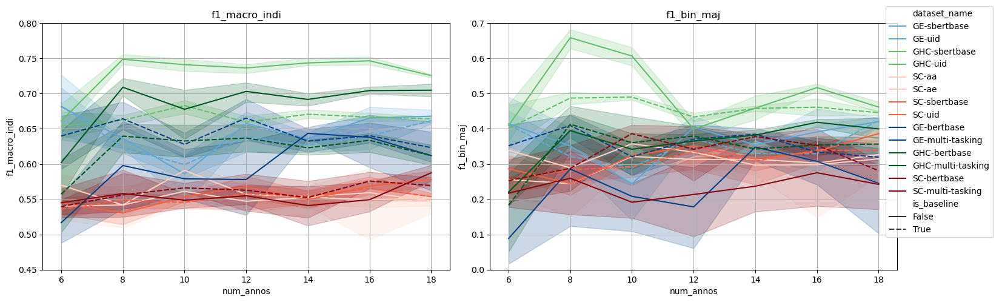

In [826]:
plot_f1s_multi_df(all_explo_res_18, on_y='two', exclude_models_list=['anchor','v2'])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_10691/1155497814.py:125: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


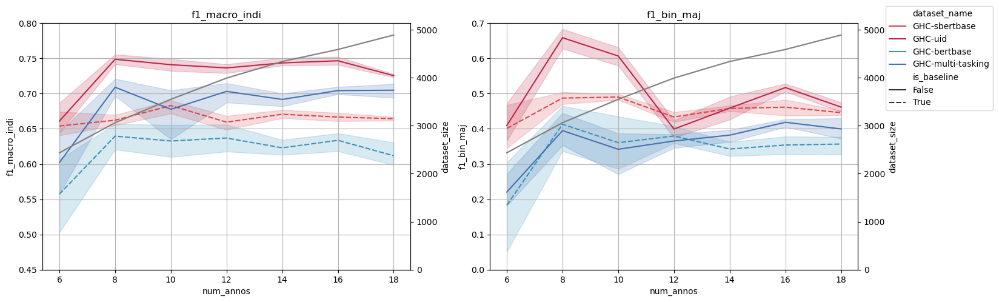

In [1169]:
plot_f1s_multi_df(all_explo_res_18, on_y='two', only_ds='GHC')

In [949]:
# time plot needs to be done newly
# plot_train_time_multi_df(all_explo_res_18, per='sample')

In [884]:
# fig, ax = plt.subplots(figsize = (7, 4))
# plt.title('Mean Millis per epoch per annotation (two y scales)')
# ax2 = ax.twinx()

# p1 = sns.lineplot(
#     data=all_explo_res_18[all_explo_res_18.dataset_name.isin(['GHC','GE','sc-multi-tasking'])], 
#     x=all_explo_res_18.num_annos,
#     y='mean_train_millis_per_annotation',
#     hue='dataset_name',
#     palette=['orange', 'g', 'r'],
#     ax=ax)

# p2 = sns.lineplot(
#     data=all_explo_res_18[all_explo_res_18.dataset_name=='SC_AE'], 
#     x=all_explo_res_18.num_annos,
#     y='mean_train_millis_per_annotation',
#     hue='dataset_name',
#     ax=ax2,
#     palette=['b'])

# sns.move_legend(ax, "upper left", bbox_to_anchor=(1.15, 1))
# sns.move_legend(ax2, "upper left", bbox_to_anchor=(1.15, 0.7))


## 6 - 82 Annotators: GE, SC

In [109]:
all_explo_res_82, missing = get_all_res_as_df(82, ignore_list=['multi-tasking-sbert','anchor','MD','GE-'])
all_explo_res_82_all = all_explo_res_82.copy()
all_explo_res_82 = all_explo_res_82[~all_explo_res_82.dataset_name.str.contains("'")]
all_explo_res_82_all = all_explo_res_82_all[~all_explo_res_82_all.dataset_name.str.contains('GE-')] # remove old GE runs.
all_explo_res_82_all.to_csv('../data/all_expo_res_82_all.csv')

In [ ]:
all_explo_res_82

In [54]:
all_explo_res_82 = pd.read_csv('../data/all_expo_res_82.csv')
all_explo_res_82_all = pd.read_csv('../data/all_expo_res_82_all.csv') 

In [148]:
# def replace_names(name):
#     replace_dict = {
#         '6-3-38-5': '38-5',
#         'anchorv2': 'anchor-v2',
#         'v2': 'downsized',
#         'v3': 'logits-shared-layer',
#         'v4': 'logits'
#     }
#     for key, val in replace_dict.items():
#         name = name.replace(key, val)
        
#     return name

In [240]:
# all_explo_res_82.dataset_name = all_explo_res_82.dataset_name.map(lambda x: replace_names(x))

In [51]:
#all_explo_res_82_anchors = get_all_res_as_df(82, only_df='anchor')
# all_explo_res_82 = pd.concat([all_explo_res_82, all_explo_res_82_anchors])
# all_explo_res_82.to_csv('../data/all_expo_res_82.csv')

In [118]:
all_explo_res_82_mean = get_means_of_folds(all_explo_res_82.drop(columns=['model','ds_name']))

In [113]:
# mean of GE
model_names = ['bertbase', 'multi-tasking-sbert', 'multi-tasking', 'sbertbase', 'uid']
all_explo_res_82_ge_rm_emotion = all_explo_res_82_all[all_explo_res_82_all.dataset_name.str.contains('GE')].copy()
for m_name in model_names:
    all_explo_res_82_ge_rm_emotion.loc[all_explo_res_82_ge_rm_emotion.dataset_name.str.contains(f"-{m_name}"),'dataset_name'] = f'GE_all_mean-{m_name}'

all_explo_res_ge_82_mean = rm_emos_to_mean_df(all_explo_res_82_ge_rm_emotion)

In [114]:
all_explo_res_82 = pd.concat([all_explo_res_82[~all_explo_res_82.dataset_name.str.contains('GE')], all_explo_res_ge_82_mean], axis=0)
all_explo_res_82.to_csv('../data/all_expo_res_82.csv')

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_76067/4170892482.py:166: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


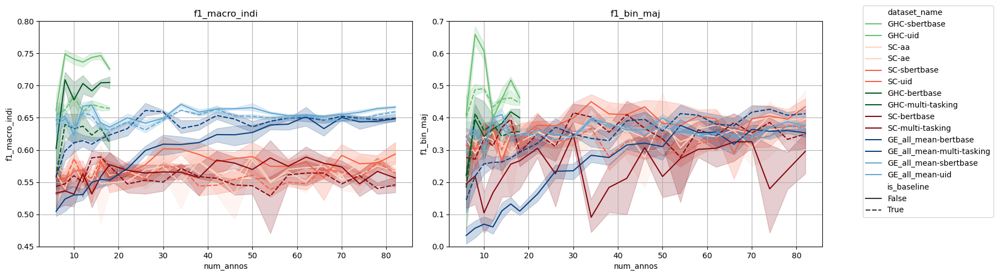

In [116]:
plot_f1s_multi_df(all_explo_res_82, on_y='two', exclude_models_list=['anchor','downsized'])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_4051/36426642.py:140: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_4051/36426642.py:140: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_4051/36426642.py:140:

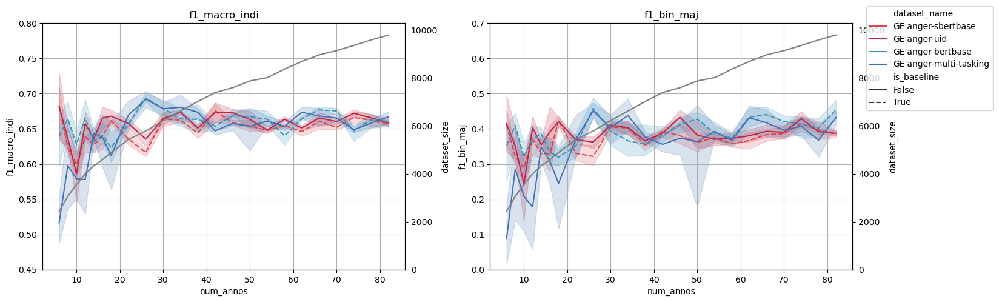

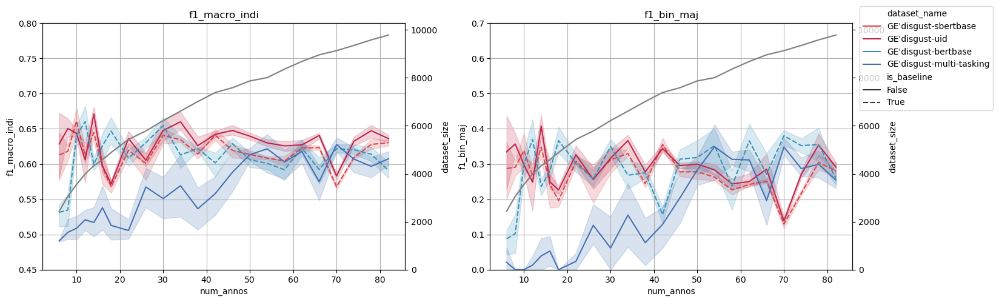

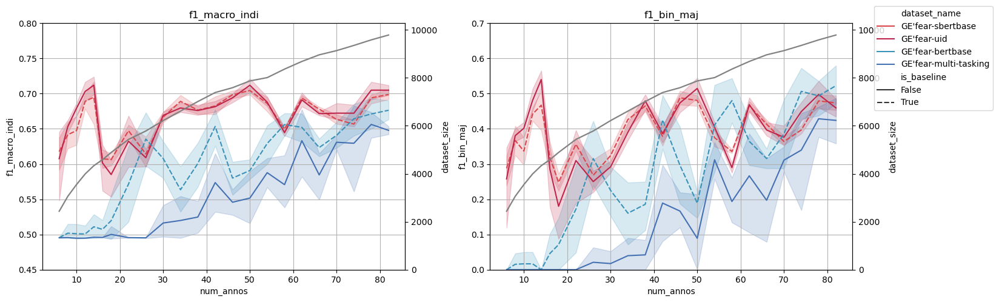

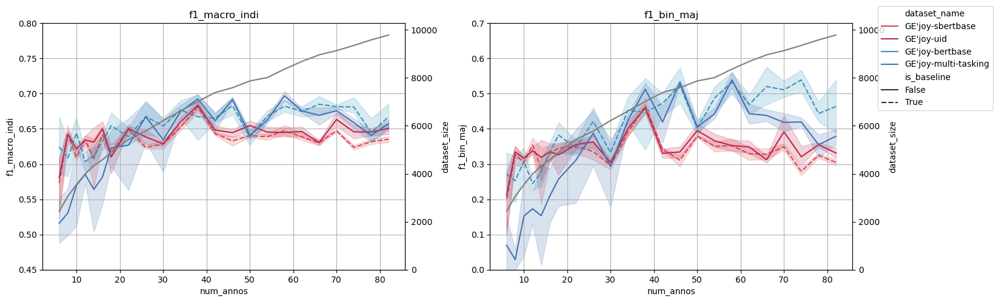

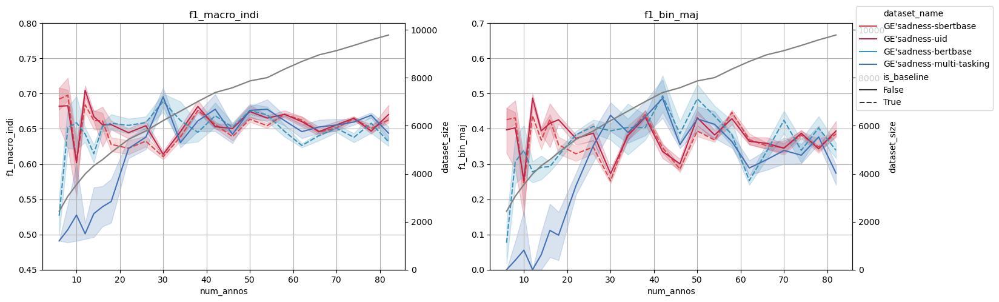

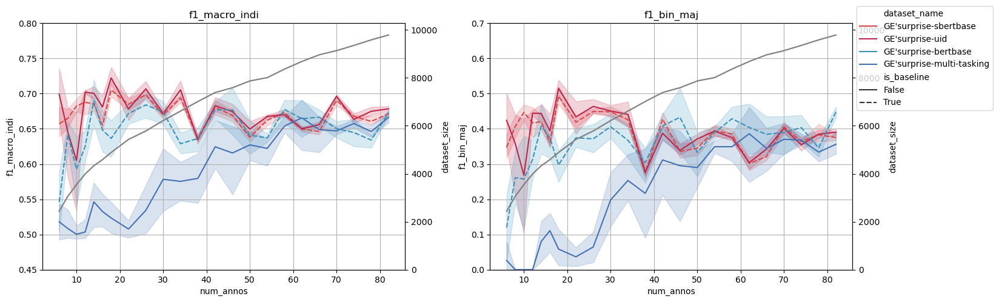

In [128]:
for emotion in emotions:
    plot_f1s_multi_df(all_explo_res_82_all, on_y='two', only_ds=f"GE'{emotion}")

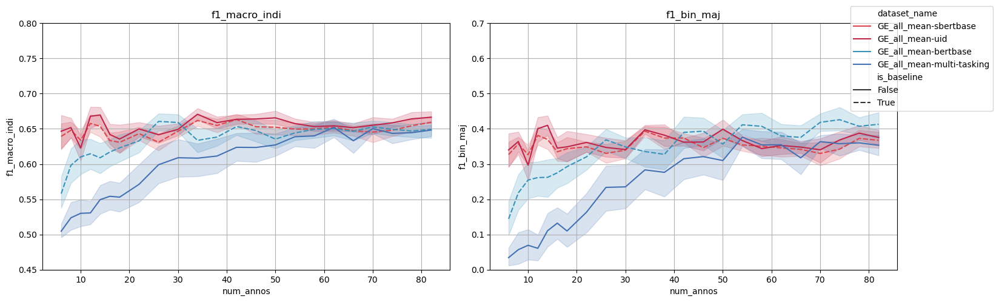

In [36]:
plot_f1s_multi_df(all_explo_res_82_ge_rm_emotion, on_y='two', only_ds=f"GE_all_mean", plot_data_count=False)

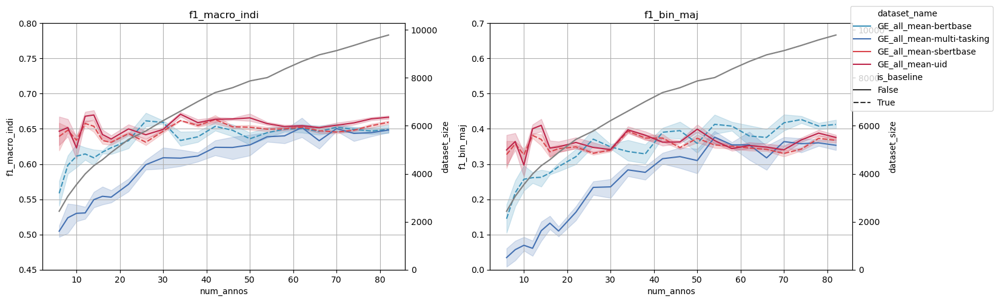

In [130]:
plot_f1s_multi_df(all_explo_res_ge_82_mean, on_y='two', only_ds=f"GE_all_mean")

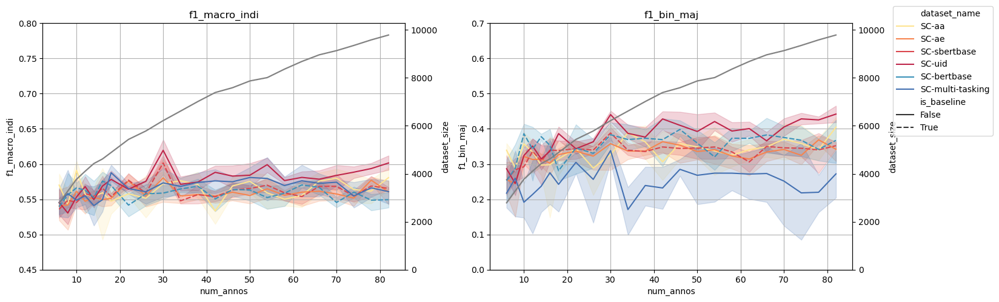

In [88]:
plot_f1s_multi_df(all_explo_res_82, on_y='two', only_ds='SC', exclude_models_list=['anchor','v2'])

In [60]:
set(all_explo_res_82_mean.dataset_name)

{'SC-multi-tasking-aa-anchor-v2-38-5',
 'SC-multi-tasking-aa-anchor-v2-6-3',
 'SC-multi-tasking-aa-anchor-v3-38-5',
 'SC-multi-tasking-aa-anchor-v3-6-3',
 'SC-multi-tasking-aa-anchor-v4-38-5',
 'SC-multi-tasking-aa-anchor-v4-6-3'}

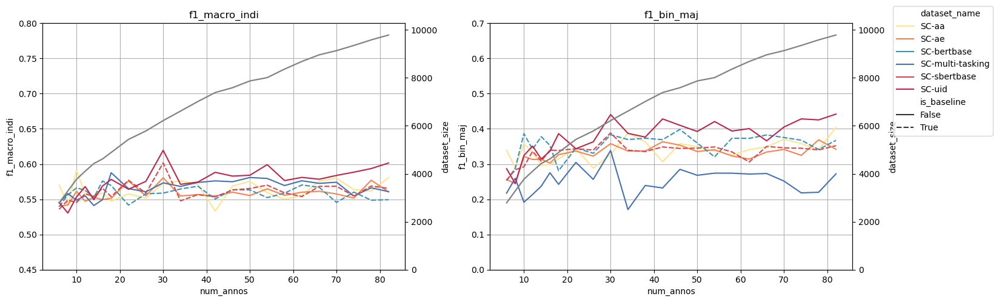

In [125]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC', exclude_models_list=['anchor','v2'])

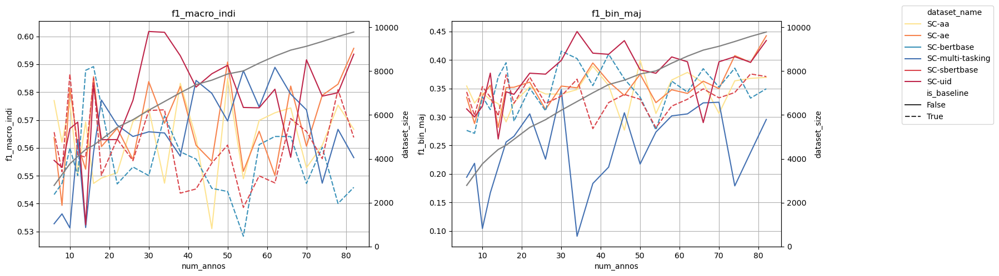

In [134]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, exclude_models_list=['anchor','v2', 'downsized'])

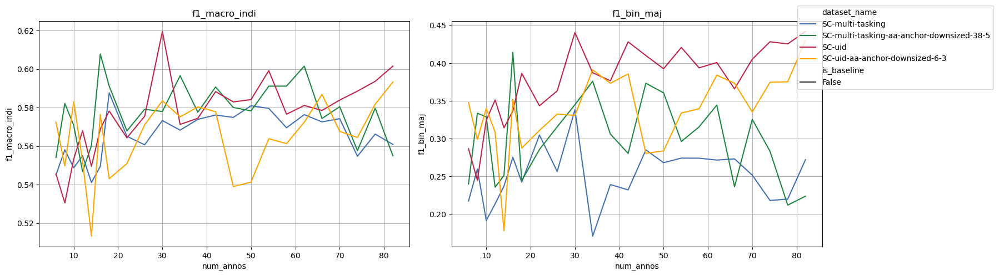

In [58]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, color_schema_auto=False, plot_data_count=False, select_models_list=['multi-tasking','uid'], exclude_models_list=['multi-tasking-downsized','logits', 'multi-tasking-aa-anchor-downsized-6'])

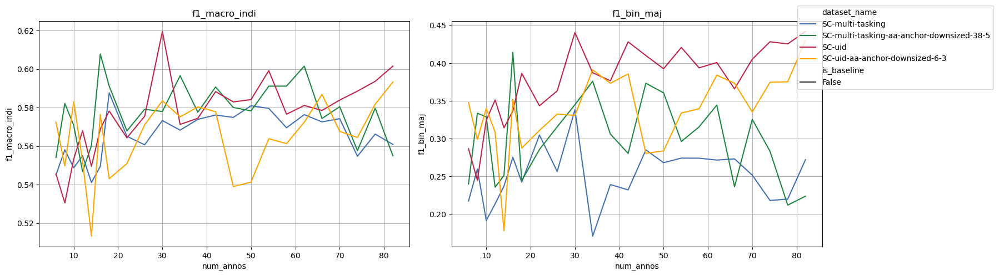

In [186]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, color_schema_auto=False, plot_data_count=False, select_models_list=['multi-tasking','uid'], exclude_models_list=['multi-tasking-downsized','logits', 'multi-tasking-aa-anchor-downsized-6'])

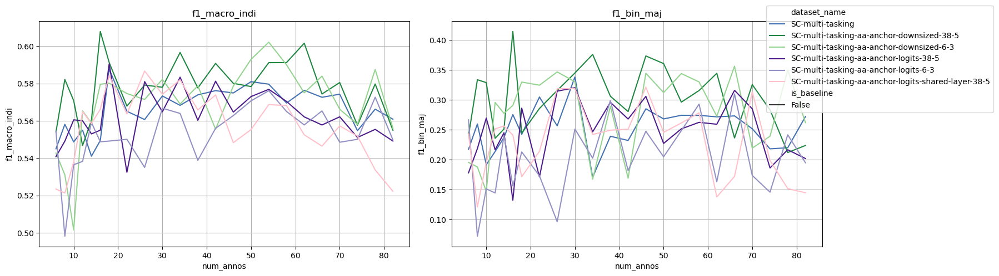

In [184]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, color_schema_auto=False, select_models_list=['multi-tasking'], exclude_models_list=['multi-tasking-downsized'], plot_data_count=False)

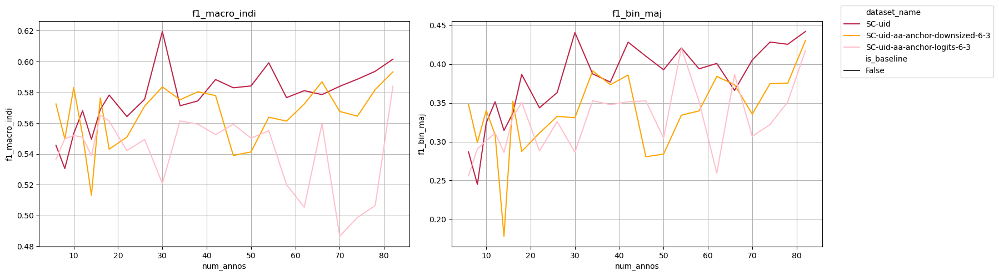

In [183]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, color_schema_auto=False, select_models_list=['uid'], exclude_models_list=[], plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_9869/3756919683.py:166: UserWarning: The palette list has more values (10) than needed (9), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_9869/3756919683.py:166: UserWarning: The palette list has more values (10) than needed (9), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])


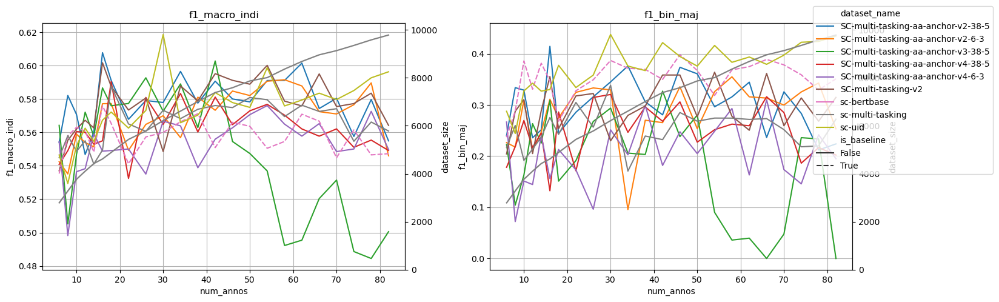

In [74]:
plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, color_schema_auto=True, select_models_list=['multi-tasking','uid','sc-bert'], exclude_models_list=['basic', '12'])

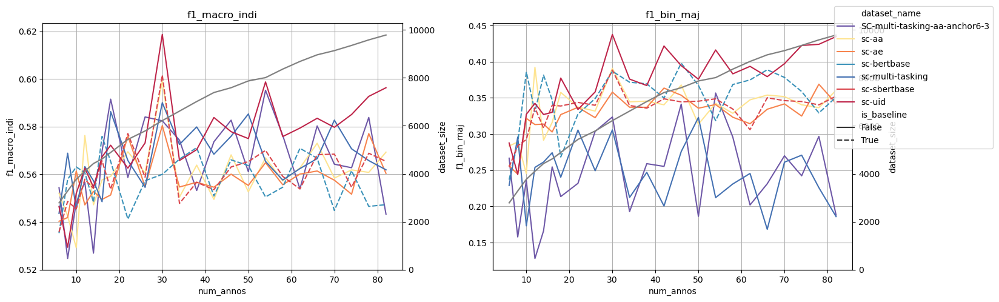

In [80]:
# plot_f1s_multi_df(all_explo_res_82_mean, on_y='two', only_ds='SC',fixed_y_axis=False, color_schema_auto=False, select_models_list=['multi-tasking','aa','ae','uid','bert'], exclude_models_list=['basic','12','38'])

## 6 - 82 Annotators: GE: full

In [105]:
# all_explo_res_82_full = get_all_res_as_df(82, path_to_models_runs='../results/ge_ghc_full_ds_scalability/')
# all_explo_res_82_full_all = all_explo_res_82_full.copy()
# all_explo_res_82_full = all_explo_res_82_full[~all_explo_res_82_full.dataset_name.str.contains("'")]
# all_explo_res_82_full_all = all_explo_res_82_full_all[~all_explo_res_82_full_all.dataset_name.str.contains('GE-')] # remove old GE runs.
# all_explo_res_82_full_all.to_csv('../data/all_expo_res_82_full_all.csv')

AttributeError: 'tuple' object has no attribute 'copy'

In [25]:
all_explo_res_82_full = pd.read_csv('../data/all_expo_res_82_full.csv')
all_explo_res_82_full_all = pd.read_csv('../data/all_expo_res_82_full_all.csv')

In [26]:
all_explo_res_82_full_mean = get_means_of_folds(all_explo_res_82_full.drop(columns=['model','ds_name']))

In [27]:
# mean of GE
all_explo_res_82_full_ge_rm_emotion = all_explo_res_82_full_all[all_explo_res_82_full_all.dataset_name.str.contains('GE')].copy()
for m_name in model_names:
    all_explo_res_82_full_ge_rm_emotion.loc[all_explo_res_82_full_ge_rm_emotion.dataset_name.str.contains(f"-{m_name}"),'dataset_name'] = f'GE_all_mean-{m_name}'

all_explo_res_ge_82_full_mean = rm_emos_to_mean_df(all_explo_res_82_full_ge_rm_emotion)

In [22]:
# all_explo_res_82_full = pd.concat([all_explo_res_82_full[~all_explo_res_82_full.dataset_name.str.contains('GE')], all_explo_res_ge_82_full_mean], axis=0)
# all_explo_res_82_full.to_csv('../data/all_expo_res_82_full.csv')

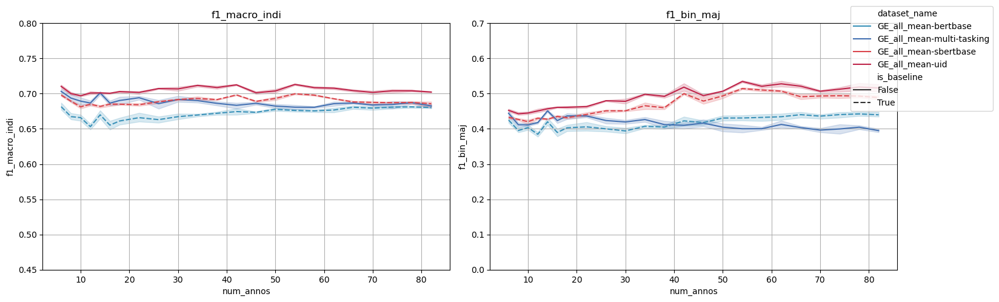

In [23]:
plot_f1s_multi_df(all_explo_res_82_full, on_y='two', only_ds='GE_all', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_10691/3294511618.py:117: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_10691/3294511618.py:117: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_10691/329451161

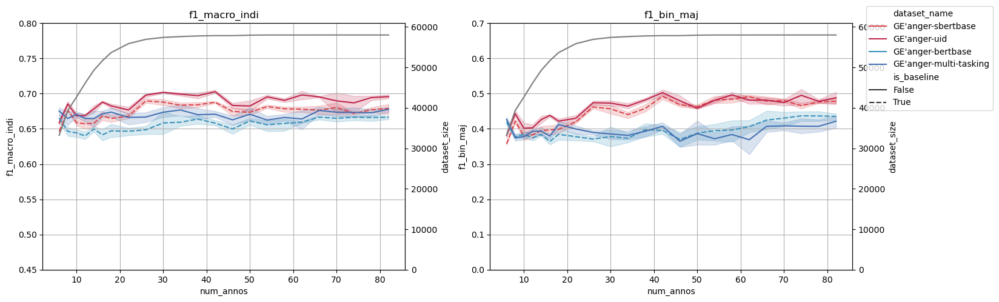

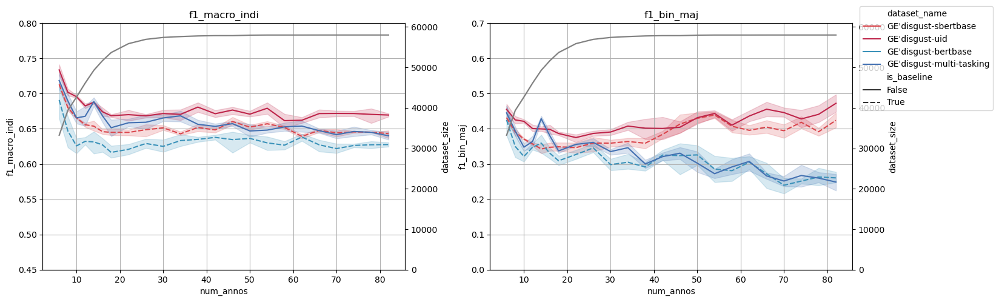

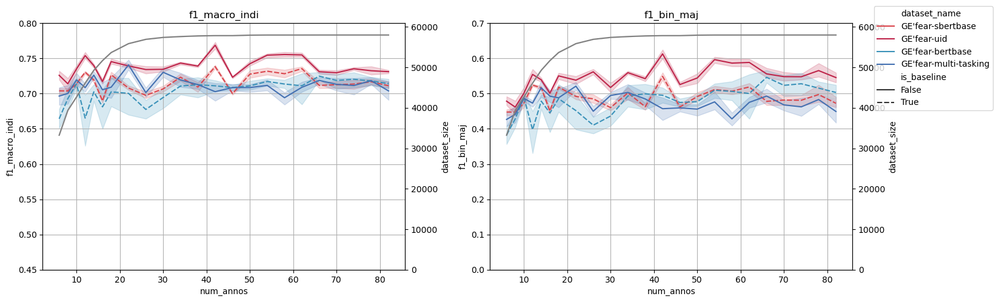

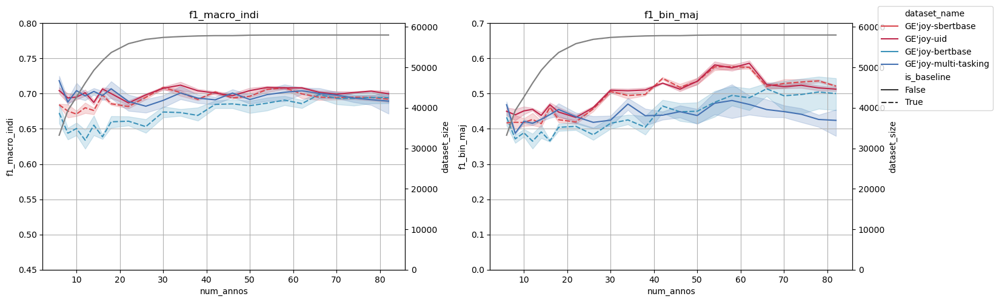

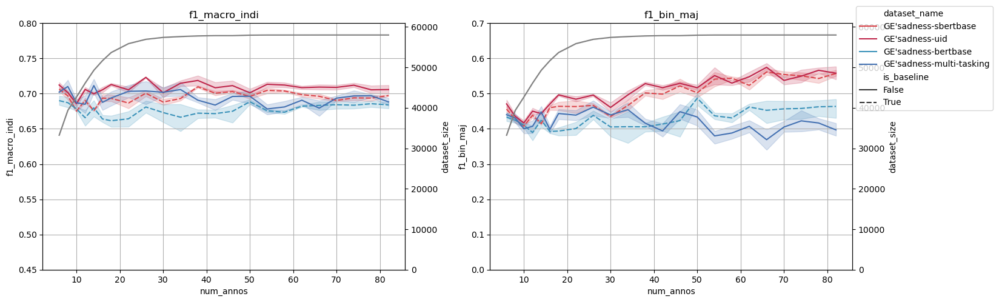

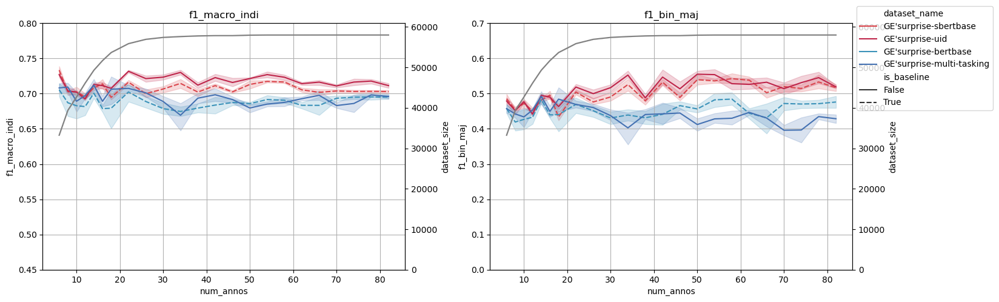

In [1118]:
for emotion in emotions:
    plot_f1s_multi_df(all_explo_res_82_full_all, on_y='two', only_ds=f"GE'{emotion}")

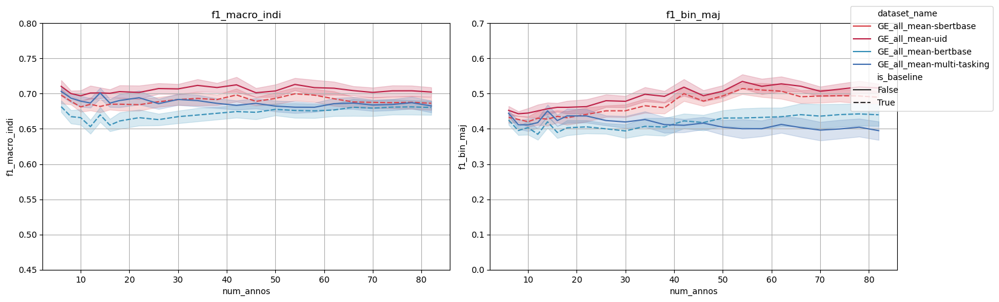

In [28]:
plot_f1s_multi_df(all_explo_res_82_full_ge_rm_emotion, on_y='two', only_ds=f"GE_all_mean", plot_data_count=False)

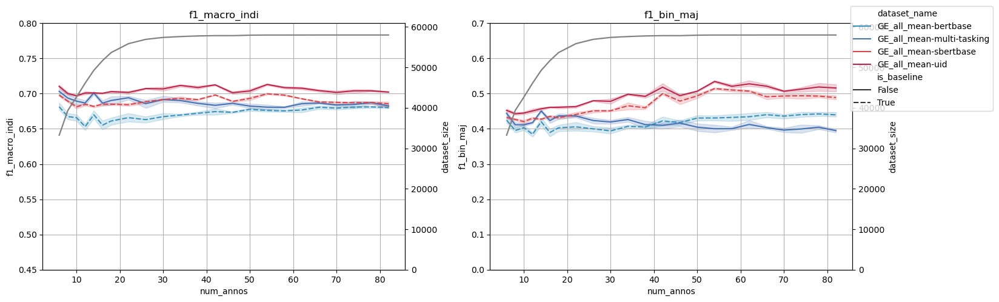

In [1120]:
plot_f1s_multi_df(all_explo_res_ge_82_full_mean, on_y='two', only_ds=f"GE_all_mean")

## 82 - 2500 Annotators: SC: AA-personalization  VS   Multi-Task

In [129]:
all_explo_res_2500, missing_2500 = get_all_res_as_df(2500, only_df='sc', ignore_list=['multi-tasking-sbert','anchor','downsized']) # sc are old runs

SC-bertbase_2200_annos
None
____________________________________________________________________________________________________
[Errno 2] No such file or directory: '../results/multi_scalability_0/SC-bertbase_2200_annos/model_results.json'
____________________________________________________________________________________________________
Traceback (most recent call last):
  File "/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_76067/519210451.py", line 76, in get_multi_runs_res_df
    res_df = return_results_df(path_to_runs, run)
        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_76067/3189043158.py", line 22, in return_results_df
    with open(path_to_res, 'r') as file:
         ^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/belaneuendorf/mambaforge/envs/master/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 284, in _modified_open
    return io_open(file, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^

In [30]:
# all_explo_res_2500.to_csv('../data/all_expo_res_2500.csv')

In [18]:
# all_explo_res_2500 = pd.read_csv('../data/all_expo_res_2500.csv', index_col=0)

In [190]:
# all_explo_res_2500_anchor, missing_2500_anchor = get_all_res_as_df(2500, only_df='anchorv2')

In [38]:
# all_explo_res_2500_anchor[(all_explo_res_2500_anchor.dataset_name.str.contains('v4'))&(all_explo_res_2500_anchor.num_annos>=1000)][['dataset_name','f1_macro_indi','num_annos','fold']].sort_values(by=['num_annos','fold'])

In [543]:
# all_explo_res_2500 = pd.concat([all_explo_res_2500, all_explo_res_2500_anchor])

In [130]:
all_explo_res_2500_mean = get_means_of_folds(all_explo_res_2500.drop(columns=['model','ds_name']))

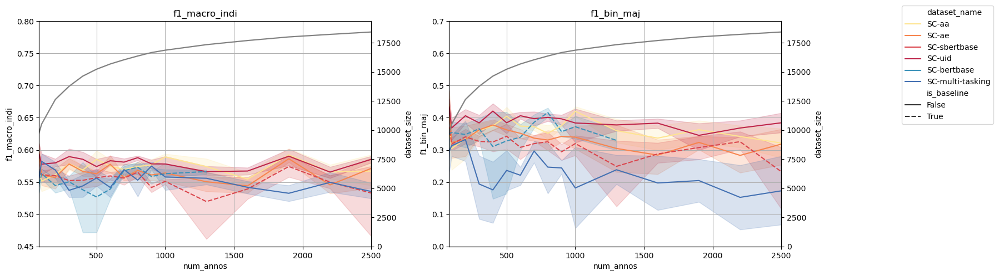

In [124]:
plot_f1s_multi_df(all_explo_res_2500, on_y='two', only_ds='SC', set_x_range=(82,2500), exclude_models_list=['anchor', 'downsized'])

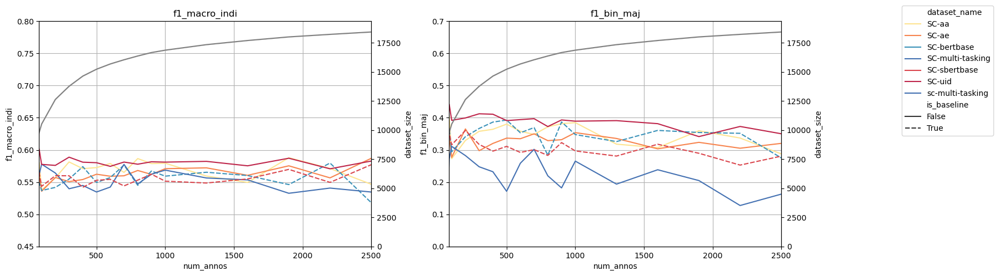

In [194]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC', set_x_range=(82,2500), exclude_models_list=['anchor','downsized'])

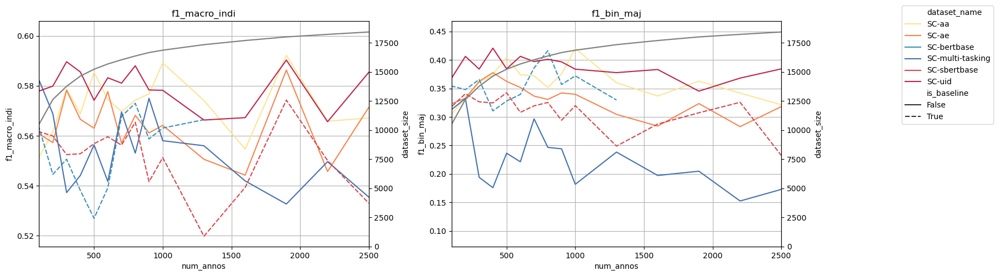

In [133]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC', set_x_range=(100,2500), exclude_models_list=['anchor', 'downsized'], fixed_y_axis=False)

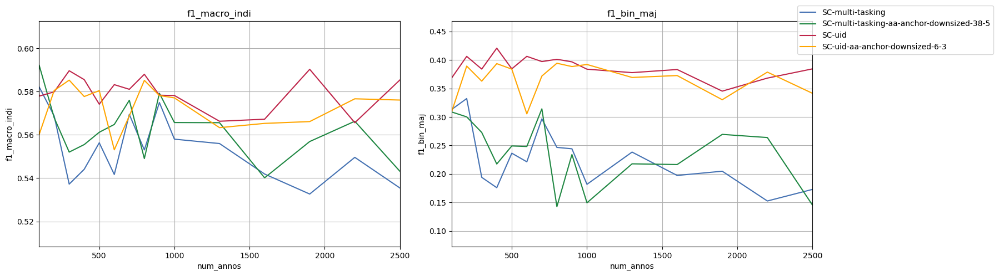

In [126]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, no_style=True, color_schema_auto=False, set_x_range=(100,2500), plot_data_count=False, select_models_list=['multi-tasking','uid'], exclude_models_list=['multi-tasking-downsized','logits', 'multi-tasking-aa-anchor-downsized-6'])

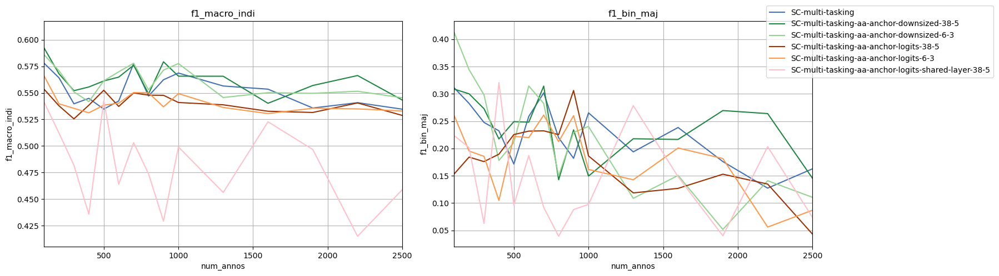

In [48]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, no_style=True, color_schema_auto=False, set_x_range=(100,2500), select_models_list=['multi-tasking'], exclude_models_list=['multi-tasking-downsized'], plot_data_count=False)

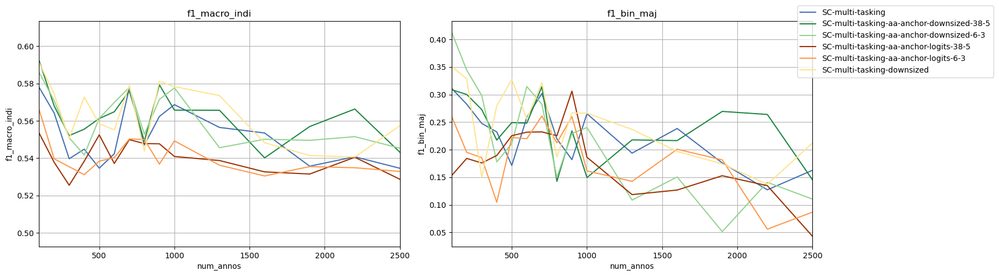

In [49]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, no_style=True, color_schema_auto=False, set_x_range=(100,2500), select_models_list=['multi-tasking'], exclude_models_list=['shared'], plot_data_count=False)

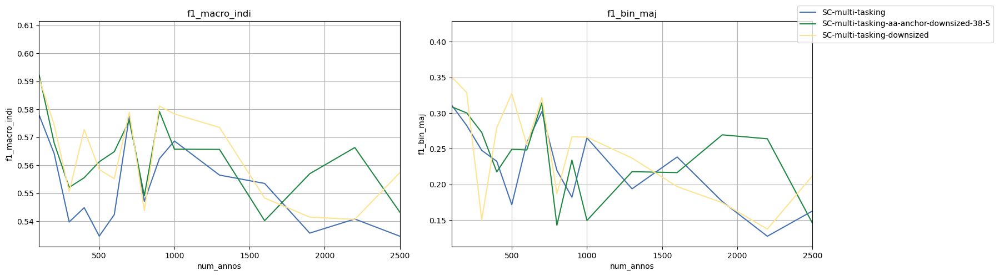

In [50]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, no_style=True, color_schema_auto=False, set_x_range=(100,2500), select_models_list=['multi-tasking'], exclude_models_list=['shared','logits','6-3'], plot_data_count=False)

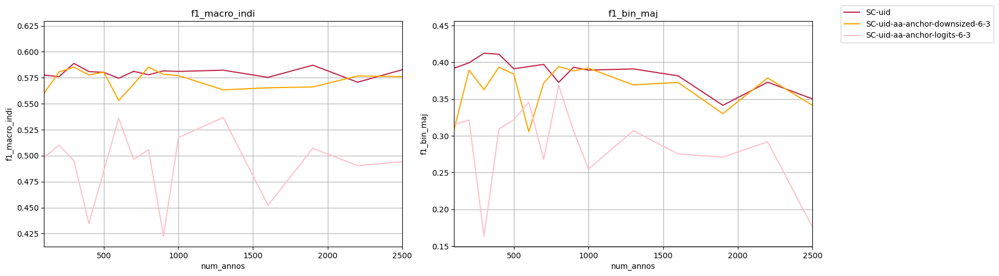

In [53]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, no_style=True, color_schema_auto=False, set_x_range=(100,2500), select_models_list=['uid'], exclude_models_list=[], plot_data_count=False)

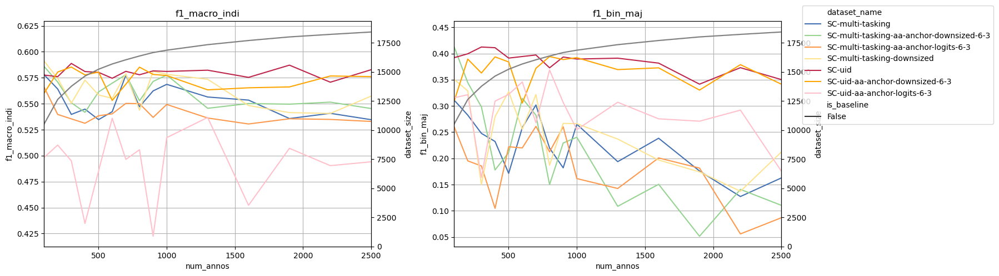

In [52]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, set_x_range=(100,2500), exclude_models_list=['v3','38'], select_models_list=['uid','multi'])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_9869/3266369305.py:166: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_9869/3266369305.py:166: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])


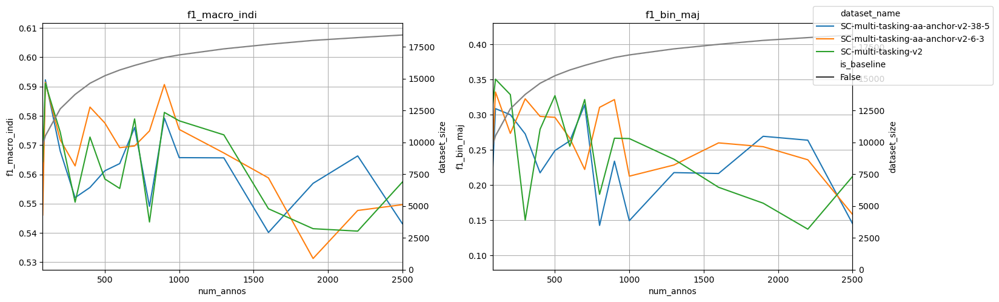

In [189]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, set_x_range=(82,2500), color_schema_auto=True, select_models_list=['v2'])

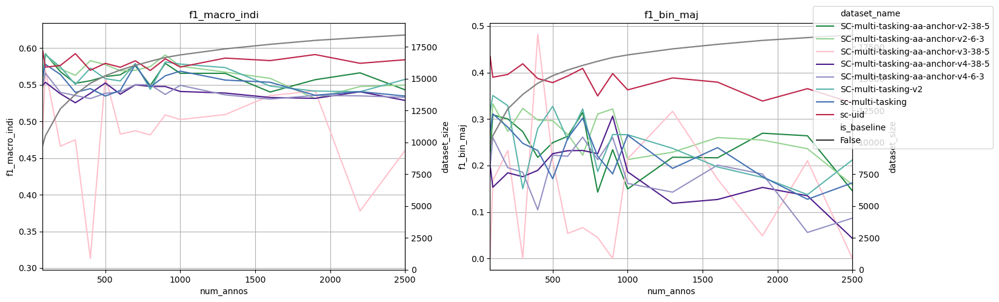

In [190]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, set_x_range=(82,2500), color_schema_auto=False, exclude_models_list=['v3-6'], select_models_list=['multi-tasking', 'uid'])

In [73]:
all_explo_res_2500_mean[all_explo_res_2500_mean.dataset_name.str.contains('38')].groupby('num_annos').get_group(1300)

,dataset_name,num_annos,dataset_size,number_annotations,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,test_acc_maj,test_acc_indi,mean_train_millis,mean_train_millis_per_annotation,mean_train_millis_per_sample,mean_eval_millis_per_annotation,mean_test_millis_per_annotation,sum_all_millis,annotations_per_anno,comment_percentage,learning_rate,fold
71,SC-multi-tasking-aa-anchor38-5,1300,17343.0,87221.0,0.16604,0.487356,0.305044,0.54887,0.691307,0.682843,842680.038725,9.661435,48.589058,1.908639,<NA>,3343644.40832,NaN,NaN,NaN,2.0
147,SC-multi-tasking-aa-v2-anchor38-5,1300,17343.0,87221.0,0.16604,0.487356,0.305044,0.54887,0.691307,0.682843,689376.642023,7.903792,39.749561,1.605118,<NA>,2787554.285034,NaN,NaN,NaN,2.0


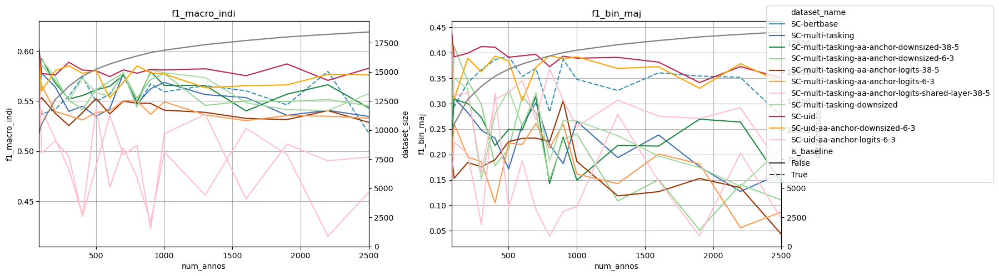

In [37]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, set_x_range=(82,2500), color_schema_auto=False, select_models_list=['multi-tasking', 'uid', 'sc-bert'], exclude_models_list=['basic','12'])

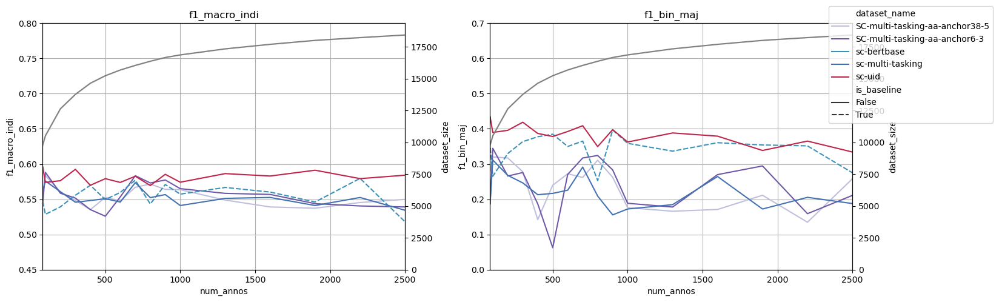

In [101]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=True, set_x_range=(82,2500), color_schema_auto=False, select_models_list=['multi-tasking', 'uid', 'sc-bert'], exclude_models_list=['basic','12'])

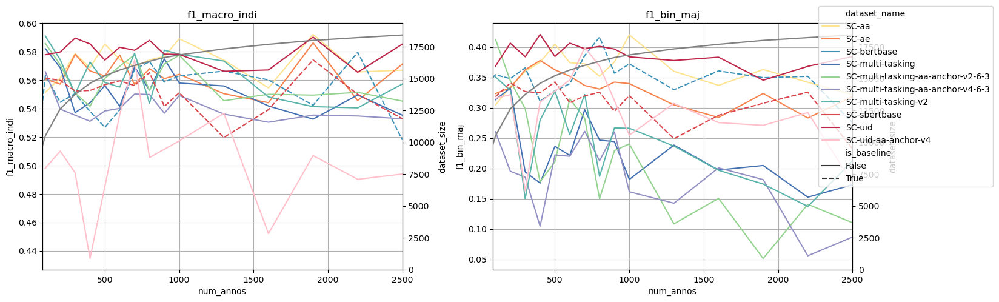

In [605]:
plot_f1s_multi_df(all_explo_res_2500_mean, on_y='two', only_ds='SC',fixed_y_axis=False, set_x_range=(82,2500), color_schema_auto=False, select_models_list=['multi-tasking','aa','ae','uid','bert'], exclude_models_list=['basic','12','38'])

In [60]:
set(all_explo_res_2500[all_explo_res_2500.dataset_name == 'sc-uid'].fold)

{0, 1, 3, 4}

In [643]:
all_explo_res_2500[(all_explo_res_2500.dataset_name.str.contains('SC')) & (all_explo_res_2500.num_annos == 1000) & (all_explo_res_2500.fold == 0)][['dataset_name','num_annos','mean_train_millis','mean_train_millis_per_sample','number_annotations']]

,dataset_name,num_annos,mean_train_millis,mean_train_millis_per_sample,number_annotations
1,SC-uid-aa-anchor-v4,1000,4135226.047087,245.152125,77295
48,SC-aa,1000,500022.3461,29.64325,77295
49,SC-ae,1000,498987.777882,29.581917,77295
50,SC-sbertbase,1000,496632.99973,29.442317,77295
51,SC-uid,1000,497012.788409,29.464832,77295
362,SC-multi-tasking-aa-anchor-v2-38-5,1000,696276.76588,41.277968,77207
390,SC-multi-tasking-aa-anchor-v2-6-3,1000,769173.280947,45.599554,77207
400,SC-multi-tasking-v2,1000,434061.849729,25.732858,77207
411,SC-multi-tasking-aa-anchor-v3-38-5,1000,1984084.420562,117.624165,77207
427,SC-multi-tasking-aa-anchor-v4-38-5,1000,2892192.336504,171.4603,77207


/tmp/ipykernel_2866700/2463702530.py:292: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[y_new] = df[y] / 1000 / 60


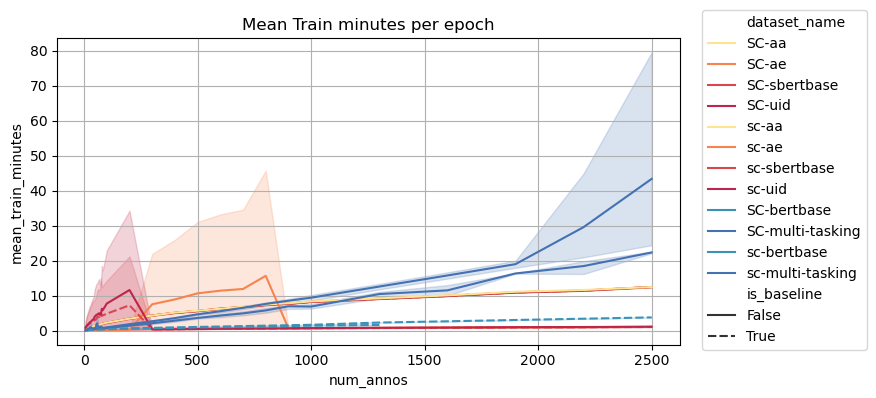

In [27]:
plot_train_time_multi_df(all_explo_res_2500, per='epoch', exclude_models_list=['anchor','downsized'])

KeyError: 'SC-multi-tasking-downsized'

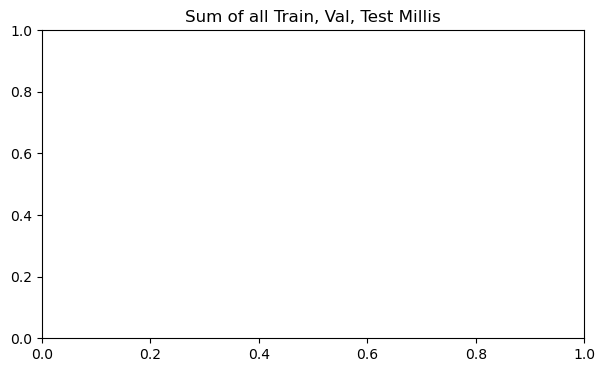

In [21]:
plot_train_time_multi_df(all_explo_res_2500, per='all', exclude_models_list=['anchor','v2'])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/2628304177.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[y_new] = df[y] / 1000 / 60


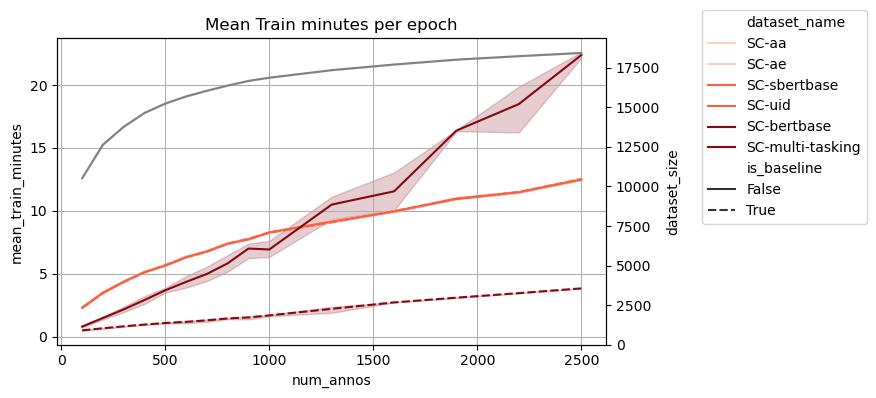

In [714]:
plot_train_time_multi_df(all_explo_res_2500, per='epoch', exclude_models_list=['anchor','v2'], plot_data_count=True)

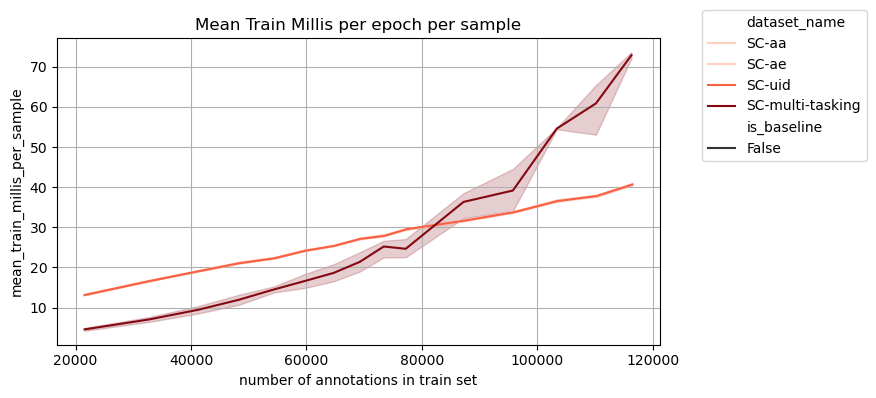

In [738]:
plot_train_time_multi_df(all_explo_res_2500, per='sample', exclude_models_list=['anchor','v2','bertbase'], annotation_as_x=True)

In [ ]:
all_explo_res_2500

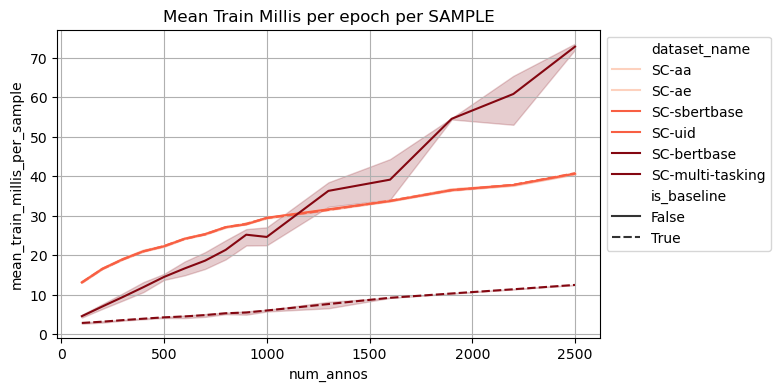

In [571]:
plot_train_time_multi_df(all_explo_res_2500, per='sample', exclude_models_list=['anchor','v2'])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/4220143623.py:258: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[y_new] = df[y] / df['number_annotations']


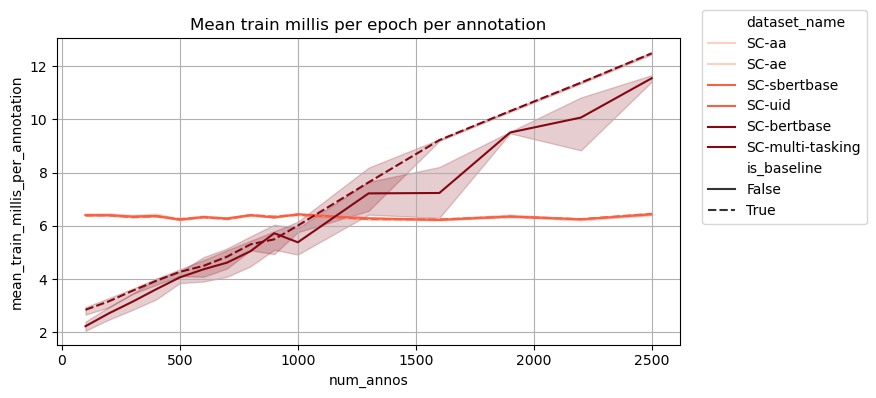

In [709]:
# these makes no sense I think,should be similar to per sample. since the number of annotations is the same for mt and or uid
# probably mistake in saving the number of samples of sth.
plot_train_time_multi_df(all_explo_res_2500, per='annotation', exclude_models_list=['anchor','v2','bertbase'])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/2904720221.py:264: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[y_new] = df[y] / df['dataset_size']


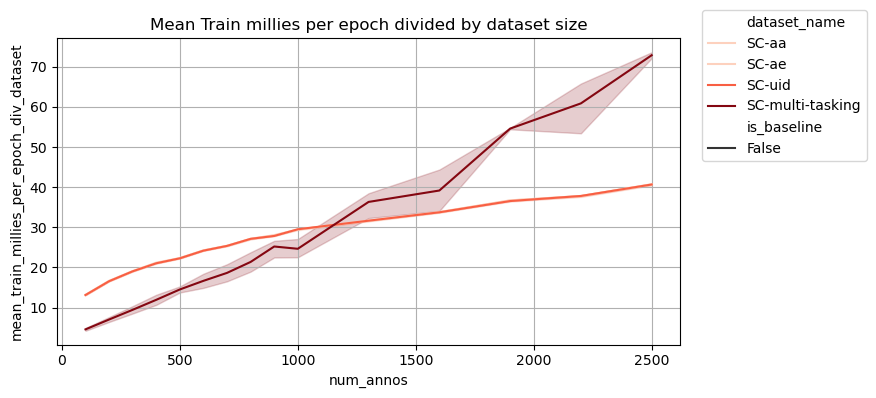

In [618]:
plot_train_time_multi_df(all_explo_res_2500, per='epoch_by_num_samples', exclude_models_list=['anchor','v2','bertbase'])

In [667]:
mt_filtered_2500_sc = all_explo_res_2500[(all_explo_res_2500.dataset_name=='SC-multi-tasking')][['dataset_name','num_annos','mean_train_millis','mean_train_millis_per_sample','number_annotations']]

In [668]:
mt_filtered_2500_sc_x = mt_filtered_2500_sc.num_annos
mt_filtered_2500_sc_y = mt_filtered_2500_sc.mean_train_millis_per_sample

In [669]:
uid_filtered_2500_sc = all_explo_res_2500[(all_explo_res_2500.dataset_name=='SC-uid')][['dataset_name','num_annos','mean_train_millis','mean_train_millis_per_sample','number_annotations']]

In [670]:
uid_filtered_2500_sc_x = uid_filtered_2500_sc.num_annos
uid_filtered_2500_sc_y = uid_filtered_2500_sc.mean_train_millis_per_sample

In [708]:
from lmfit import Parameters,minimize, fit_report

for func in ['lin', 'pow', 'expo']:
    print('#' * 100)
    print(func)
    x = mt_filtered_2500_sc_x
    y = mt_filtered_2500_sc_y




    def linear_fitting_lmfit(params,x,y):
        a = params['a']
        c = params['c']
        y_fit = a*x + c
        return y_fit-y

    def power_fitting_lmfit(params,x,y):
        a = params['a']
        b = params['b']
        c = params['c']
        y_fit = a*(x**(b)) + c
        return y_fit-y

    def expo_fitting_lmfit(params,x,y):
        a = params['a']
        b = params['b']
        c = params['c']
        y_fit = a*(math.e**(x*b)) + c
        return y_fit-y

    if func == 'lin':
        params = Parameters()
        params.add('a', min=-10.0, max=20.0)
        params.add('c', value=0)
        
        fitted_params = minimize(linear_fitting_lmfit, params, args=(x,y,), method='least_squares')

        a = fitted_params.params['a'].value
        b = None
        c = fitted_params.params['c'].value   
        
    elif func == 'pow':
        params = Parameters()
        params.add('a', min=0.0, max=1.0)
        params.add('b', min=0.0, max=20.0)
        params.add('c', value=0)
        
        fitted_params = minimize(power_fitting_lmfit, params, args=(x,y,), method='least_squares')

        a = fitted_params.params['a'].value
        b = fitted_params.params['b'].value
        c = fitted_params.params['c'].value   
        
    elif func == 'expo':
        params = Parameters()
        params.add('a', min=0.0, max=10.0)
        params.add('b', min=0.0, max=1.0)
        params.add('c', value=0)
        
        fitted_params = minimize(expo_fitting_lmfit, params, args=(x,y,), method='least_squares')

        a = fitted_params.params['a'].value
        b = fitted_params.params['b'].value
        c = fitted_params.params['c'].value   
    

    print('a : ', a)
    print('b : ', b)
    print('c : ', c)
    print('The intercept (c) is ', c)
    
    y_preds = [a*(math.e**(x*b)) + c for x in x]

    # Pretty printing all the statistical data
    print(fit_report(fitted_params))
    R_suare = 1 - fitted_params.residual.var() / np.var(y)
    print(R_suare)
    print(scipy.stats.ttest_ind(list(y),y_preds))

####################################################################################################
lin
a :  0.027547086486164378
b :  None
c :  0.2261439244452048
The intercept (c) is  0.2261439244452048


TypeError: unsupported operand type(s) for *: 'int' and 'NoneType'

In [680]:
R_suare = 1 - fitted_params.residual.var() / np.var(y)
R_suare

0.9634737247248308

In [702]:
y_preds = [a*(math.e**(x*b)) + c for x in x]

In [706]:
y_preds = [a*(math.e**(x*b)) + c for x in x]
scipy.stats.ttest_ind(list(y),y_preds)

TtestResult(statistic=1.1488239466451035e-12, pvalue=0.999999999999085, df=142.0)

In [707]:
a,b,c

(9.999999999999998, 0.0008165610265523576, 0.1398576778328523)

## Multi-Domain

In [ ]:
all_explo_res_md, missing_md = get_all_res_as_df(2500, only_df='MD') # sc are old runs

In [144]:
all_explo_res_md_mean = get_means_of_folds(all_explo_res_md.drop(columns=['model','ds_name']))

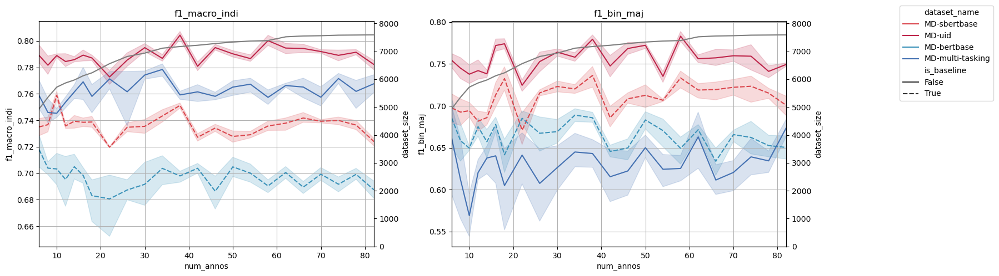

In [160]:
plot_f1s_multi_df(all_explo_res_md, only_ds='MD', on_y='two', fixed_y_axis=False, set_x_range=[6,82])

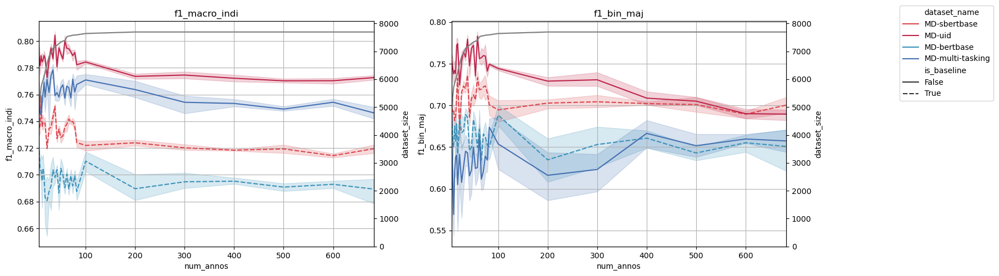

In [162]:
plot_f1s_multi_df(all_explo_res_md, only_ds='MD', on_y='two', fixed_y_axis=False, set_x_range=(82,682))

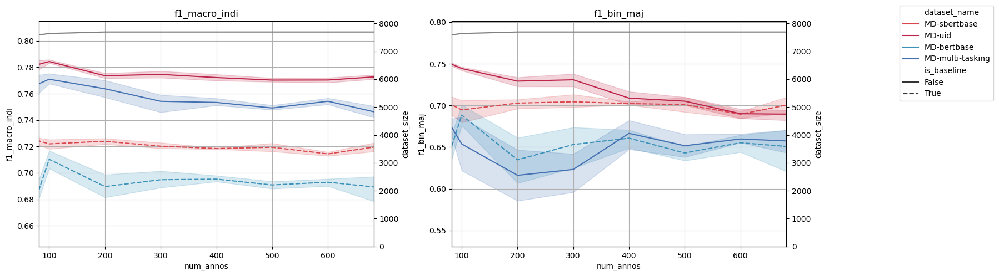

In [163]:
plot_f1s_multi_df(all_explo_res_md, only_ds='MD', on_y='two', fixed_y_axis=False, set_x_range=(82,682))

# scaling number of annotations per annotator exploration

In [1]:
# grouped_df = all_df.groupby(['split','majority']).count()
# grouped_df['split'] = [i[0] for i in grouped_df.index]
# grouped_df['majority'] = [i[1] for i in grouped_df.index]
# grouped_df

In [2]:
path_to_ge_ghc_data = f'../data/matching_sizes_data/'
path_to_multi_tasking_runs_comments_exploration = path_to_models_runs + 'SC_GE_GHC_comment_scalability/'

path_to_sc_data = '../data/sc_filtered_from_bela/'
path_to_personalization_runs_comments_exploration = '../../user_perception/results/comment_scalability/'

NameError: name 'path_to_models_runs' is not defined

In [20]:
def get_runs(path, max_annos=None):
    runs = [run for run in os.listdir(path) if re.findall(r'\d+', run)]
    if max_annos:
        runs = [run for run in runs if int(re.findall(r'\d+', run)[1]) == max_annos]
    runs = sorted(runs, key=lambda run: (int(re.findall(r'\d+', run)[0]), run.split('_')[0]))
    return runs

## 14 Annotators: GE, GHC, SC

In [83]:
# all_explo_res_14 = get_all_res_as_df(14, comments='comment_', ignore_list=['multi-tasking-sbert'])
# all_explo_res_14_all = all_explo_res_14.copy()
# all_explo_res_14 = all_explo_res_14[~all_explo_res_14.dataset_name.str.contains("'")]
# all_explo_res_14.to_csv('../data/all_explo_res_14.csv')
# all_explo_res_14_all = all_explo_res_14_all[~all_explo_res_14_all.dataset_name.str.contains('GE-')] # remove old GE runs.
# all_explo_res_14_all.to_csv('../data/all_explo_res_14_all.csv')

In [17]:
all_explo_res_14_all = pd.read_csv('../data/all_explo_res_14_all.csv')
all_explo_res_14 = pd.read_csv('../data/all_explo_res_14.csv')

In [18]:
all_explo_res_14_mean = get_means_of_folds(all_explo_res_14.drop(columns=['model','ds_name']), is_comments_df=True)

In [22]:
# mean of GE
all_explo_res_ge_14_rm_emotion = all_explo_res_14_all[all_explo_res_14_all.dataset_name.str.contains('GE')].copy()
for m_name in model_names:
    all_explo_res_ge_14_rm_emotion.loc[all_explo_res_ge_14_rm_emotion.dataset_name.str.contains(f"-{m_name}"),'dataset_name'] = f'GE_all_mean-{m_name}'
all_explo_res_ge_14_rm_emotion['annotations_per_anno'] = all_explo_res_ge_14_rm_emotion.groupby(['comment_percentage'])[['annotations_per_anno']].transform('mean').annotations_per_anno.round()

all_explo_res_ge_14_mean = rm_emos_to_mean_df(all_explo_res_ge_14_rm_emotion, is_comment_df=True)

In [153]:
sorted(list(set(all_explo_res_14[all_explo_res_14.dataset_name.str.contains('GE')].annotations_per_anno)))

[58.0,
 116.0,
 175.0,
 233.0,
 291.0,
 583.0,
 874.0,
 1166.0,
 1458.0,
 1749.0,
 2041.0,
 2332.0,
 2624.0,
 2916.0]

In [116]:
# all_explo_res_14 = pd.concat([all_explo_res_14[~all_explo_res_14.dataset_name.str.contains('GE')], all_explo_res_ge_14_mean])
# all_explo_res_14.to_csv('../data/all_explo_res_14.csv')

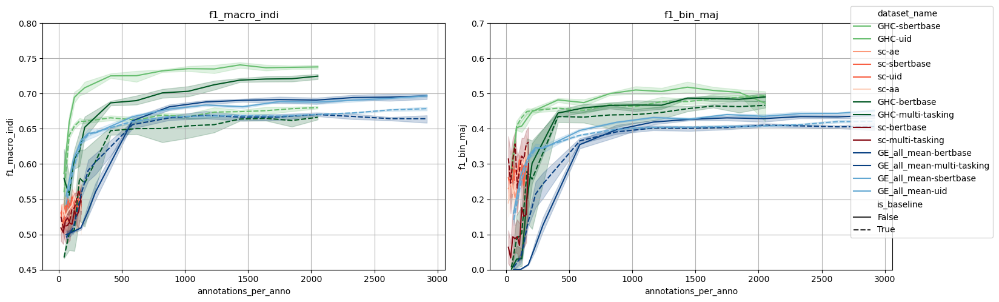

In [107]:
plot_f1s_multi_df(all_explo_res_14, on_x='annotations_per_anno', on_y='two')

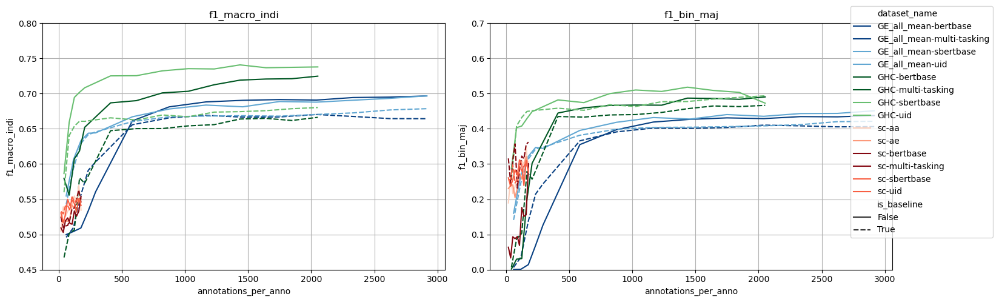

In [108]:
plot_f1s_multi_df(all_explo_res_14_mean, on_x='annotations_per_anno', on_y='two')

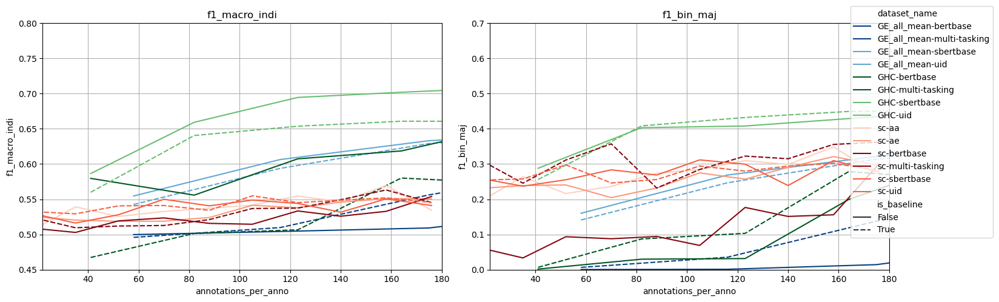

In [109]:
plot_f1s_multi_df(all_explo_res_14_mean, on_x='annotations_per_anno', on_y='two', set_x_range=(22,180))

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_9869/3756919683.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


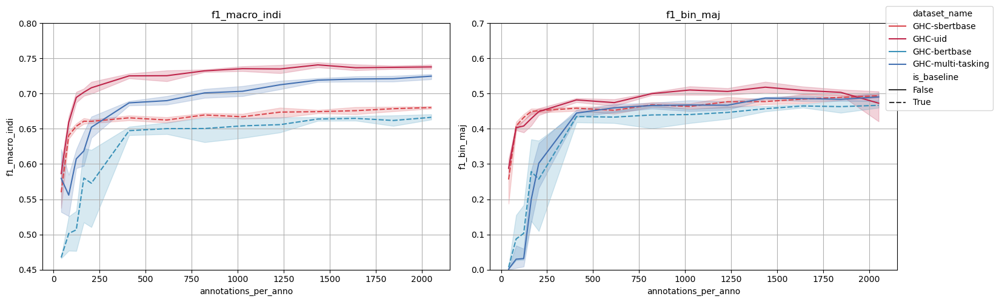

In [150]:
plot_f1s_multi_df(all_explo_res_14, on_x='annotations_per_anno', on_y='two', only_ds='GHC', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_29468/3984906497.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


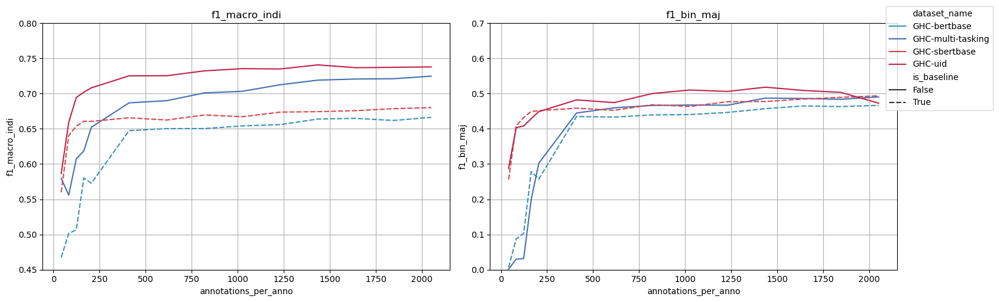

In [115]:
plot_f1s_multi_df(all_explo_res_14_mean, on_x='annotations_per_anno', on_y='two', only_ds='GHC', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_29468/3984906497.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_29468/3984906497.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_29468/398490649

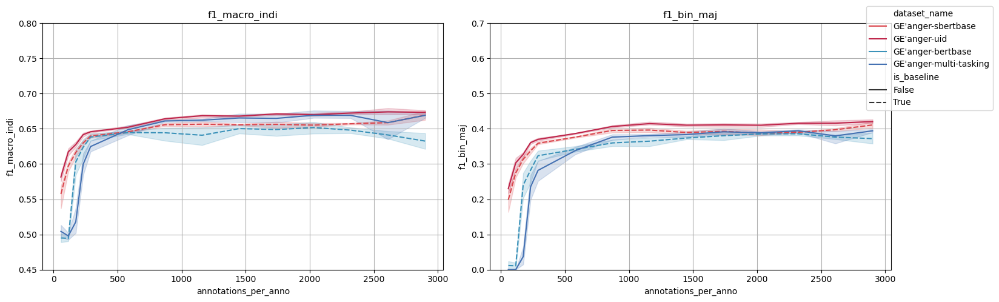

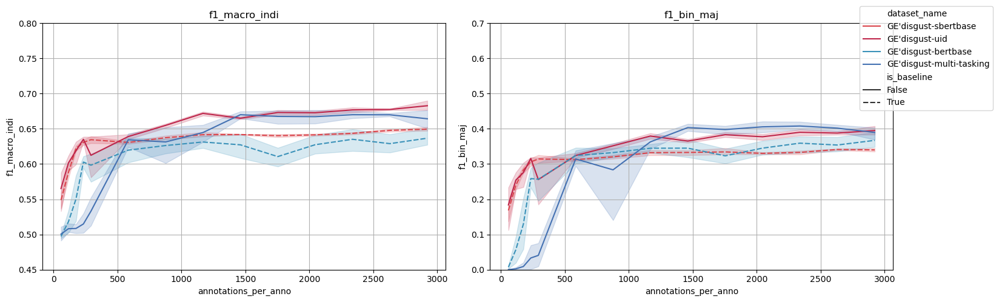

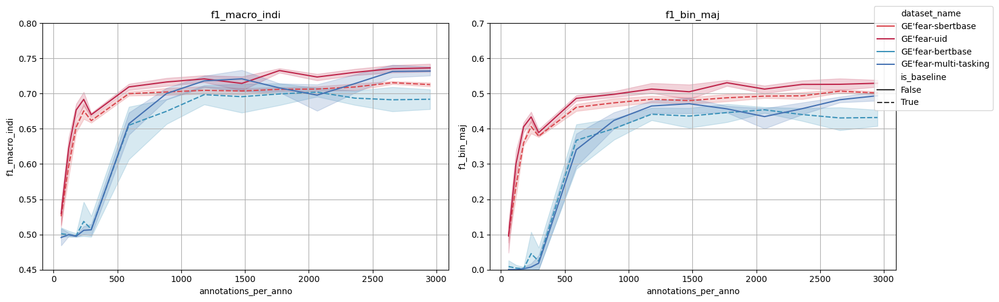

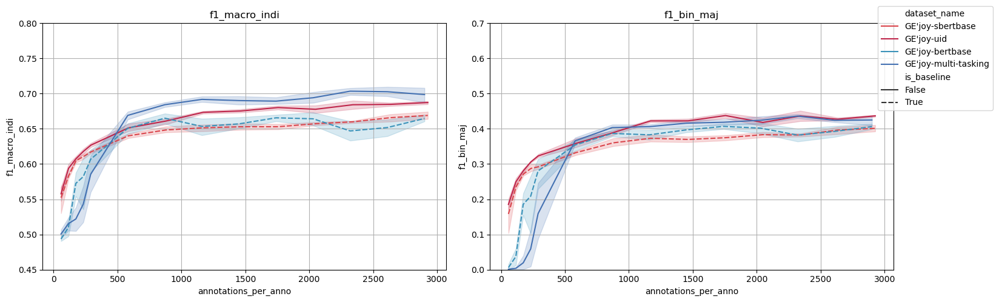

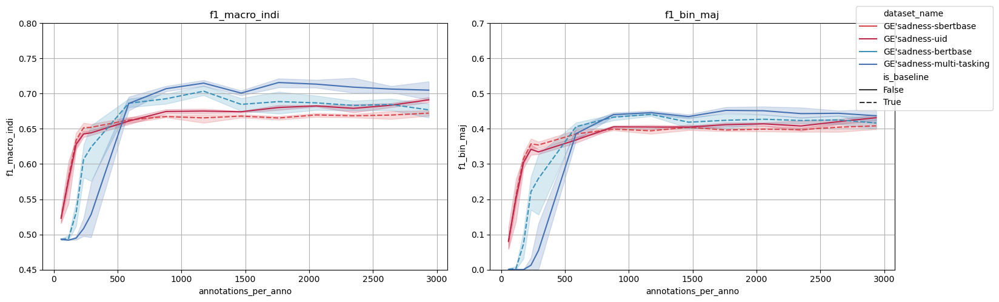

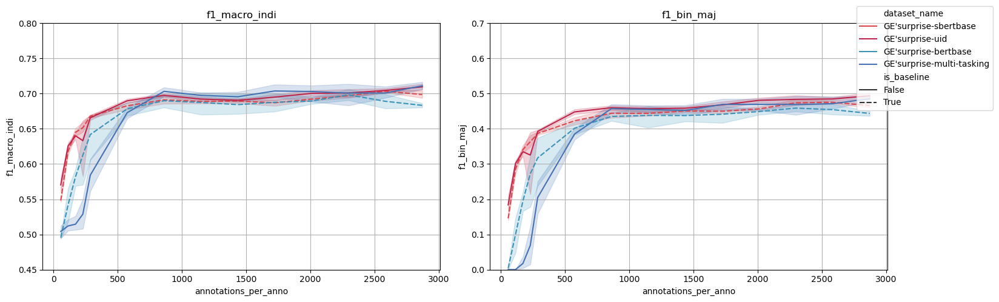

In [117]:
for emotion in emotions:
    plot_f1s_multi_df(all_explo_res_14_all, on_x='annotations_per_anno', on_y='two', only_ds=f"GE'{emotion}", plot_data_count=False)

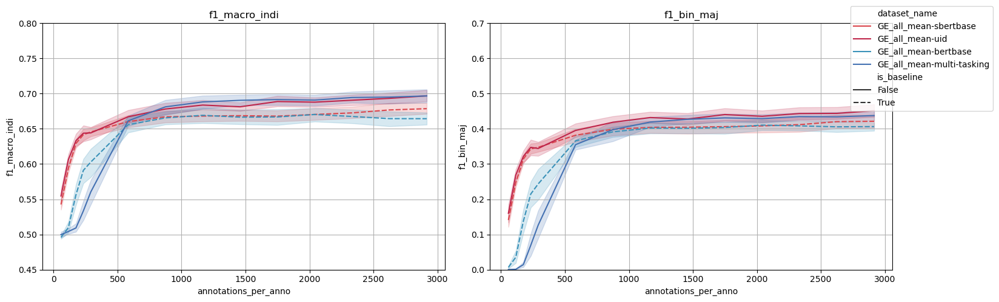

In [154]:
plot_f1s_multi_df(all_explo_res_ge_14_rm_emotion, on_x='annotations_per_anno', on_y='two', only_ds=f"GE_all_mean", plot_data_count=False)

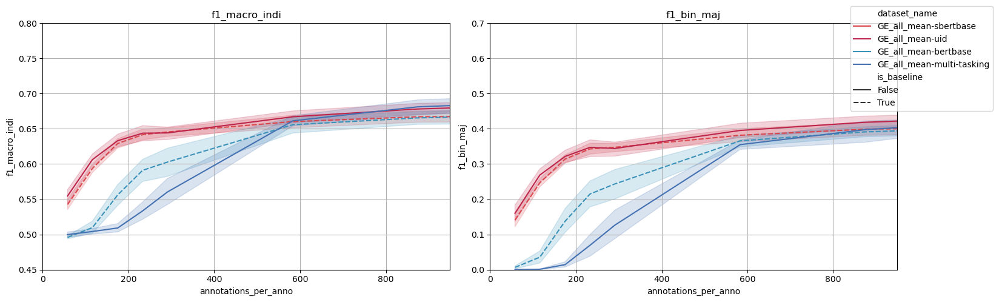

In [122]:
#for comparison with 50 annos:
plot_f1s_multi_df(all_explo_res_ge_14_rm_emotion, on_x='annotations_per_anno', on_y='two', only_ds=f"GE_all_mean", set_x_range=(0,949), plot_data_count=False)

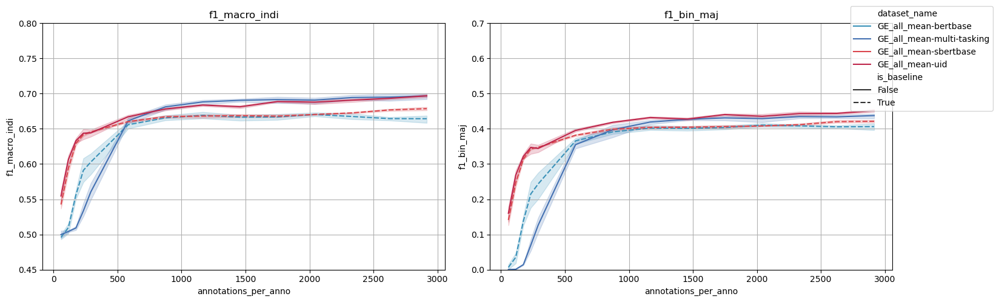

In [123]:
plot_f1s_multi_df(all_explo_res_ge_14_rm_emotion, on_x='annotations_per_anno', on_y='two', only_ds_color_schema=True, plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_29468/3984906497.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


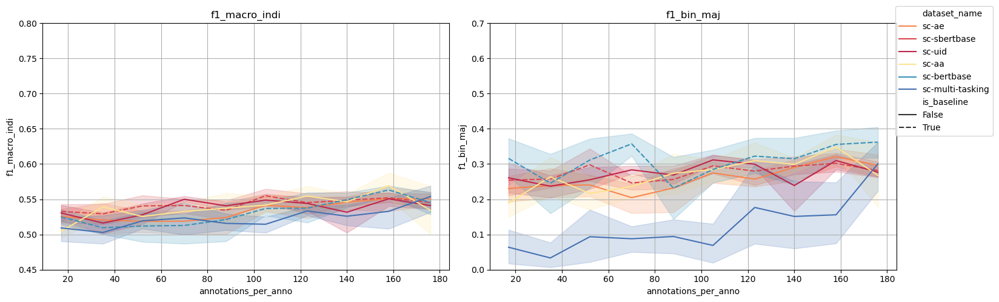

In [125]:
plot_f1s_multi_df(all_explo_res_14, on_x='annotations_per_anno', on_y='two', only_ds='SC', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_29468/3984906497.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


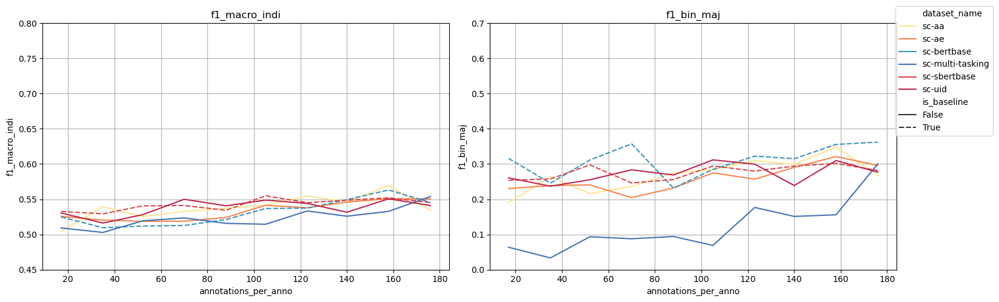

In [126]:
plot_f1s_multi_df(all_explo_res_14_mean, on_x='annotations_per_anno', on_y='two', only_ds='SC', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/2131020913.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


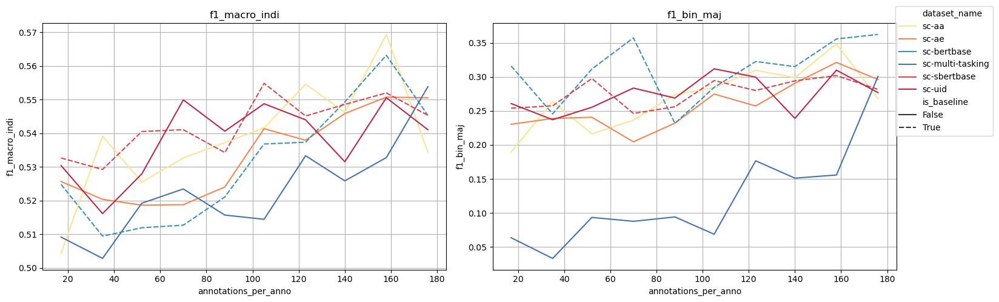

In [24]:
plot_f1s_multi_df(all_explo_res_14_mean, on_x='annotations_per_anno', on_y='two', only_ds='SC', fixed_y_axis=False, plot_data_count=False)

## 50 Annotators: GE, GHC, SC

In [124]:
# all_explo_res_50 = get_all_res_as_df(50, comments='comment_', ignore_list=['multi-tasking-sbert'])
# all_explo_res_50_all = all_explo_res_50.copy()
# all_explo_res_50 = all_explo_res_50[~all_explo_res_50.dataset_name.str.contains("'")]
# all_explo_res_50_all = all_explo_res_50_all[~all_explo_res_50_all.dataset_name.str.contains('GE-')] # remove old GE runs.
# all_explo_res_50_all.to_csv('../data/all_explo_res_50_all.csv')

In [167]:
all_explo_res_50 = pd.read_csv('../data/all_explo_res_50.csv')
all_explo_res_50_all = pd.read_csv('../data/all_explo_res_50_all.csv')

FileNotFoundError: [Errno 2] No such file or directory: '../data/all_explo_res_50.csv'

In [26]:
all_explo_res_50_mean = get_means_of_folds(all_explo_res_50.drop(columns=['model','ds_name']), is_comments_df=True)

In [27]:
# mean of GE
all_explo_res_ge_50_rm_emotion = all_explo_res_50_all[all_explo_res_50_all.dataset_name.str.contains('GE')].copy()
for m_name in model_names:
    all_explo_res_ge_50_rm_emotion.loc[all_explo_res_ge_50_rm_emotion.dataset_name.str.contains(f"-{m_name}"),'dataset_name'] = f'GE_all_mean-{m_name}'
all_explo_res_ge_50_rm_emotion['annotations_per_anno'] = all_explo_res_ge_50_rm_emotion.groupby(['comment_percentage'])[['annotations_per_anno']].transform('mean').annotations_per_anno.round()

all_explo_res_ge_50_mean = rm_emos_to_mean_df(all_explo_res_ge_50_rm_emotion, is_comment_df=True)

In [28]:
all_explo_res_50[all_explo_res_50.dataset_name.str.contains('GE')][['f1_macro_indi','f1_bin_maj','annotations_per_anno']][:14]

,f1_macro_indi,f1_bin_maj,annotations_per_anno


In [27]:
# all_explo_res_50_all[all_explo_res_50_all.dataset_name.str.contains("GE'surprise")][['dataset_name','f1_macro_indi','f1_bin_maj','annotations_per_anno']].groupby(['dataset_name','annotations_per_anno']).mean()

In [35]:
all_explo_res_50_all[all_explo_res_50_all.dataset_name.str.contains("GE'anger")][['f1_macro_indi','f1_bin_maj','annotations_per_anno']][:14]

,f1_macro_indi,f1_bin_maj,annotations_per_anno
0,0.526539,0.093333,18
1,0.549897,0.131455,18
12,0.590842,0.218951,37
13,0.618523,0.275591,37
24,0.609828,0.267559,56
25,0.616179,0.281437,56
36,0.614951,0.279424,75
37,0.621424,0.293578,75
48,0.620794,0.287253,94
49,0.628955,0.310065,94


In [126]:
# all_explo_res_50 = pd.concat([all_explo_res_50[~all_explo_res_50.dataset_name.str.contains('GE')], all_explo_res_ge_50_mean])
# all_explo_res_50.to_csv('../data/all_explo_res_50.csv')

In [ ]:
# pd.set_option('display.max_rows', None)
pd.reset_option('all')

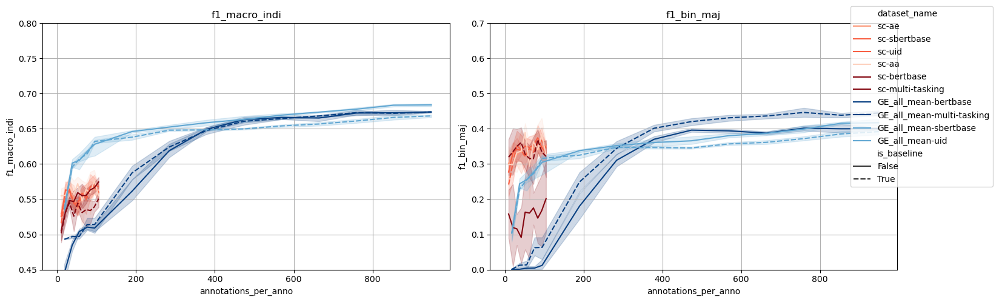

In [31]:
plot_f1s_multi_df(all_explo_res_50, on_x='annotations_per_anno', on_y='two', plot_data_count=False)

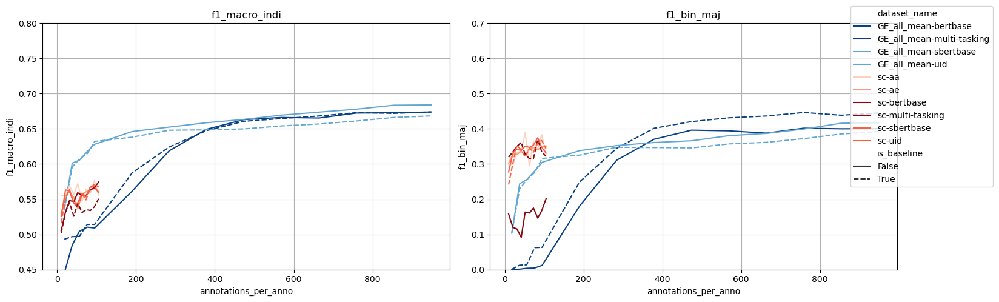

In [34]:
plot_f1s_multi_df(all_explo_res_50_mean, on_x='annotations_per_anno', on_y='two', plot_data_count=False)

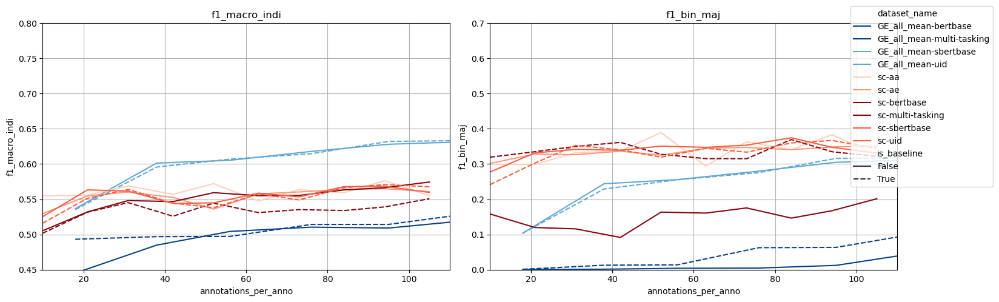

In [35]:
plot_f1s_multi_df(all_explo_res_50_mean, on_x='annotations_per_anno', on_y='two', set_x_range=(10,110), plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_94153/1155497814.py:125: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_94153/1155497814.py:125: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_94153/115549781

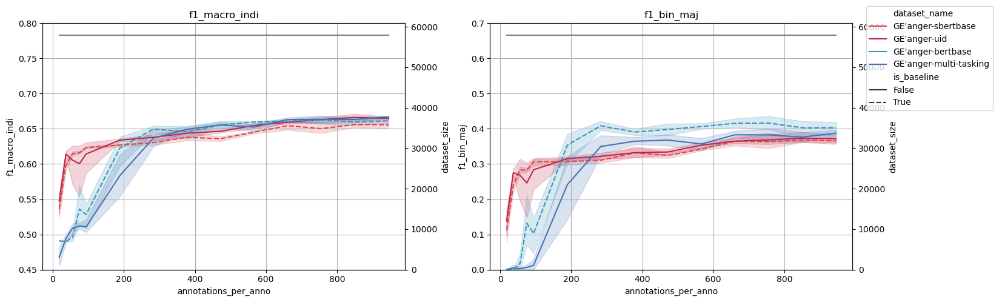

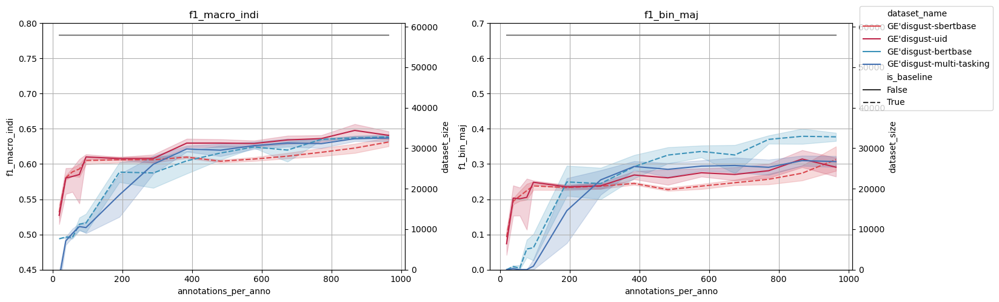

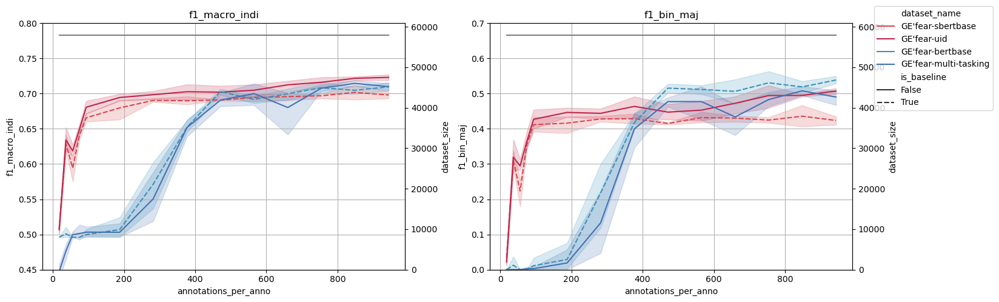

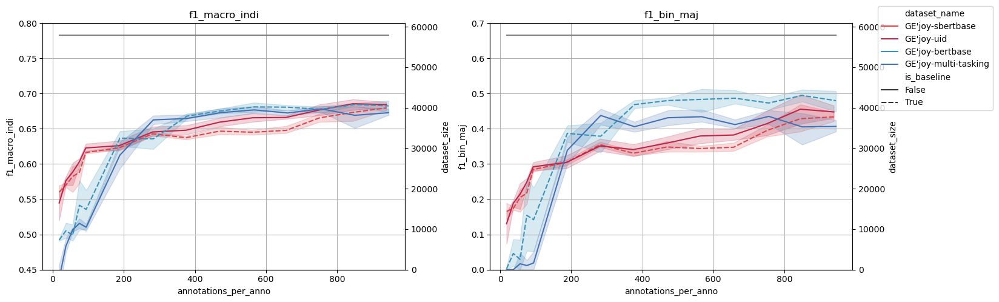

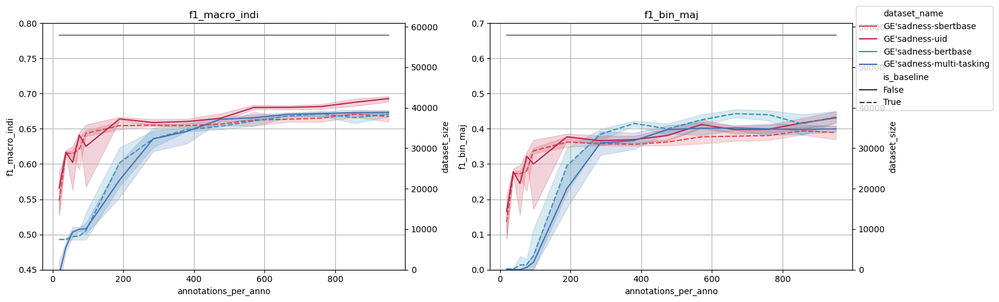

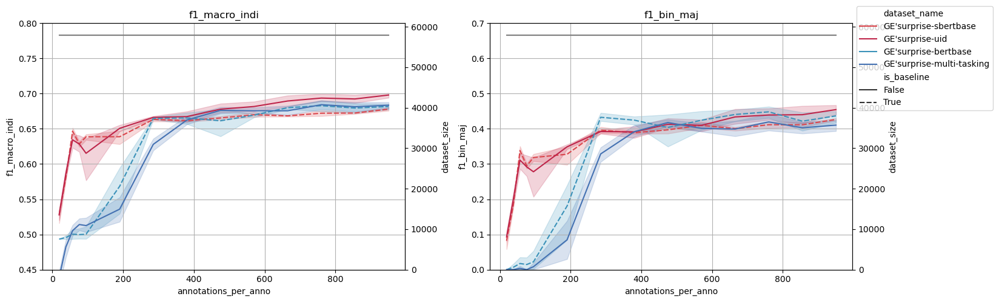

In [132]:
for emotion in emotions:
    plot_f1s_multi_df(all_explo_res_50_all, on_x='annotations_per_anno', on_y='two', only_ds=f"GE'{emotion}", plot_data_count=False)

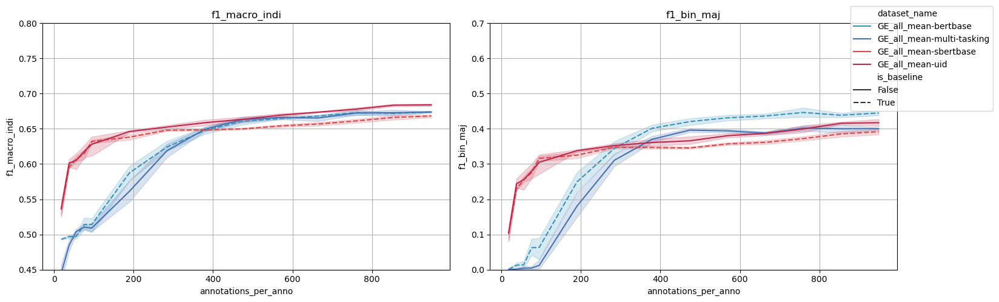

In [134]:
plot_f1s_multi_df(all_explo_res_ge_50_mean, on_x='annotations_per_anno', on_y='two', only_ds_color_schema=True, plot_data_count=False)

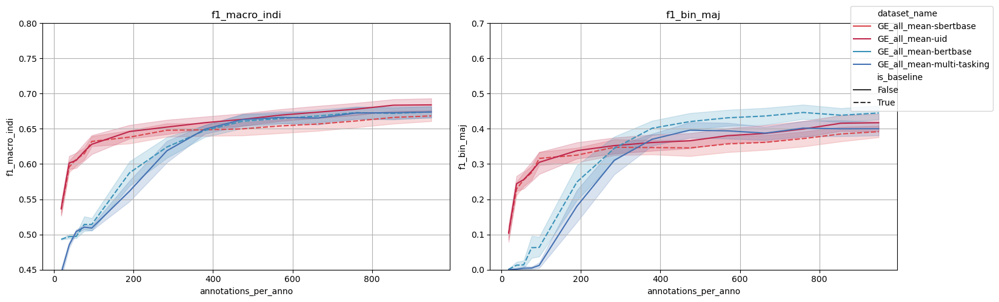

In [36]:
plot_f1s_multi_df(all_explo_res_ge_50_rm_emotion, on_x='annotations_per_anno', on_y='two', only_ds=f"GE_all_mean", plot_data_count=False)

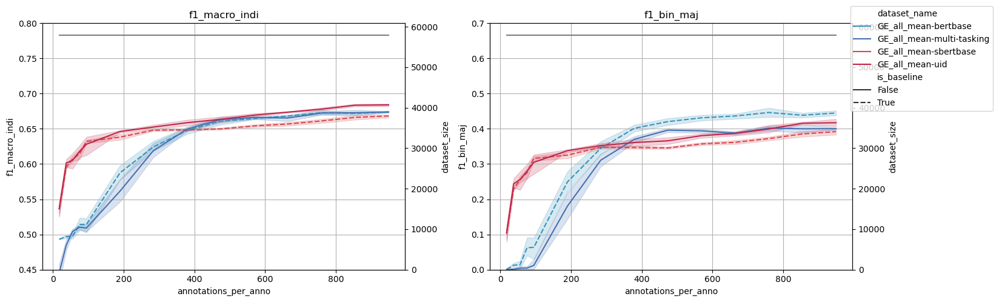

In [136]:
plot_f1s_multi_df(all_explo_res_ge_50_mean, on_x='annotations_per_anno', on_y='two', only_ds=f"GE_all_mean", plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/2131020913.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


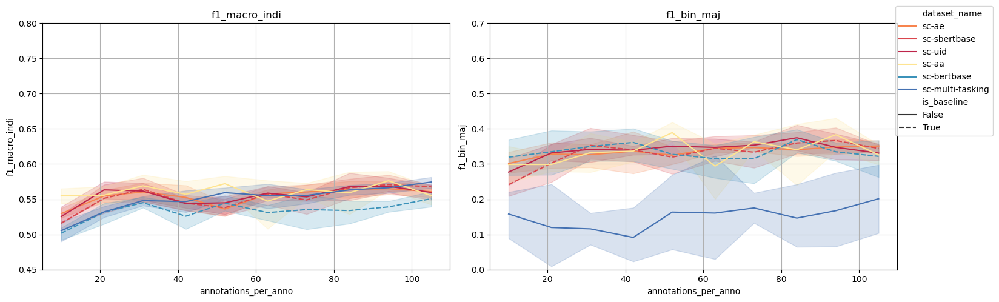

In [29]:
plot_f1s_multi_df(all_explo_res_50, on_x='annotations_per_anno', on_y='two', only_ds='SC', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/2131020913.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


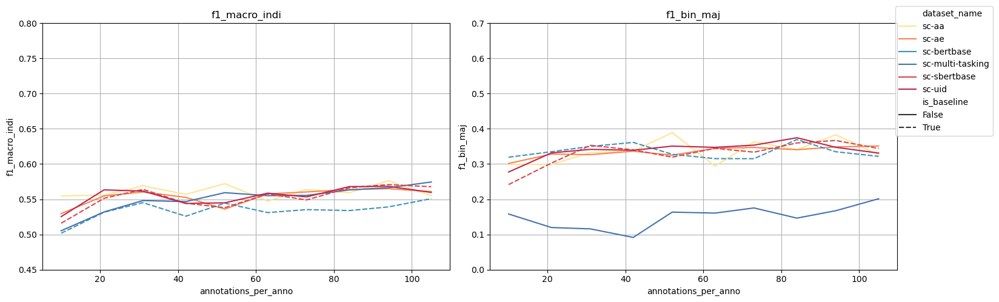

In [31]:
plot_f1s_multi_df(all_explo_res_50_mean, on_x='annotations_per_anno', on_y='two', only_ds='SC', plot_data_count=False)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/2131020913.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')


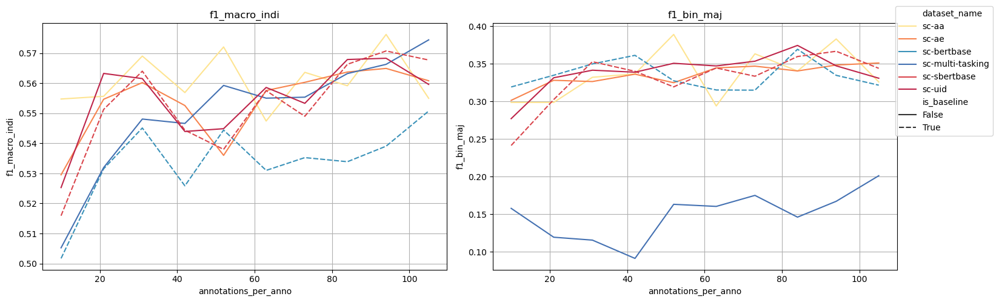

In [32]:
plot_f1s_multi_df(all_explo_res_50_mean, on_x='annotations_per_anno', on_y='two', only_ds='SC', fixed_y_axis=False, plot_data_count=False)

## MD

### 14 Annos

In [236]:
md_explo_res_14, missing = get_all_res_as_df(14, comments='comment_', only_df='MD')

In [212]:
md_explo_res_14_mean = get_means_of_folds(md_explo_res_14.drop(columns=['model','ds_name']), is_comments_df=True)

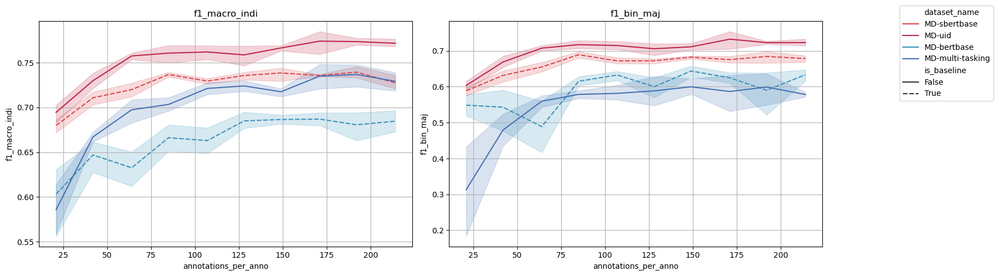

In [242]:
plot_f1s_multi_df(md_explo_res_14, only_ds='MD', on_x='annotations_per_anno', on_y='two', plot_data_count=False, fixed_y_axis=False)

### 50 Annos

In [240]:
md_explo_res_50, missing = get_all_res_as_df(50, comments='comment_', only_df='MD')

In [243]:
md_explo_res_50_mean = get_means_of_folds(md_explo_res_50.drop(columns=['model','ds_name']), is_comments_df=True)

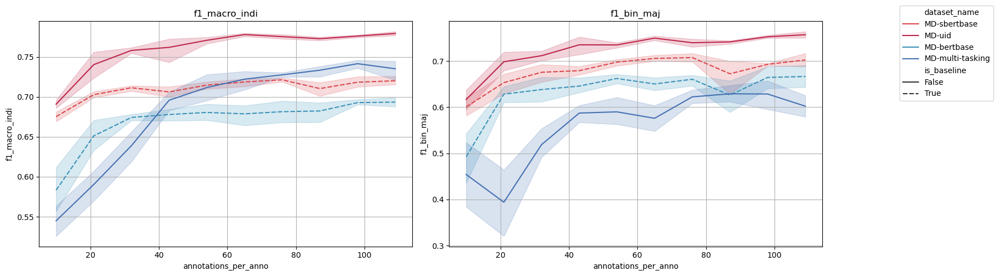

In [241]:
plot_f1s_multi_df(md_explo_res_50, only_ds='MD', on_x='annotations_per_anno', on_y='two', plot_data_count=False, fixed_y_axis=False)

### MD: compare 14 with 50:

In [251]:
md_50 = md_explo_res_50.copy()
md_50['dataset_name'] = md_50['dataset_name'] +'_'+ md_50['num_annos'].map(str)

md_14 = md_explo_res_14.copy()
md_14['dataset_name'] = md_14['dataset_name'] +'_'+ md_14['num_annos'].map(str)

compare_df_md = pd.concat([md_14,md_50])

compare_df_md['is_baseline'] = compare_df_md.dataset_name.str.lower().str.contains('base')

In [257]:
md_50[['comment_percentage', 'annotations_per_anno']].transpose()

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
comment_percentage,10,10,20,20,30,30,40,40,50,50,...,60,60,70,70,80,80,90,90,100,100
annotations_per_anno,10,10,21,21,32,32,43,43,54,54,...,65,65,76,76,87,87,98,98,109,109


In [252]:
diffrences_df_md = get_differences_50_14(compare_df_md)

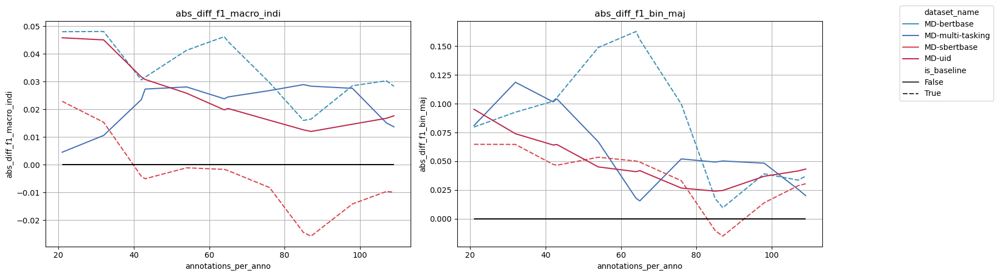

In [253]:
plot_f1s_multi_df(get_means_of_folds(diffrences_df_md, is_abs_diff_df=True), on_x='annotations_per_anno', on_y='two', fixed_y_axis=False, color_schema_auto=False, only_ds_color_schema=True, on_y_list=['abs_diff_f1_macro_indi','abs_diff_f1_bin_maj'], highlight_zero=True)

## compare 14 with 50:

In [65]:
ge_rm_emotion_50 = all_explo_res_ge_50_mean.copy()
ge_rm_emotion_50['dataset_name'] = ge_rm_emotion_50['dataset_name'] +'_'+ ge_rm_emotion_50['num_annos'].map(str)
# ge_rm_emotion_50.annotations_per_anno = ge_rm_emotion_50.annotations_per_anno/14*50

ge_rm_emotion_14 = all_explo_res_ge_14_mean.copy()
ge_rm_emotion_14['dataset_name'] = ge_rm_emotion_14['dataset_name'] +'_'+ ge_rm_emotion_14['num_annos'].map(str)
# ge_rm_emotion_50.annotations_per_anno = ge_rm_emotion_50.annotations_per_anno/14*50

compare_df_ge = pd.concat([ge_rm_emotion_14,ge_rm_emotion_50])
compare_df_ge['is_baseline'] = compare_df_ge.dataset_name.str.lower().str.contains('base')

In [66]:
# compare_df_ge = compare_df_ge[compare_df_ge.annotations_per_anno>18] 

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

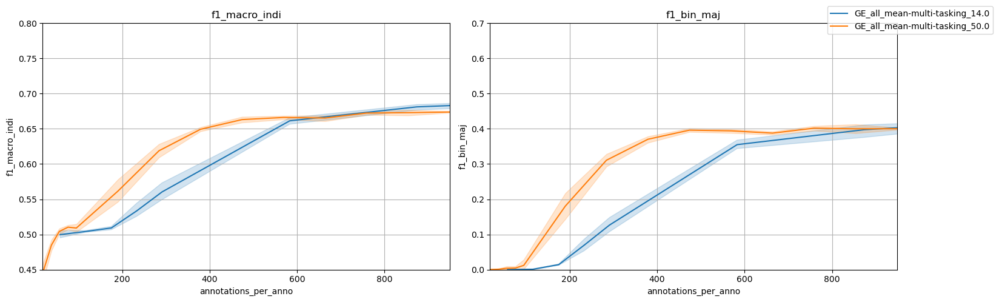

In [67]:
plot_f1s_multi_df(compare_df_ge[compare_df_ge.dataset_name.str.contains('-multi-tasking')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(18,949), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

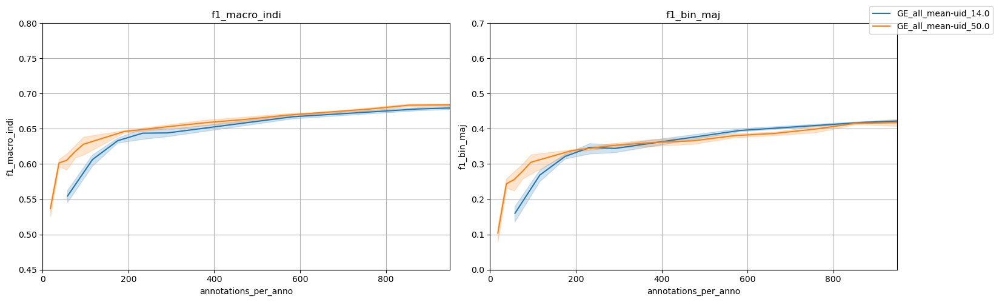

In [68]:
plot_f1s_multi_df(compare_df_ge[compare_df_ge.dataset_name.str.contains('-uid')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(0,949), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

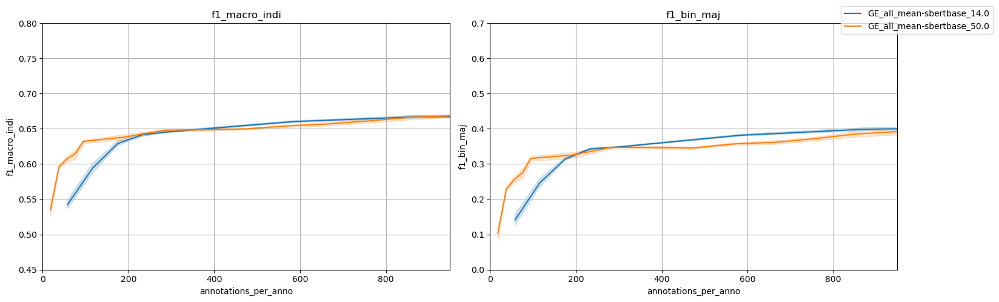

In [69]:
plot_f1s_multi_df(compare_df_ge[compare_df_ge.dataset_name.str.contains('-sbert')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(0,949), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

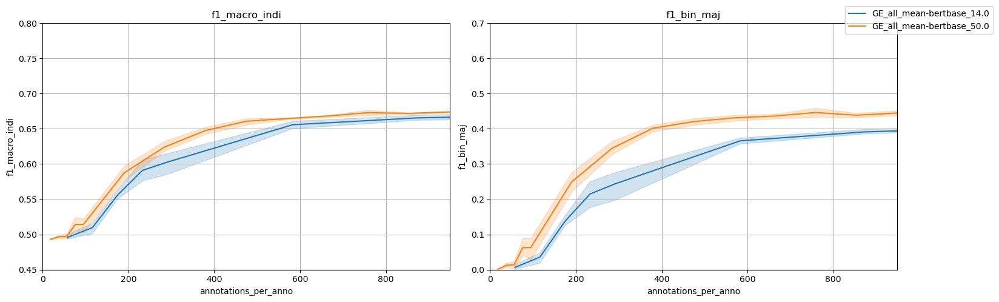

In [70]:
plot_f1s_multi_df(compare_df_ge[compare_df_ge.dataset_name.str.contains('-bert')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(0,949), no_style=True)

In [71]:
diffrences_df_ge = get_differences_50_14(compare_df_ge)

In [97]:
diffrences_df_ge.annotations_per_anno

0         58
1         59
2         60
3         61
4         62
        ... 
17835    945
17836    946
17837    947
17838    948
17839    949
Name: annotations_per_anno, Length: 17840, dtype: object

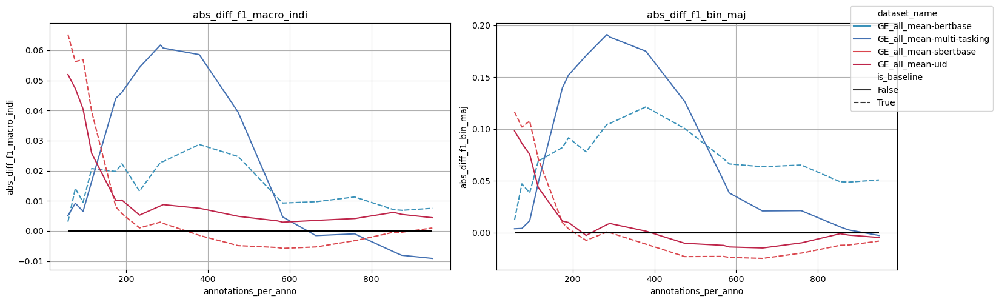

In [94]:
plot_f1s_multi_df(get_means_of_folds(diffrences_df_ge, is_abs_diff_df=True), on_x='annotations_per_anno', on_y='two', fixed_y_axis=False, color_schema_auto=False, only_ds_color_schema=True, on_y_list=['abs_diff_f1_macro_indi','abs_diff_f1_bin_maj'], highlight_zero=True)

In [74]:
sc_50 = all_explo_res_50[all_explo_res_50.dataset_name.str.lower().str.contains('sc')]
sc_50['dataset_name'] = sc_50['dataset_name'] +'_'+ sc_50['num_annos'].map(str)

sc_14 = all_explo_res_14[all_explo_res_14.dataset_name.str.lower().str.contains('sc')]
sc_14['dataset_name'] = sc_14['dataset_name'] +'_'+ sc_14['num_annos'].map(str)

compare_df_sc = pd.concat([sc_14,sc_50])

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/3485025448.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sc_50['dataset_name'] = sc_50['dataset_name'] +'_'+ sc_50['num_annos'].map(str)
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/3485025448.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sc_14['dataset_name'] = sc_14['dataset_name'] +'_'+ sc_14['num_annos'].map(str)


In [75]:
diffrences_df_sc = get_differences_50_14(compare_df_sc)

In [98]:
diffrences_df_sc.annotations_per_anno

0        17
1        18
2        19
3        20
4        21
       ... 
2665    101
2666    102
2667    103
2668    104
2669    105
Name: annotations_per_anno, Length: 2670, dtype: object

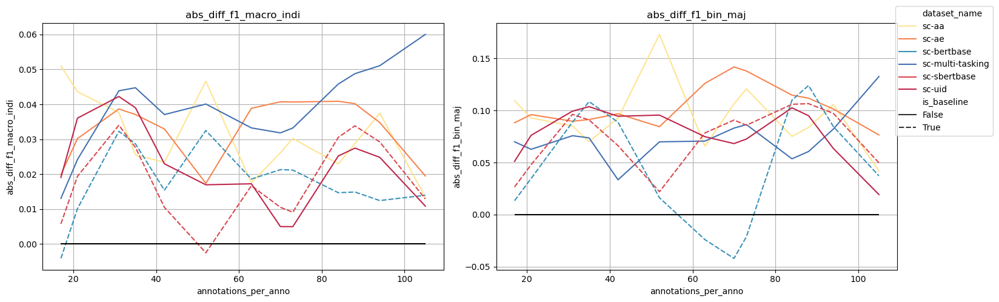

In [96]:
plot_f1s_multi_df(get_means_of_folds(diffrences_df_sc, is_abs_diff_df=True), on_x='annotations_per_anno', on_y='two', fixed_y_axis=False, color_schema_auto=False, only_ds_color_schema=True, on_y_list=['abs_diff_f1_macro_indi','abs_diff_f1_bin_maj'], highlight_zero=True)

In [77]:
# plot_f1s_multi_df(compare_df_sc[compare_df_sc.dataset_name.str.contains('multi-tasking')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(17,110), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

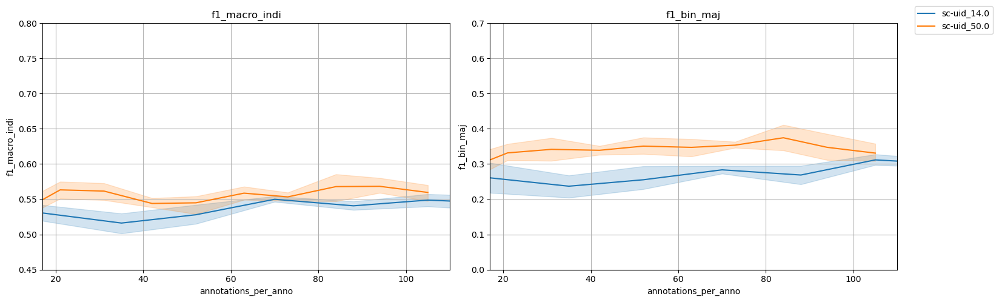

In [78]:
plot_f1s_multi_df(compare_df_sc[compare_df_sc.dataset_name.str.contains('uid')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(17,110), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

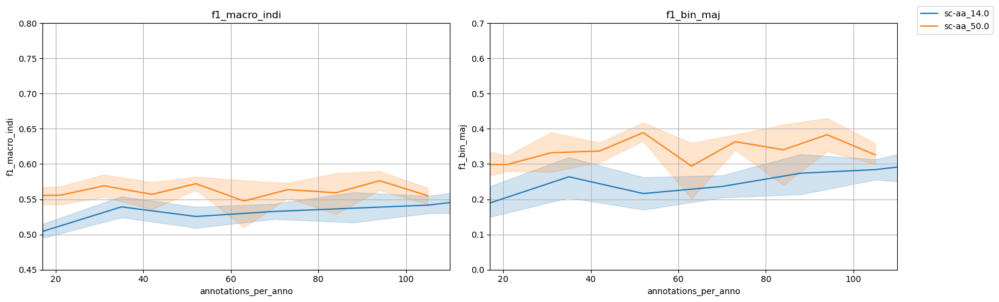

In [79]:
plot_f1s_multi_df(compare_df_sc[compare_df_sc.dataset_name.str.contains('aa')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(17,110), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

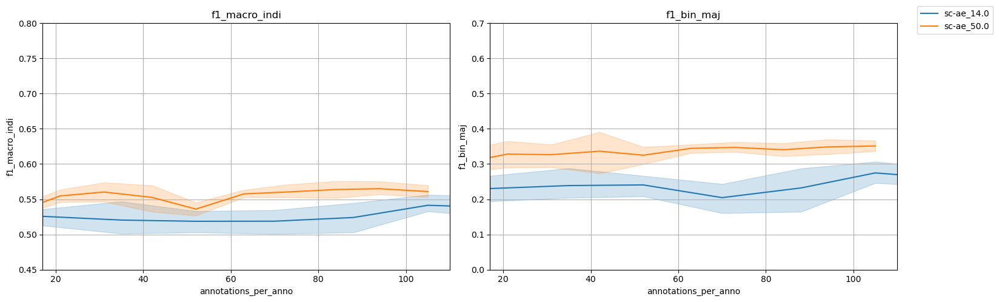

In [80]:
plot_f1s_multi_df(compare_df_sc[compare_df_sc.dataset_name.str.contains('ae')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(17,110), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

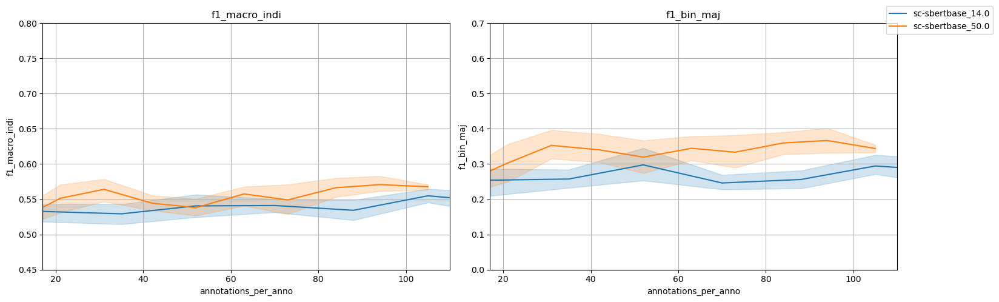

In [81]:
plot_f1s_multi_df(compare_df_sc[compare_df_sc.dataset_name.str.contains('-sbert')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(17,110), no_style=True)

/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:138: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multi_res_df['is_baseline'] = multi_res_df.dataset_name.str.lower().str.contains('base')
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, hue='dataset_name' ,style=line_style, palette=colors, ax=axs[i])
/var/folders/5w/704vgpg533lchz5h0y4zwhfc0000gn/T/ipykernel_6130/1320608738.py:166: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  lnplt = sns.lineplot(data=multi_res_df, x=on_x, y=on_y, h

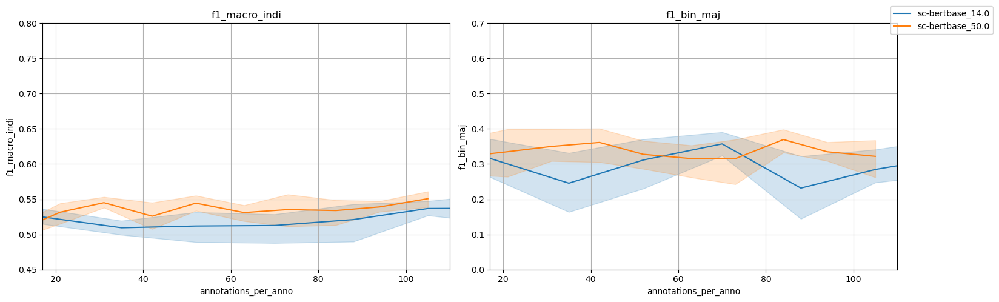

In [82]:
plot_f1s_multi_df(compare_df_sc[compare_df_sc.dataset_name.str.contains('-bert')], on_x='annotations_per_anno', on_y='two', color_schema_auto=True, set_x_range=(17,110), no_style=True)

## OLD res vor GE, GHC

In [407]:
path_to_ge_ghc_data = f'../data/matching_sizes_data/'
path_to_old_ge_ghc_data_size_exploration = path_to_models_runs + '/old_scalability/'
old_ge_ghc_exploration_runs = sorted(os.listdir(path_to_old_ge_ghc_data_size_exploration), key=lambda run: (int(run.split('_')[1]),run.split('_')[0]))

FileNotFoundError: [Errno 2] No such file or directory: '../results//old_scalability/'

In [56]:
old_all_explo_res = pd.DataFrame(columns=['dataset', 'dataset_size', 'num_annos', 'test_f1', 'test_acc', 'seconds_per_epoch_per_1000sample'])

for run in old_ge_ghc_exploration_runs:
    dataset_name = run.split('_')[0]
    num_annos = int(run.split('_')[1])
    
    path_to_dataset = f'{path_to_ge_ghc_data}{dataset_name}_{num_annos}_annos_filtered.csv'
    with open(path_to_dataset, 'r') as f:
        dataframe = pd.read_csv(f)
    dataset_size = len(dataframe)
    
    hypers = return_hyperparams(path_to_old_ge_ghc_data_size_exploration, run) #time_millis
    millis = hypers['time_millis']
    seconds = millis/1000
    res_df = return_results_df(path_to_old_ge_ghc_data_size_exploration, run)
    test_f1 = res_df.loc['Test_results','test_f1s']
    test_acc = res_df.loc['Test_results','test_accs']
    num_epochs = len(res_df[res_df.index.str.lower().str.contains('epoch')])
    run_time = seconds/num_epochs/dataset_size*1000
    old_all_explo_res.loc[len(old_all_explo_res),:] = [dataset_name, dataset_size, num_annos, test_f1, test_acc, run_time]

NameError: name 'old_ge_ghc_exploration_runs' is not defined

In [84]:
display(old_all_explo_res.style.background_gradient(
    cmap ='YlGn', 
    subset=['dataset_size','test_f1','seconds_per_epoch_per_1000sample'], 
    low=0, 
    high=0.6
    ).format(precision=3))

,dataset,dataset_size,num_annos,test_f1,test_acc,seconds_per_epoch_per_1000sample
0,GE,3011,8,0.390,0.928,4.556
1,GHC,3011,8,0.636,0.920,4.514
2,GE,3230,9,0.439,0.939,4.688
3,GHC,3230,9,0.645,0.927,4.688
4,GE,3437,10,0.435,0.936,4.961
5,GHC,3437,10,0.644,0.922,4.888
6,GE,3712,11,0.400,0.932,5.001
7,GHC,3712,11,0.660,0.926,4.948
8,GE,3918,12,0.423,0.937,5.047
9,GHC,3918,12,0.613,0.909,4.911


<AxesSubplot: xlabel='num_annos', ylabel='test_f1'>

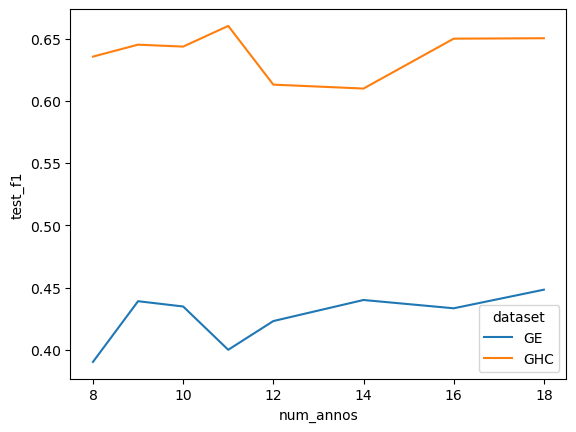

In [83]:
sns.lineplot(data=old_all_explo_res, x=old_all_explo_res.num_annos, hue='dataset' ,y='test_f1')

# lr search SC with multi task

In [71]:
path_to_sc_lr_search = '../results/SC_multi_task_lr_search/'

In [73]:
sc_lr_easrch_runs = get_runs(path_to_sc_lr_search)
sc_lr_easrch_runs

['sc_82_annos_6e-05_lr',
 'sc_82_annos_1e-05_lr',
 'sc_82_annos_4e-05_lr',
 'sc_82_annos_1e-06_lr',
 'sc_82_annos_5e-06_lr',
 'sc_82_annos_0.0001_lr',
 'sc_82_annos_5e-05_lr',
 'sc_82_annos_0.0005_lr',
 'sc_82_annos_3e-05_lr',
 'sc_82_annos_8e-05_lr',
 'sc_82_annos_7e-05_lr',
 'sc_82_annos_2e-05_lr']

In [89]:
sc_lr_easrch_res = get_multi_runs_res_df(path_to_sc_lr_search,sc_lr_easrch_runs, path_to_sc_data, path_to_ge_ghc_data, provided_dataset_model_name='sc', lr_search=True)

sc_82_annos_6e-05_lr
None
____________________________________________________________________________________________________
'number_of_annotations'
____________________________________________________________________________________________________
Traceback (most recent call last):
  File "/app/home/neuendob/anaconda3/envs/master/lib/python3.10/site-packages/pandas/core/indexes/base.py", line 3802, in get_loc
    return self._engine.get_loc(casted_key)
  File "pandas/_libs/index.pyx", line 138, in pandas._libs.index.IndexEngine.get_loc
  File "pandas/_libs/index.pyx", line 165, in pandas._libs.index.IndexEngine.get_loc
  File "pandas/_libs/hashtable_class_helper.pxi", line 5745, in pandas._libs.hashtable.PyObjectHashTable.get_item
  File "pandas/_libs/hashtable_class_helper.pxi", line 5753, in pandas._libs.hashtable.PyObjectHashTable.get_item
KeyError: 'number_of_annotations'

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
 

sc_82_annos_8e-05_lr
None
____________________________________________________________________________________________________
'number_of_annotations'
____________________________________________________________________________________________________
Traceback (most recent call last):
  File "/app/home/neuendob/anaconda3/envs/master/lib/python3.10/site-packages/pandas/core/indexes/base.py", line 3802, in get_loc
    return self._engine.get_loc(casted_key)
  File "pandas/_libs/index.pyx", line 138, in pandas._libs.index.IndexEngine.get_loc
  File "pandas/_libs/index.pyx", line 165, in pandas._libs.index.IndexEngine.get_loc
  File "pandas/_libs/hashtable_class_helper.pxi", line 5745, in pandas._libs.hashtable.PyObjectHashTable.get_item
  File "pandas/_libs/hashtable_class_helper.pxi", line 5753, in pandas._libs.hashtable.PyObjectHashTable.get_item
KeyError: 'number_of_annotations'

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
 

In [ ]:
ge_lr_easrch_res = ge_ghc_lr_easrch_res[ge_ghc_lr_easrch_res.dataset_name.str.contains('GE')][['dataset_name', 'f1_bin_maj', 'f1_macro_maj', 'f1_bin_indi', 'f1_macro_indi', 'test_acc_maj', 'learning_rate']]
ghc_lr_easrch_res = ge_ghc_lr_easrch_res[ge_ghc_lr_easrch_res.dataset_name.str.contains('GHC')][['dataset_name', 'f1_bin_maj', 'f1_macro_maj', 'f1_bin_indi', 'f1_macro_indi', 'test_acc_maj', 'learning_rate']]

In [ ]:
ge_lr_easrch_res = ge_lr_easrch_res.sort_values(by='learning_rate')
ghc_lr_easrch_res = ghc_lr_easrch_res.sort_values(by='learning_rate')

In [14]:
sc_lr_res_df = results_of_folder(path_to_sc_lr_search)

'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'
'Test_results'


In [15]:
sc_lr_res_df['lr'] = sc_lr_res_df.run.apply(lambda s: s.split('_')[-2])

In [1]:
str(0.0005)

'0.0005'

In [16]:
display_res_df_color(sc_lr_res_df)

,run,test_f1,test_acc,seconds_per_epoch,lr


In [2]:
[float(f"{x}e-{y}") for x,y in zip([1,5]*4, [3,4,4,5,5,6])]

[0.001, 0.0005, 0.0001, 5e-05, 1e-05, 5e-06]

# lr serach GE with UID

In [57]:
path_to_ge_ghc_lr_search = '../../user_perception/results/lr_search_GE_GHC_uid/'

In [58]:
ge_ghc_lr_easrch_runs = get_runs(path_to_ge_ghc_lr_search)
ge_ghc_lr_easrch_runs

['GHC-uid_18_annos_0.001_lr',
 'GHC-uid_18_annos_1e-05_lr',
 'GHC-uid_18_annos_0.0005_lr',
 'GHC-uid_18_annos_0.0001_lr',
 'GHC-uid_18_annos_5e-06_lr',
 'GHC-uid_18_annos_5e-05_lr',
 'GE-uid_50_annos_0.0005_lr',
 'GE-uid_50_annos_5e-06_lr',
 'GE-uid_50_annos_5e-05_lr',
 'GE-uid_50_annos_1e-05_lr',
 'GE-uid_50_annos_0.0001_lr',
 'GE-uid_50_annos_0.001_lr']

In [59]:
ge_ghc_lr_easrch_res = get_multi_runs_res_df(path_to_ge_ghc_lr_search,ge_ghc_lr_easrch_runs, path_to_sc_data, path_to_ge_ghc_data, lr_search=True)

In [61]:
ge_lr_easrch_res = ge_ghc_lr_easrch_res[ge_ghc_lr_easrch_res.dataset_name.str.contains('GE')][['dataset_name', 'f1_bin_maj', 'f1_macro_maj', 'f1_bin_indi', 'f1_macro_indi', 'test_acc_maj', 'learning_rate']]
ghc_lr_easrch_res = ge_ghc_lr_easrch_res[ge_ghc_lr_easrch_res.dataset_name.str.contains('GHC')][['dataset_name', 'f1_bin_maj', 'f1_macro_maj', 'f1_bin_indi', 'f1_macro_indi', 'test_acc_maj', 'learning_rate']]

In [65]:
ge_lr_easrch_res = ge_lr_easrch_res.sort_values(by='learning_rate')
ghc_lr_easrch_res = ghc_lr_easrch_res.sort_values(by='learning_rate')

In [66]:
ge_lr_easrch_res

,dataset_name,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,test_acc_maj,learning_rate
7,GE-uid,0.372028,0.662771,0.372028,0.662771,0.913437,0.000005
9,GE-uid,0.398074,0.679808,0.398074,0.679808,0.927704,0.00001
8,GE-uid,0.342944,0.649187,0.342944,0.649187,0.916522,0.00005
10,GE-uid,0.357988,0.656618,0.357988,0.656618,0.916329,0.0001
6,GE-uid,0.0,0.489066,0.0,0.489066,0.957201,0.0005
11,GE-uid,0.0,0.489066,0.0,0.489066,0.957201,0.001


In [69]:
display(ge_lr_easrch_res.style.background_gradient(cmap ='YlGn', subset=['f1_bin_maj', 'f1_macro_indi','test_acc_maj']).format(precision=6))

,dataset_name,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,test_acc_maj,learning_rate
7,GE-uid,0.372028,0.662771,0.372028,0.662771,0.913437,0.000005
9,GE-uid,0.398074,0.679808,0.398074,0.679808,0.927704,0.000010
8,GE-uid,0.342944,0.649187,0.342944,0.649187,0.916522,0.000050
10,GE-uid,0.357988,0.656618,0.357988,0.656618,0.916329,0.000100
6,GE-uid,0.000000,0.489066,0.000000,0.489066,0.957201,0.000500
11,GE-uid,0.000000,0.489066,0.000000,0.489066,0.957201,0.001000


In [70]:
display(ge_lr_easrch_res.style.background_gradient(cmap ='YlGn', subset=['f1_bin_maj', 'f1_macro_indi','test_acc_maj']).format(precision=6))

,dataset_name,f1_bin_maj,f1_macro_maj,f1_bin_indi,f1_macro_indi,test_acc_maj,learning_rate
7,GE-uid,0.372028,0.662771,0.372028,0.662771,0.913437,0.000005
9,GE-uid,0.398074,0.679808,0.398074,0.679808,0.927704,0.000010
8,GE-uid,0.342944,0.649187,0.342944,0.649187,0.916522,0.000050
10,GE-uid,0.357988,0.656618,0.357988,0.656618,0.916329,0.000100
6,GE-uid,0.000000,0.489066,0.000000,0.489066,0.957201,0.000500
11,GE-uid,0.000000,0.489066,0.000000,0.489066,0.957201,0.001000


# lr search GHC

In [14]:
path_to_lr_search = path_to_models_runs+'GHC/hate/lr_search_old/'

In [15]:
lr_search_runs = sorted(os.listdir(path_to_lr_search), key= lambda run: float(re.findall(r'[0-9]*e-[0-9]*' ,run)[0]))
lr_search_runs

['run_model_lr_1e-07_single',
 'run_model_lr_1e-07_multi',
 'run_model_lr_5e-07_single',
 'run_model_lr_5e-07_multi',
 'run_model_lr_1e-06_single',
 'run_model_lr_1e-06_multi',
 'run_model_lr_5e-06_single',
 'run_model_lr_5e-06_multi',
 'run_model_lr_1e-05_multi',
 'run_model_lr_1e-05_single',
 'run_model_lr_5e-05_multi',
 'run_model_lr_5e-05_single']

In [16]:
lr_results = dict()

for m_dir in sorted(os.listdir(path_to_lr_search), key= lambda run: float(re.findall(r'[0-9]*e-[0-9]*' ,run)[0])):
    print(m_dir)
    load_and_display_res_df_color(path_to_lr_search, m_dir)
    lr_results[m_dir] = return_results_df(path_to_lr_search,m_dir)

run_model_lr_1e-07_single


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,0.700,0.689,0.028,0.615,0.901,nan,nan
Fold0_epoch1,0.657,0.644,0.004,0.875,0.902,nan,nan
Fold0_epoch2,0.614,0.619,0.000,0.907,0.902,nan,nan
Fold0_epoch3,0.595,0.607,0.000,0.908,0.902,nan,nan
Fold0_epoch4,0.588,0.600,0.000,0.909,0.902,nan,nan
Fold0_epoch5,0.580,0.594,0.000,0.909,0.902,nan,nan
Fold0_epoch6,0.576,0.589,0.000,0.909,0.902,nan,nan
Fold0_epoch7,0.572,0.585,0.000,0.909,0.902,nan,nan
Fold0_epoch8,0.567,0.581,0.000,0.909,0.902,nan,nan
Fold0_epoch9,0.564,0.577,0.000,0.909,0.902,nan,nan


run_model_lr_1e-07_multi


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,2.188,2.183,0.016,0.547,0.891,nan,nan
Fold0_epoch1,2.151,2.152,0.000,0.588,0.901,nan,nan
Fold0_epoch2,2.121,2.129,0.000,0.627,0.902,nan,nan
Fold0_epoch3,2.096,2.109,0.000,0.675,0.902,nan,nan
Fold0_epoch4,2.073,2.093,0.000,0.718,0.902,nan,nan
Fold0_epoch5,2.057,2.080,0.000,0.743,0.902,nan,nan
Fold0_epoch6,2.044,2.069,0.000,0.765,0.902,nan,nan
Fold0_epoch7,2.033,2.059,0.000,0.780,0.902,nan,nan
Fold0_epoch8,2.021,2.052,0.000,0.793,0.902,nan,nan
Fold0_epoch9,2.015,2.044,0.000,0.801,0.902,nan,nan


run_model_lr_5e-07_single


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,0.626,0.585,0.000,0.843,0.902,nan,nan
Fold0_epoch1,0.545,0.528,0.000,0.909,0.902,nan,nan
Fold0_epoch2,0.501,0.490,0.000,0.909,0.902,nan,nan
Fold0_epoch3,0.463,0.473,0.000,0.909,0.902,nan,nan
Fold0_epoch4,0.443,0.454,0.000,0.909,0.902,nan,nan
Fold0_epoch5,0.426,0.444,0.000,0.908,0.902,nan,nan
Fold0_epoch6,0.413,0.443,0.254,0.908,0.908,nan,nan
Fold0_epoch7,0.404,0.444,0.405,0.906,0.905,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.407,0.909
sum,3.821,3.861,0.659,7.201,7.227,0.407,0.909


run_model_lr_5e-07_multi


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,2.116,2.073,0.000,0.643,0.902,nan,nan
Fold0_epoch1,1.997,1.992,0.000,0.823,0.902,nan,nan
Fold0_epoch2,1.917,1.926,0.000,0.864,0.902,nan,nan
Fold0_epoch3,1.847,1.854,0.000,0.868,0.902,nan,nan
Fold0_epoch4,1.779,1.787,0.000,0.871,0.902,nan,nan
Fold0_epoch5,1.718,1.732,0.000,0.878,0.902,nan,nan
Fold0_epoch6,1.670,1.691,0.000,0.884,0.902,nan,nan
Fold0_epoch7,1.634,1.659,0.000,0.886,0.902,nan,nan
Fold0_epoch8,1.603,1.633,0.000,0.887,0.902,nan,nan
Fold0_epoch9,1.573,1.611,0.000,0.888,0.902,nan,nan


run_model_lr_1e-06_single


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,0.568,0.480,0.418,0.867,0.866,nan,nan
Fold0_epoch1,0.437,0.434,0.451,0.886,0.878,nan,nan
Fold0_epoch2,0.394,0.438,0.468,0.892,0.887,nan,nan
Fold0_epoch3,0.371,0.430,0.467,0.894,0.881,nan,nan
Fold0_epoch4,0.352,0.418,0.469,0.897,0.868,nan,nan
Fold0_epoch5,0.335,0.424,0.469,0.901,0.873,nan,nan
Fold0_epoch6,0.322,0.442,0.476,0.903,0.883,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.551,0.905
sum,2.778,3.065,3.220,6.239,6.135,0.551,0.905
epoch_mean,0.397,0.438,0.460,0.891,0.876,nan,nan


run_model_lr_1e-06_multi


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,2.053,1.983,0.000,0.733,0.902,nan,nan
Fold0_epoch1,1.861,1.806,0.000,0.868,0.902,nan,nan
Fold0_epoch2,1.692,1.663,0.000,0.881,0.902,nan,nan
Fold0_epoch3,1.576,1.579,0.253,0.888,0.908,nan,nan
Fold0_epoch4,1.493,1.519,0.443,0.887,0.881,nan,nan
Fold0_epoch5,1.427,1.483,0.455,0.887,0.877,nan,nan
Fold0_epoch6,1.378,1.446,0.455,0.882,0.856,nan,nan
Fold0_epoch7,1.334,1.425,0.461,0.878,0.860,nan,nan
Fold0_epoch8,1.296,1.408,0.467,0.874,0.864,nan,nan
Fold0_epoch9,1.262,1.397,0.467,0.877,0.849,nan,nan


run_model_lr_5e-06_single


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,0.479,0.419,0.463,0.898,0.856,nan,nan
Fold0_epoch1,0.358,0.429,0.481,0.890,0.883,nan,nan
Fold0_epoch2,0.276,0.466,0.486,0.906,0.877,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.626,0.913
sum,1.113,1.314,1.431,2.693,2.616,0.626,0.913
epoch_mean,0.371,0.438,0.477,0.898,0.872,nan,nan
test_mean,nan,nan,nan,nan,nan,0.626,0.913
test_results_std_dev,nan,nan,nan,nan,nan,0.000,0.000


run_model_lr_5e-06_multi


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,1.739,1.475,0.454,0.851,0.845,nan,nan
Fold0_epoch1,1.324,1.374,0.469,0.874,0.836,nan,nan
Fold0_epoch2,1.139,1.329,0.491,0.890,0.860,nan,nan
Fold0_epoch3,1.006,1.362,0.488,0.901,0.863,nan,nan
Fold0_epoch4,0.898,1.391,0.477,0.911,0.856,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.586,0.891
sum,6.106,6.930,2.379,4.428,4.260,0.586,0.891
epoch_mean,1.221,1.386,0.476,0.886,0.852,nan,nan
test_mean,nan,nan,nan,nan,nan,0.586,0.891
test_results_std_dev,nan,nan,nan,nan,nan,0.000,0.000


run_model_lr_1e-05_multi


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,1.588,1.370,0.477,0.856,0.856,nan,nan
Fold0_epoch1,1.203,1.310,0.481,0.883,0.859,nan,nan
Fold0_epoch2,0.981,1.318,0.478,0.902,0.847,nan,nan
Fold0_epoch3,0.811,1.458,0.492,0.918,0.876,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.624,0.908
sum,4.583,5.455,1.928,3.559,3.437,0.624,0.908
epoch_mean,1.146,1.364,0.482,0.890,0.859,nan,nan
test_mean,nan,nan,nan,nan,nan,0.624,0.908
test_results_std_dev,nan,nan,nan,nan,nan,0.000,0.000


run_model_lr_1e-05_single


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,0.460,0.420,0.445,0.887,0.821,nan,nan
Fold0_epoch1,0.323,0.423,0.492,0.899,0.886,nan,nan
Fold0_epoch2,0.216,0.504,0.477,0.930,0.872,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.672,0.925
sum,0.999,1.347,1.414,2.716,2.579,0.672,0.925
epoch_mean,0.333,0.449,0.471,0.905,0.860,nan,nan
test_mean,nan,nan,nan,nan,nan,0.672,0.925
test_results_std_dev,nan,nan,nan,nan,nan,0.000,0.000


run_model_lr_5e-05_multi


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,1.518,1.381,0.477,0.861,0.890,nan,nan
Fold0_epoch1,1.181,1.327,0.485,0.881,0.854,nan,nan
Fold0_epoch2,0.909,1.428,0.493,0.901,0.884,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.614,0.911
sum,3.608,4.135,1.455,2.642,2.627,0.614,0.911
epoch_mean,1.203,1.378,0.485,0.881,0.876,nan,nan
test_mean,nan,nan,nan,nan,nan,0.614,0.911
test_results_std_dev,nan,nan,nan,nan,nan,0.000,0.000


run_model_lr_5e-05_single


,train_loss_means,val_loss_mean,val_f1s,train_acc_means,val_accs,test_f1s,test_accs
Fold0_epoch0,0.565,0.603,0.000,0.894,0.902,nan,nan
Fold0_epoch1,0.587,0.588,0.133,0.909,0.908,nan,nan
Fold0_epoch2,0.586,0.606,0.000,0.907,0.902,nan,nan
Fold0_test_results,nan,nan,nan,nan,nan,0.000,0.907
sum,1.739,1.797,0.133,2.710,2.713,0.000,0.907
epoch_mean,0.580,0.599,0.044,0.903,0.904,nan,nan
test_mean,nan,nan,nan,nan,nan,0.000,0.907
test_results_std_dev,nan,nan,nan,nan,nan,0.000,0.000


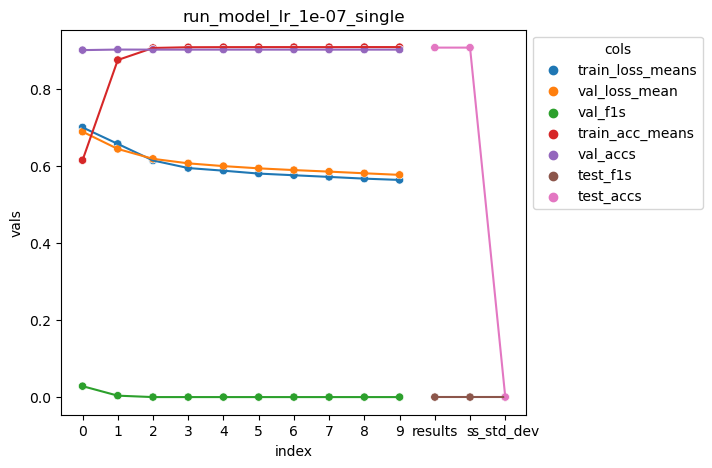

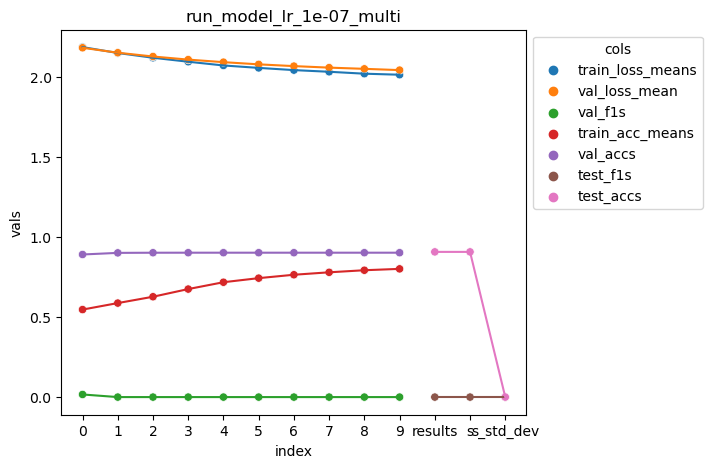

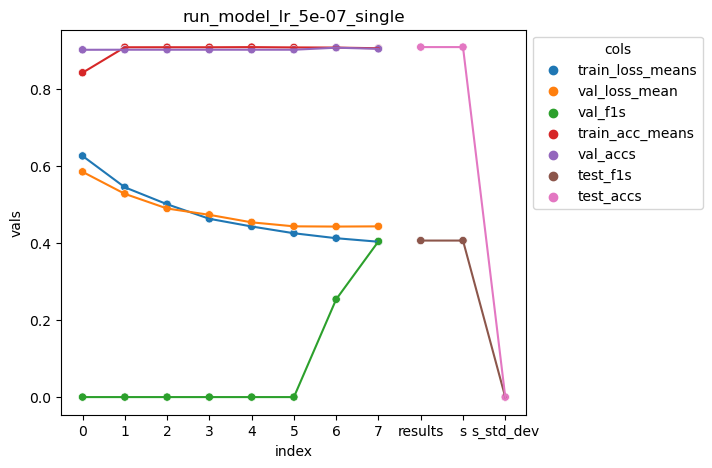

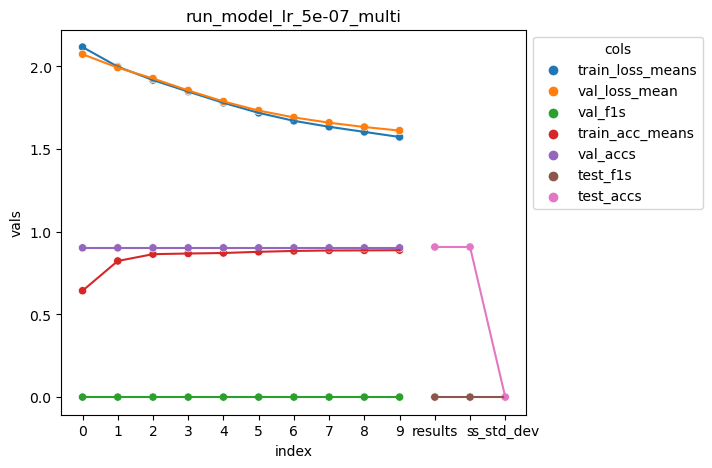

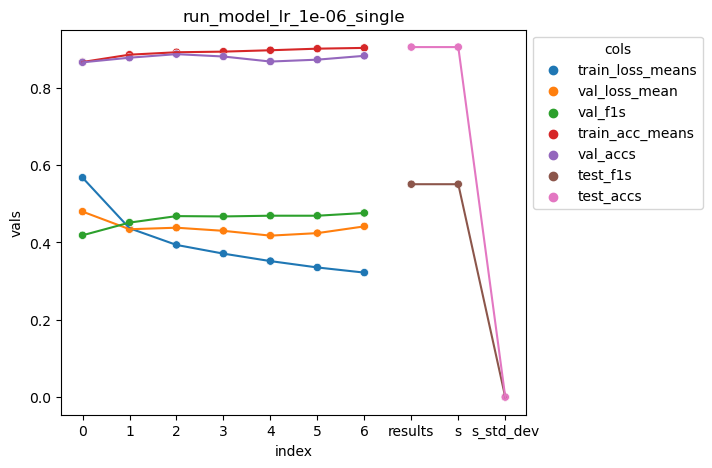

...

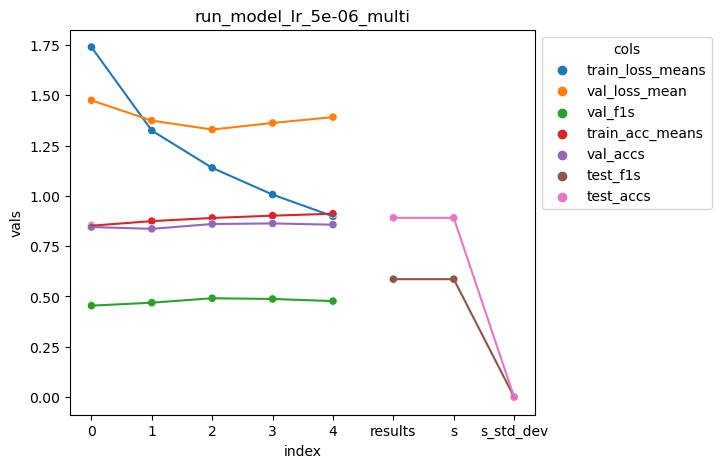

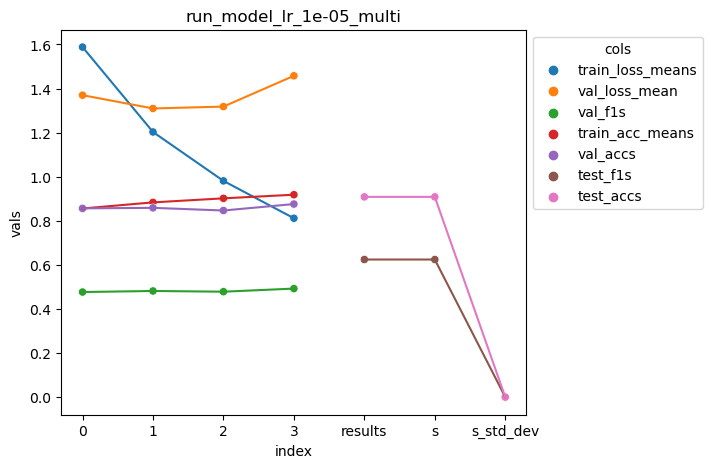

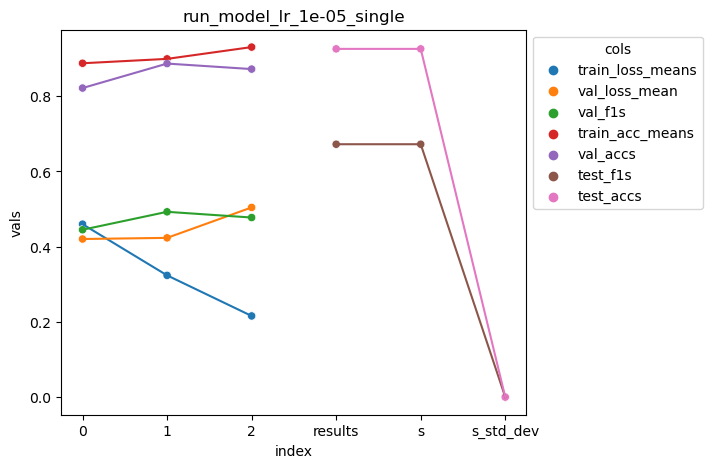

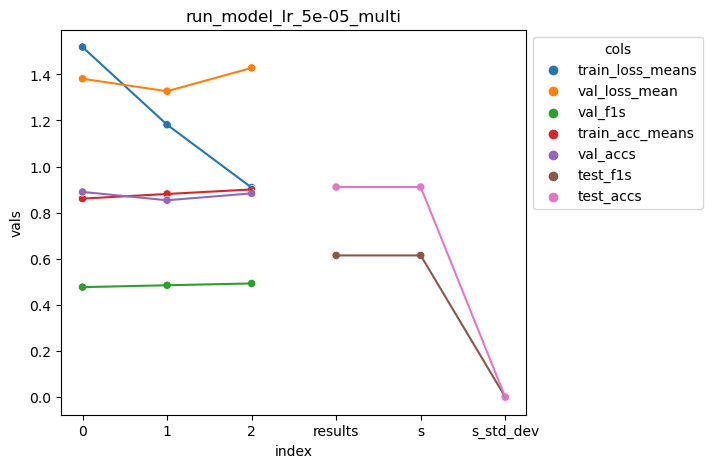

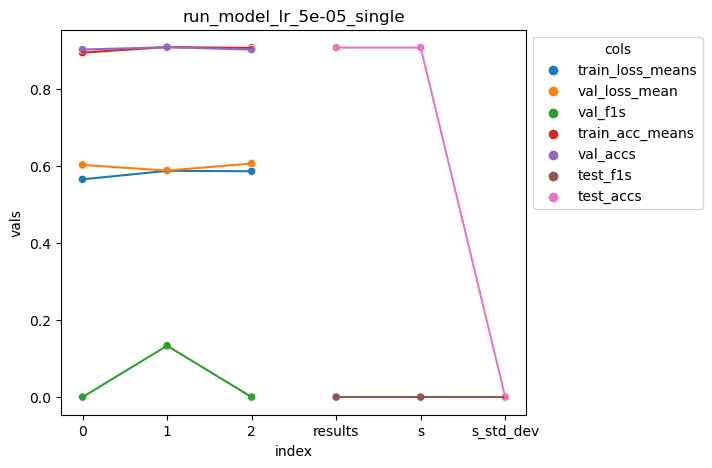

In [17]:
for k, v in lr_results.items():
    # print('_'*20, k ,'_'*20)
    df_to_plot = v.reset_index().melt('index', var_name='cols', value_name='vals')
    df_to_plot['index'] = df_to_plot['index'].str[11:]
    fig, ax = plt.subplots(figsize=(6,5))
    sns.scatterplot(x="index", y="vals", hue='cols', data=df_to_plot, ax=ax).set(title=k)
    sns.lineplot(x="index", y="vals", hue='cols', data=df_to_plot, ax=ax, legend=False)
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

    

In [ ]:
for k, v in lr_results.items():
    print(f"\n__________{k}__________\n")
    display(v.style.background_gradient(cmap ='YlGn', subset=['test_f1'], low=0, high=0.6).format(precision=3))


__________multilr_1e-08__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,2.210,2.206,2.206,0.524,0.638,0.161
Fold0_epoch1,2.206,2.202,2.201,0.527,0.702,0.148
Fold0_epoch2,2.202,2.197,2.198,0.534,0.758,0.144
Fold0_epoch3,2.199,2.194,2.194,0.539,0.794,0.143
Fold0_epoch4,2.193,2.191,2.191,0.541,0.820,0.127
Fold0_epoch5,2.191,2.189,2.188,0.544,0.837,0.110
Fold0_epoch6,2.186,2.186,2.186,0.548,0.848,0.103
Fold0_epoch7,2.187,2.184,2.184,0.550,0.858,0.086
Fold0_epoch8,2.184,2.182,2.182,0.553,0.863,0.071
Fold0_epoch9,2.183,2.180,2.181,0.553,0.870,0.072



__________multilr_5e-08__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,2.199,2.187,2.187,0.534,0.845,0.108
Fold0_epoch1,2.179,2.168,2.168,0.556,0.894,0.033
Fold0_epoch2,2.161,2.153,2.153,0.578,0.904,0.008
Fold0_epoch3,2.148,2.139,2.140,0.590,0.906,0.000
Fold0_epoch4,2.132,2.128,2.128,0.606,0.907,0.000
Fold0_epoch5,2.122,2.119,2.118,0.622,0.907,0.000
Fold0_epoch6,2.111,2.110,2.110,0.637,0.907,0.000
Fold0_epoch7,2.105,2.102,2.102,0.655,0.907,0.000
Fold0_epoch8,2.097,2.096,2.096,0.669,0.907,0.000
Fold0_epoch9,2.092,2.090,2.090,0.683,0.907,0.000



__________multilr_1e-07__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,2.188,2.166,2.166,0.547,0.895,0.033
Fold0_epoch1,2.150,2.133,2.133,0.587,0.906,0.000
Fold0_epoch2,2.119,2.107,2.107,0.627,0.907,0.000
Fold0_epoch3,2.096,2.085,2.085,0.674,0.907,0.000
Fold0_epoch4,2.073,2.068,2.068,0.717,0.907,0.000
Fold0_epoch5,2.058,2.054,2.053,0.745,0.907,0.000
Fold0_epoch6,2.042,2.041,2.041,0.765,0.907,0.000
Fold0_epoch7,2.032,2.030,2.030,0.780,0.907,0.000
Fold0_epoch8,2.022,2.021,2.021,0.792,0.907,0.000
Fold0_epoch9,2.014,2.013,2.013,0.800,0.907,0.000



__________multilr_5e-07__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,2.116,2.045,2.045,0.643,0.907,0.000
Fold0_epoch1,1.997,1.957,1.957,0.822,0.907,0.000
Fold0_epoch2,1.919,1.889,1.889,0.865,0.907,0.000
Fold0_epoch3,1.854,1.818,1.819,0.868,0.907,0.000
Fold0_epoch4,1.790,1.755,1.754,0.872,0.907,0.000
Fold0_epoch5,1.729,1.698,1.697,0.877,0.907,0.000
Fold0_epoch6,1.677,1.652,1.652,0.883,0.907,0.000
Fold0_epoch7,1.641,1.617,1.618,0.886,0.907,0.000
Fold0_epoch8,1.605,1.589,1.589,0.887,0.907,0.000
Fold0_epoch9,1.580,1.565,1.566,0.888,0.907,0.000



__________multilr_1e-06__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,2.053,1.945,1.945,0.733,0.907,0.000
Fold0_epoch1,1.861,1.757,1.757,0.868,0.907,0.000
Fold0_epoch2,1.693,1.614,1.614,0.882,0.907,0.000
Fold0_epoch3,1.579,1.527,1.527,0.886,0.908,0.008
Fold0_epoch4,1.502,1.465,1.465,0.887,0.887,0.469
Fold0_epoch5,1.441,1.409,1.409,0.886,0.882,0.475
Fold0_epoch6,1.389,1.368,1.368,0.884,0.883,0.489
Fold0_epoch7,1.348,1.340,1.341,0.882,0.859,0.488
Fold0_epoch8,1.310,1.305,1.304,0.879,0.867,0.502
Fold0_epoch9,1.281,1.280,1.281,0.877,0.873,0.516



__________multilr_5e-06__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,1.739,1.410,1.410,0.851,0.847,0.463
Fold0_epoch1,1.323,1.203,1.203,0.873,0.909,0.556
Fold0_epoch2,1.146,1.111,1.111,0.889,0.910,0.596
Fold0_epoch3,1.006,1.040,1.040,0.901,0.893,0.585
Fold0_epoch4,0.904,1.035,1.035,0.910,0.870,0.553
Fold0_epoch5,0.821,0.976,0.975,0.918,0.898,0.603
Fold0_epoch6,0.759,0.951,0.951,0.924,0.910,0.626
Fold0_epoch7,0.706,0.949,0.949,0.930,0.899,0.604
Fold0_epoch8,0.668,0.944,0.944,0.933,0.896,0.601
Fold0_epoch9,0.634,0.935,0.936,0.938,0.905,0.618



__________multilr_1e-05__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,1.588,1.285,1.285,0.856,0.863,0.496
Fold0_epoch1,1.204,1.091,1.091,0.881,0.907,0.594
Fold0_epoch2,0.990,1.012,1.012,0.901,0.915,0.615
Fold0_epoch3,0.809,0.951,0.952,0.918,0.885,0.582
Fold0_epoch4,0.689,0.913,0.913,0.929,0.903,0.617
Fold0_epoch5,0.595,0.926,0.925,0.939,0.918,0.646
Fold0_epoch6,0.521,0.919,0.919,0.948,0.915,0.635
Fold0_epoch7,0.461,0.925,0.925,0.954,0.919,0.646
Fold0_epoch8,0.407,0.931,0.932,0.960,0.917,0.642
Fold0_epoch9,0.365,0.958,0.960,0.965,0.922,0.649



__________multilr_5e-05__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,1.518,1.279,1.280,0.861,0.903,0.529
Fold0_epoch1,1.177,1.056,1.056,0.882,0.921,0.598
Fold0_epoch2,0.904,0.980,0.980,0.903,0.907,0.599
Fold0_epoch3,0.685,0.938,0.939,0.925,0.911,0.609
Fold0_epoch4,0.528,0.976,0.974,0.942,0.918,0.635
Fold0_epoch5,0.413,0.979,0.977,0.956,0.927,0.646
Fold0_epoch6,0.314,1.018,1.018,0.967,0.928,0.633
Fold0_epoch7,0.253,1.057,1.058,0.974,0.929,0.639
Fold0_epoch8,0.188,1.106,1.107,0.981,0.939,0.669
Fold0_epoch9,0.134,1.192,1.197,0.987,0.939,0.662



__________multilr_0.0001__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,1.888,1.902,1.902,0.867,0.907,0.000
Fold0_epoch1,1.875,1.907,1.907,0.870,0.907,0.000
Fold0_epoch2,1.872,1.885,1.885,0.869,0.907,0.000
Fold0_epoch3,1.864,1.913,1.914,0.871,0.907,0.000
Fold0_epoch4,1.864,1.902,1.902,0.870,0.907,0.000
Fold0_epoch5,1.861,1.910,1.909,0.871,0.907,0.000
Fold0_epoch6,1.858,1.914,1.913,0.870,0.907,0.000
Fold0_epoch7,1.855,1.930,1.930,0.870,0.907,0.000
Fold0_epoch8,1.857,1.906,1.906,0.870,0.907,0.000
Fold0_epoch9,1.854,1.906,1.906,0.871,0.907,0.000



__________multilr_0.0005__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,1.993,1.955,1.955,0.850,0.907,0.000
Fold0_epoch1,1.966,1.915,1.915,0.854,0.907,0.000
Fold0_epoch2,1.956,1.969,1.969,0.856,0.907,0.000
Fold0_epoch3,1.943,2.027,2.027,0.860,0.907,0.000
Fold0_epoch4,1.941,1.943,1.943,0.860,0.907,0.000
Fold0_epoch5,1.929,1.915,1.914,0.862,0.907,0.000
Fold0_epoch6,1.914,1.938,1.938,0.866,0.907,0.000
Fold0_epoch7,1.892,1.902,1.902,0.868,0.907,0.000
Fold0_epoch8,1.876,1.877,1.877,0.870,0.907,0.000
Fold0_epoch9,1.869,1.874,1.874,0.868,0.907,0.000



__________multilr_0.001__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,2.116,1.989,1.989,0.821,0.907,0.000
Fold0_epoch1,2.093,1.942,1.942,0.828,0.907,0.000
Fold0_epoch2,2.072,2.058,2.058,0.830,0.907,0.000
Fold0_epoch3,2.027,2.158,2.159,0.838,0.907,0.000
Fold0_epoch4,2.033,2.009,2.009,0.839,0.907,0.000
Fold0_epoch5,2.005,1.937,1.936,0.844,0.907,0.000
Fold0_epoch6,1.996,1.994,1.993,0.847,0.907,0.000
Fold0_epoch7,1.988,2.019,2.020,0.847,0.907,0.000
Fold0_epoch8,1.969,1.985,1.985,0.852,0.907,0.000
Fold0_epoch9,1.957,1.954,1.954,0.857,0.907,0.000



__________multilr_0.005__________



,train_loss_mean,val_loss_mean,test_loss_mean,train_acc_mean,test_acc,test_f1
Fold0_epoch0,3.521,3.528,3.529,0.736,0.907,0.000
Fold0_epoch1,3.348,2.733,2.733,0.740,0.907,0.000
Fold0_epoch2,3.162,3.656,3.656,0.743,0.907,0.000
Fold0_epoch3,3.030,3.070,3.071,0.745,0.907,0.000
Fold0_epoch4,2.955,3.106,3.106,0.748,0.907,0.000
Fold0_epoch5,2.812,2.405,2.405,0.752,0.907,0.000
Fold0_epoch6,2.775,2.645,2.644,0.755,0.907,0.000
Fold0_epoch7,2.617,2.355,2.356,0.767,0.907,0.000
Fold0_epoch8,2.574,2.212,2.212,0.766,0.907,0.000
Fold0_epoch9,2.452,2.328,2.329,0.776,0.907,0.000


# lr search MD multi tasking

In [57]:
path_to_lr_search = '../results/MD_multi-tasking_lr_search/'

In [58]:
lr_search_runs = sorted(os.listdir(path_to_lr_search), key= lambda run: float(re.findall(r'[0-9]*e-[0-9]*' ,run)[0]))
lr_search_runs

['MD-multi-tasking_lr1e-07',
 'MD-multi-tasking_lr5e-07',
 'MD-multi-tasking_lr1e-06',
 'MD-multi-tasking_lr5e-06',
 'MD-multi-tasking_lr1e-05',
 'MD-multi-tasking_lr2e-05',
 'MD-multi-tasking_lr3e-05',
 'MD-multi-tasking_lr4e-05',
 'MD-multi-tasking_lr5e-05',
 'MD-multi-tasking_lr1e-04',
 'MD-multi-tasking_lr5e-04']

In [59]:
path_to_res = path_to_lr_search +'MD-multi-tasking_lr1e-07/' + 'model_results.json'

In [60]:
lr_results = dict()

for m_dir in sorted(os.listdir(path_to_lr_search), key= lambda run: float(re.findall(r'[0-9]*e-[0-9]*' ,run)[0])):
    print(m_dir)
    load_and_display_res_df_color(path_to_lr_search, m_dir, filter_cols=['loss','majority_binary', 'individual_macro'])
    lr_results[m_dir] = return_results_df(path_to_lr_search,m_dir)

MD-multi-tasking_lr1e-07


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.628,3.587,0.467,nan,nan
Epoch1,3.616,3.580,0.468,nan,nan
Epoch2,3.612,3.578,0.471,nan,nan
Epoch3,3.599,3.579,0.471,nan,nan
Epoch4,3.596,3.569,0.472,nan,nan
Epoch5,3.592,3.568,0.472,nan,nan
Epoch6,3.591,3.563,0.472,nan,nan
Epoch7,3.585,3.558,0.473,nan,nan
Epoch8,3.580,3.553,0.473,nan,nan
Epoch9,3.576,3.552,0.474,nan,nan


MD-multi-tasking_lr5e-07


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.615,3.560,0.472,nan,nan
Epoch1,3.573,3.526,0.482,nan,nan
Epoch2,3.540,3.497,0.503,nan,nan
Epoch3,3.505,3.481,0.510,nan,nan
Epoch4,3.486,3.461,0.518,nan,nan
Epoch5,3.474,3.456,0.523,nan,nan
Epoch6,3.465,3.447,0.531,nan,nan
Epoch7,3.459,3.443,0.535,nan,nan
Epoch8,3.453,3.437,0.536,nan,nan
Epoch9,3.448,3.433,0.539,nan,nan


MD-multi-tasking_lr1e-06


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.598,3.522,0.486,nan,nan
Epoch1,3.517,3.465,0.514,nan,nan
Epoch2,3.475,3.442,0.534,nan,nan
Epoch3,3.453,3.439,0.544,nan,nan
Epoch4,3.440,3.427,0.546,nan,nan
Epoch5,3.428,3.422,0.554,nan,nan
Epoch6,3.418,3.412,0.562,nan,nan
Epoch7,3.408,3.407,0.568,nan,nan
Epoch8,3.396,3.398,0.567,nan,nan
Epoch9,3.385,3.390,0.570,nan,nan


MD-multi-tasking_lr5e-06


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.517,3.428,0.546,nan,nan
Epoch1,3.411,3.372,0.597,nan,nan
Epoch2,3.298,3.225,0.644,nan,nan
Epoch3,3.080,3.109,0.679,nan,nan
Epoch4,2.883,3.039,0.670,nan,nan
Epoch5,2.727,2.925,0.698,nan,nan
Epoch6,2.610,2.913,0.698,nan,nan
Epoch7,2.516,2.906,0.701,nan,nan
Epoch8,2.437,2.850,0.705,nan,nan
Epoch9,2.369,2.836,0.710,nan,nan


MD-multi-tasking_lr1e-05


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.506,3.423,0.577,nan,nan
Epoch1,3.350,3.235,0.661,nan,nan
Epoch2,3.059,2.976,0.693,nan,nan
Epoch3,2.760,2.863,0.719,nan,nan
Epoch4,2.526,2.826,0.719,nan,nan
Epoch5,2.358,2.733,0.731,nan,nan
Epoch6,2.220,2.742,0.725,nan,nan
Epoch7,2.121,2.727,0.732,nan,nan
Epoch8,2.028,2.694,0.738,nan,nan
Epoch9,1.956,2.697,0.736,nan,nan


MD-multi-tasking_lr2e-05


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.448,3.256,0.651,nan,nan
Epoch1,3.003,2.845,0.715,nan,nan
Epoch2,2.540,2.727,0.731,nan,nan
Epoch3,2.241,2.664,0.742,nan,nan
Epoch4,2.021,2.668,0.741,nan,nan
Epoch5,1.848,2.673,0.740,nan,nan
Test_results,nan,nan,nan,0.662,0.744
epoch_mean,2.517,2.805,0.720,nan,nan
test_mean,nan,nan,nan,0.662,0.744
test_results_std_dev,nan,nan,nan,0.000,0.000


MD-multi-tasking_lr3e-05


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.436,3.156,0.677,nan,nan
Epoch1,2.905,2.828,0.715,nan,nan
Epoch2,2.462,2.674,0.735,nan,nan
Epoch3,2.152,2.625,0.744,nan,nan
Epoch4,1.917,2.701,0.741,nan,nan
Test_results,nan,nan,nan,0.665,0.751
epoch_mean,2.574,2.797,0.723,nan,nan
test_mean,nan,nan,nan,0.665,0.751
test_results_std_dev,nan,nan,nan,0.000,0.000


MD-multi-tasking_lr4e-05


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.455,3.421,0.591,nan,nan
Epoch1,3.402,3.374,0.604,nan,nan
Epoch2,3.338,3.392,0.606,nan,nan
Epoch3,3.309,3.420,0.614,nan,nan
Test_results,nan,nan,nan,0.000,0.621
epoch_mean,3.376,3.402,0.604,nan,nan
test_mean,nan,nan,nan,0.000,0.621
test_results_std_dev,nan,nan,nan,0.000,0.000


MD-multi-tasking_lr5e-05


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.401,3.248,0.627,nan,nan
Epoch1,2.958,2.856,0.713,nan,nan
Epoch2,2.529,2.732,0.726,nan,nan
Epoch3,2.201,2.709,0.735,nan,nan
Epoch4,1.963,2.835,0.732,nan,nan
Test_results,nan,nan,nan,0.629,0.743
epoch_mean,2.610,2.876,0.706,nan,nan
test_mean,nan,nan,nan,0.629,0.743
test_results_std_dev,nan,nan,nan,0.000,0.000


MD-multi-tasking_lr1e-04


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.442,3.327,0.628,nan,nan
Epoch1,3.335,3.388,0.593,nan,nan
Epoch2,3.322,3.398,0.594,nan,nan
Test_results,nan,nan,nan,0.000,0.607
epoch_mean,3.366,3.371,0.605,nan,nan
test_mean,nan,nan,nan,0.000,0.607
test_results_std_dev,nan,nan,nan,0.000,0.000


MD-multi-tasking_lr5e-04


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,3.776,3.847,0.603,nan,nan
Epoch1,3.693,3.729,0.594,nan,nan
Epoch2,3.483,3.480,0.563,nan,nan
Epoch3,3.365,3.464,0.581,nan,nan
Epoch4,3.324,3.498,0.602,nan,nan
Test_results,nan,nan,nan,0.000,0.609
epoch_mean,3.528,3.604,0.588,nan,nan
test_mean,nan,nan,nan,0.000,0.609
test_results_std_dev,nan,nan,nan,0.000,0.000


# lr search MD uid

In [61]:
path_to_lr_search = '../results/MD_uid_lr_search/'

In [62]:
lr_search_runs = sorted(os.listdir(path_to_lr_search), key= lambda run: float(re.findall(r'[0-9]*e-[0-9]*' ,run)[0]))
lr_search_runs

['MD_682_annos_1e-06_lr',
 'MD_682_annos_5e-06_lr',
 'MD_682_annos_1e-05_lr',
 'MD_682_annos_5e-05_lr',
 'MD_682_annos_6e-05_lr',
 'MD_682_annos_7e-05_lr',
 'MD_682_annos_8e-05_lr',
 'MD_682_annos_9e-05_lr',
 'MD_682_annos_1e-04_lr',
 'MD_682_annos_5e-04_lr',
 'MD_682_annos_1e-03_lr',
 'MD_682_annos_5e-03_lr']

In [63]:
path_to_res = path_to_lr_search +'MD-multi-tasking_lr1e-07/' + 'model_results.json'

In [64]:
lr_results = dict()

for m_dir in sorted(os.listdir(path_to_lr_search), key= lambda run: float(re.findall(r'[0-9]*e-[0-9]*' ,run)[0])):
    print(m_dir)
    load_and_display_res_df_color(path_to_lr_search, m_dir, filter_cols=['loss','majority_binary', 'individual_macro'])
    lr_results[m_dir] = return_results_df(path_to_lr_search,m_dir)

MD_682_annos_1e-06_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.636,0.627,0.462,nan,nan
Epoch1,0.626,0.618,0.536,nan,nan
Epoch2,0.617,0.611,0.553,nan,nan
Epoch3,0.611,0.607,0.571,nan,nan
Epoch4,0.607,0.606,0.585,nan,nan
Test_results,nan,nan,nan,0.410,0.585
epoch_mean,0.619,0.614,0.542,nan,nan
test_mean,nan,nan,nan,0.410,0.585
test_results_std_dev,nan,nan,nan,0.000,0.000


MD_682_annos_5e-06_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.620,0.594,0.600,nan,nan
Epoch1,0.565,0.581,0.643,nan,nan
Epoch2,0.515,0.555,0.683,nan,nan
Epoch3,0.481,0.555,0.680,nan,nan
Epoch4,0.465,0.557,0.683,nan,nan
Test_results,nan,nan,nan,0.532,0.683
epoch_mean,0.529,0.568,0.658,nan,nan
test_mean,nan,nan,nan,0.532,0.683
test_results_std_dev,nan,nan,nan,0.000,0.000


MD_682_annos_1e-05_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.606,0.564,0.653,nan,nan
Epoch1,0.513,0.565,0.667,nan,nan
Epoch2,0.449,0.580,0.690,nan,nan
Epoch3,0.406,0.574,0.693,nan,nan
Epoch4,0.381,0.578,0.697,nan,nan
Test_results,nan,nan,nan,0.532,0.690
epoch_mean,0.471,0.572,0.680,nan,nan
test_mean,nan,nan,nan,0.532,0.690
test_results_std_dev,nan,nan,nan,0.000,0.000


MD_682_annos_5e-05_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.602,0.530,0.696,nan,nan
Epoch1,0.481,0.565,0.704,nan,nan
Epoch2,0.395,0.550,0.733,nan,nan
Epoch3,0.331,0.579,0.741,nan,nan
Epoch4,0.278,0.564,0.735,nan,nan
Epoch5,0.237,0.637,0.731,nan,nan
Epoch6,0.194,0.785,0.737,nan,nan
Epoch7,0.164,0.846,0.731,nan,nan
Epoch8,0.139,0.983,0.728,nan,nan
Epoch9,0.119,1.009,0.729,nan,nan


MD_682_annos_6e-05_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.617,0.570,0.611,nan,nan
Epoch1,0.499,0.532,0.712,nan,nan
Epoch2,0.407,0.516,0.736,nan,nan
Epoch3,0.346,0.533,0.739,nan,nan
Epoch4,0.294,0.543,0.737,nan,nan
Epoch5,0.252,0.597,0.724,nan,nan
Epoch6,0.210,0.689,0.735,nan,nan
Epoch7,0.171,0.763,0.736,nan,nan
Epoch8,0.146,0.857,0.738,nan,nan
Epoch9,0.128,0.923,0.737,nan,nan


MD_682_annos_7e-05_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.587,0.521,0.694,nan,nan
Epoch1,0.471,0.530,0.707,nan,nan
Epoch2,0.394,0.511,0.740,nan,nan
Epoch3,0.335,0.504,0.744,nan,nan
Epoch4,0.282,0.538,0.737,nan,nan
Epoch5,0.241,0.628,0.737,nan,nan
Epoch6,0.200,0.721,0.742,nan,nan
Epoch7,0.162,0.719,0.741,nan,nan
Epoch8,0.132,0.874,0.733,nan,nan
Epoch9,0.112,0.896,0.735,nan,nan


MD_682_annos_8e-05_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.629,0.616,0.593,nan,nan
Epoch1,0.586,0.603,0.617,nan,nan
Epoch2,0.512,0.544,0.710,nan,nan
Epoch3,0.428,0.520,0.728,nan,nan
Epoch4,0.371,0.509,0.735,nan,nan
Epoch5,0.335,0.547,0.735,nan,nan
Epoch6,0.302,0.541,0.735,nan,nan
Epoch7,0.268,0.551,0.733,nan,nan
Epoch8,0.241,0.662,0.732,nan,nan
Epoch9,0.220,0.673,0.734,nan,nan


MD_682_annos_9e-05_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.635,0.636,0.401,nan,nan
Epoch1,0.624,0.627,0.483,nan,nan
Epoch2,0.625,0.627,0.460,nan,nan
Epoch3,0.627,0.624,0.598,nan,nan
Epoch4,0.608,0.594,0.623,nan,nan
Epoch5,0.536,0.537,0.687,nan,nan
Epoch6,0.464,0.539,0.719,nan,nan
Epoch7,0.411,0.516,0.722,nan,nan
Epoch8,0.374,0.543,0.726,nan,nan
Epoch9,0.348,0.550,0.730,nan,nan


MD_682_annos_1e-04_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.625,0.624,0.496,nan,nan
Epoch1,0.627,0.627,0.461,nan,nan
Epoch2,0.628,0.639,0.461,nan,nan
Epoch3,0.627,0.637,0.461,nan,nan
Epoch4,0.627,0.637,0.461,nan,nan
Epoch5,0.627,0.636,0.461,nan,nan
Epoch6,0.627,0.630,0.461,nan,nan
Epoch7,0.626,0.634,0.461,nan,nan
Epoch8,0.628,0.629,0.461,nan,nan
Epoch9,0.626,0.633,0.461,nan,nan


MD_682_annos_5e-04_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.644,0.638,0.401,nan,nan
Epoch1,0.642,0.639,0.401,nan,nan
Epoch2,0.642,0.638,0.401,nan,nan
Epoch3,0.642,0.638,0.401,nan,nan
Epoch4,0.642,0.638,0.401,nan,nan
Test_results,nan,nan,nan,0.000,0.401
epoch_mean,0.642,0.638,0.401,nan,nan
test_mean,nan,nan,nan,0.000,0.401
test_results_std_dev,nan,nan,nan,0.000,0.000


MD_682_annos_1e-03_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.644,0.638,0.401,nan,nan
Epoch1,0.642,0.639,0.401,nan,nan
Epoch2,0.642,0.638,0.401,nan,nan
Epoch3,0.642,0.638,0.401,nan,nan
Epoch4,0.642,0.638,0.401,nan,nan
Test_results,nan,nan,nan,0.000,0.401
epoch_mean,0.642,0.638,0.401,nan,nan
test_mean,nan,nan,nan,0.000,0.401
test_results_std_dev,nan,nan,nan,0.000,0.000


MD_682_annos_5e-03_lr


,train_loss_means,val_loss_mean,val_f1_individual_macro,test_f1_majority_binary,test_f1_individual_macro
Epoch0,0.679,0.638,0.401,nan,nan
Epoch1,0.643,0.639,0.401,nan,nan
Epoch2,0.642,0.638,0.401,nan,nan
Epoch3,0.642,0.638,0.401,nan,nan
Epoch4,0.642,0.638,0.401,nan,nan
Test_results,nan,nan,nan,0.000,0.401
epoch_mean,0.650,0.638,0.401,nan,nan
test_mean,nan,nan,nan,0.000,0.401
test_results_std_dev,nan,nan,nan,0.000,0.000


In [73]:
l = []
l.extend(torch.tensor([1,0, -1]))
l.extend(torch.tensor([-1,1,0]))
l

[tensor(1), tensor(0), tensor(-1), tensor(-1), tensor(1), tensor(0)]

In [86]:
t = torch.tensor([1,0,1])
t = t.reshape(3,1)
print(t)
t.expand(t.shape[0],3)

tensor([[1],
        [0],
        [1]])


tensor([[1, 1, 1],
        [0, 0, 0],
        [1, 1, 1]])

In [70]:
t != -1

tensor([[ True,  True, False],
        [False, False,  True]])

In [72]:
labeled_filter = (t != -1)
all_bin_preds_tensor_1d = t[labeled_filter]
all_bin_preds_tensor_1d

tensor([1, 0, 0])